In [1]:
import os
import re

import altair as alt
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import scanpy as sc
import anndata
import pandas as pd
import numpy as np

In [2]:
plt.rcParams["font.family"] = "Arial"
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

mpl.rcParams['figure.dpi'] = 300

In [3]:
save_dir = '/diskmnt/Projects/Users/estorrs/sc_pdac/results/figures/manuscript'
sc.settings.figdir = save_dir

#### single cell

In [4]:
tumor = sc.read_h5ad('../data/combined/all_initial_malignant.h5ad')
tumor

AnnData object with n_obs × n_vars = 67347 × 30840
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'integrated_snn_res.0.1', 'active.ident'
    var: 'is_highly_variable'
    obsm: 'X_umap'
    layers: 'counts'

In [5]:
immune = sc.read_h5ad('../data/combined/all_initial_immune.h5ad')
immune

AnnData object with n_obs × n_vars = 24390 × 30840
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'integrated_snn_res.1.5', 'active.ident'
    var: 'is_highly_variable'
    obsm: 'X_umap'
    layers: 'counts'

In [6]:
adata = sc.read_h5ad('../data/combined/final_all_relabeled_cells_05242021.h5ad')
adata

AnnData object with n_obs × n_vars = 151336 × 30840
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'active.ident', 'cell_type', 'dataset', 'sample_id', 'cell_type_level_2', 'cell_type_level_3', 'tumor_original_seurat', 'malignant_exclude'
    var: 'is_highly_variable'
    uns: 'cell_type_colors', 'cell_type_level_2_colors', 'cell_type_level_3_colors', 'dataset_colors', 'rank_genes_groups'
    obsm: 'X_umap'
    layers: 'counts'

In [7]:
from collections import Counter
tups = sorted(set([(x, y) for x, y in zip(adata.obs['dataset'], adata.obs['sample_id'])]))
Counter([d for d, _ in tups])

Counter({'chan-seng-yue': 15,
         'inhouse - eus': 22,
         'inhouse - surgical': 6,
         'lin': 10,
         'peng': 24})

In [8]:
mpl.rcParams['figure.figsize'] = (5, 5)

In [9]:
def downsample_adata(a, field, n=10):
    fields = sorted(set(a.obs[field]))
    idxs = []
    for f in fields:
        small = a[a.obs[field]==f]
        idxs += list(np.random.choice(small.obs.index, size=n))
    return a[idxs]

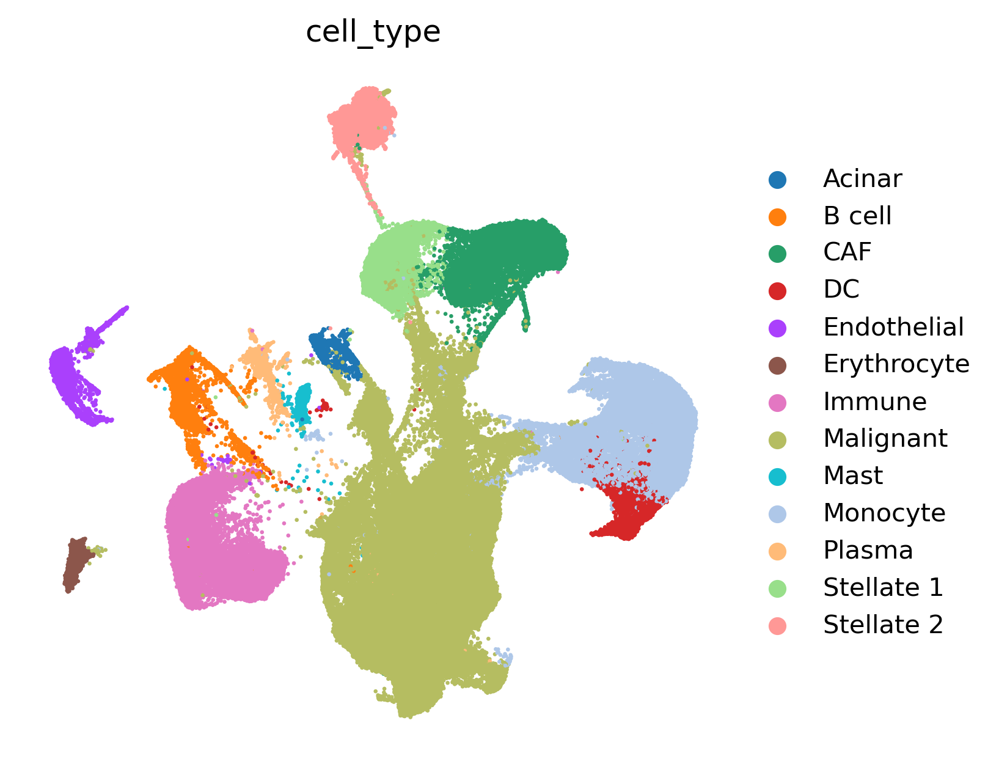

In [39]:
sc.pl.umap(adata, color='cell_type', frameon=False, show=True, size=10, save='_general_cell_types.png')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


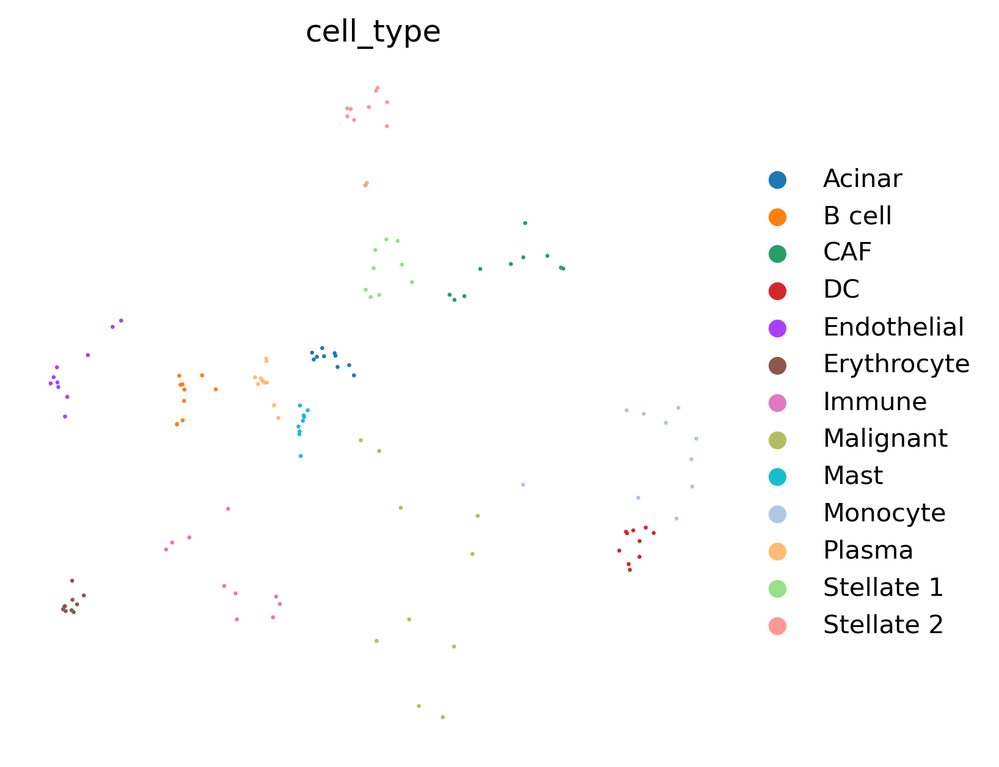

In [43]:
sc.pl.umap(downsample_adata(adata, 'cell_type', n=10),
           color='cell_type', frameon=False, show=True, size=10, save='_general_cell_types.pdf')

In [10]:
# sc.tl.rank_genes_groups(adata, groupby='cell_type_level_3')

In [11]:
# sc.pl.rank_genes_groups(adata, groups=['U1'])

In [44]:
# remove the excluded cell types
adata = adata[~adata.obs['malignant_exclude']]
adata = adata[adata.obs['cell_type_level_3']!='U1']
adata

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 140612 × 30840
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'active.ident', 'cell_type', 'dataset', 'sample_id', 'cell_type_level_2', 'cell_type_level_3', 'tumor_original_seurat', 'malignant_exclude'
    var: 'is_highly_variable'
    uns: 'cell_type_colors', 'cell_type_level_2_colors', 'cell_type_level_3_colors', 'dataset_colors', 'rank_genes_groups'
    obsm: 'X_umap'
    layers: 'counts'

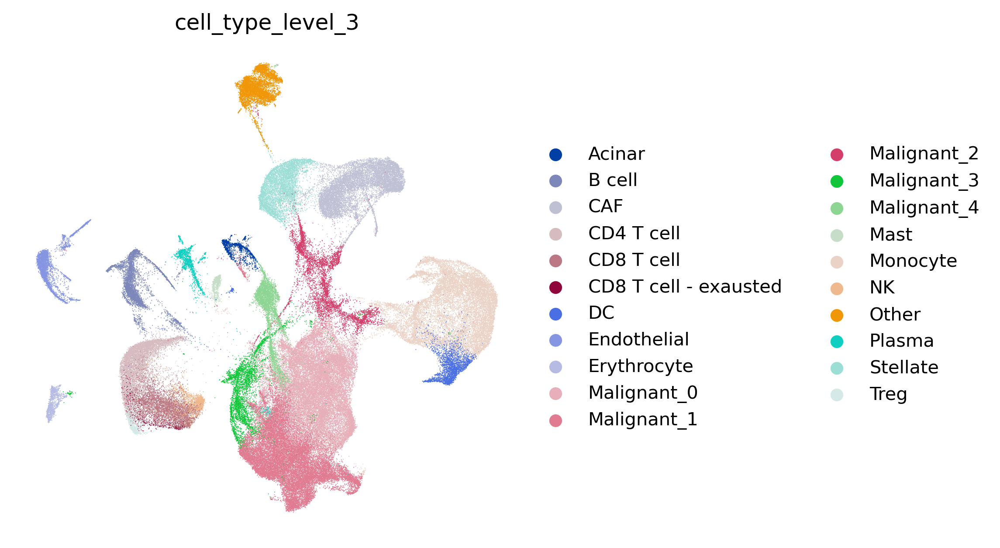

In [45]:
sc.pl.umap(adata, color='cell_type_level_3', frameon=False, )

In [15]:
# renaming Other as stellate 2
# renaming U1 as MT

In [10]:
adata.obs['cell_type'] = ['Stellate 2' if x=='Other' else x for x in adata.obs['cell_type']]
adata.obs['cell_type'] = ['Stellate 1' if x=='Stellate' else x for x in adata.obs['cell_type']]
adata.obs['cell_type'] = ['Immune' if x=='immune' else x for x in adata.obs['cell_type']]
# adata.obs['cell_type_level_3'] = ['MT' if x=='U1' else x for x in adata.obs['cell_type_level_3']]


... storing 'cell_type' as categorical
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


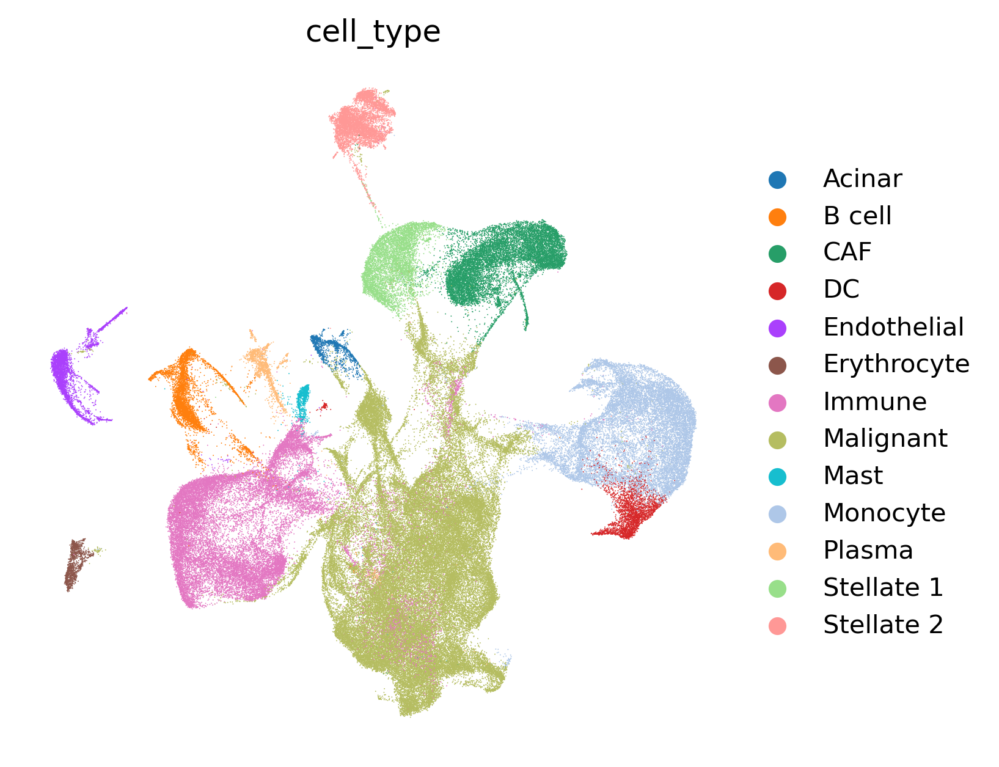

In [11]:
sc.pl.umap(adata, color='cell_type', frameon=False, )

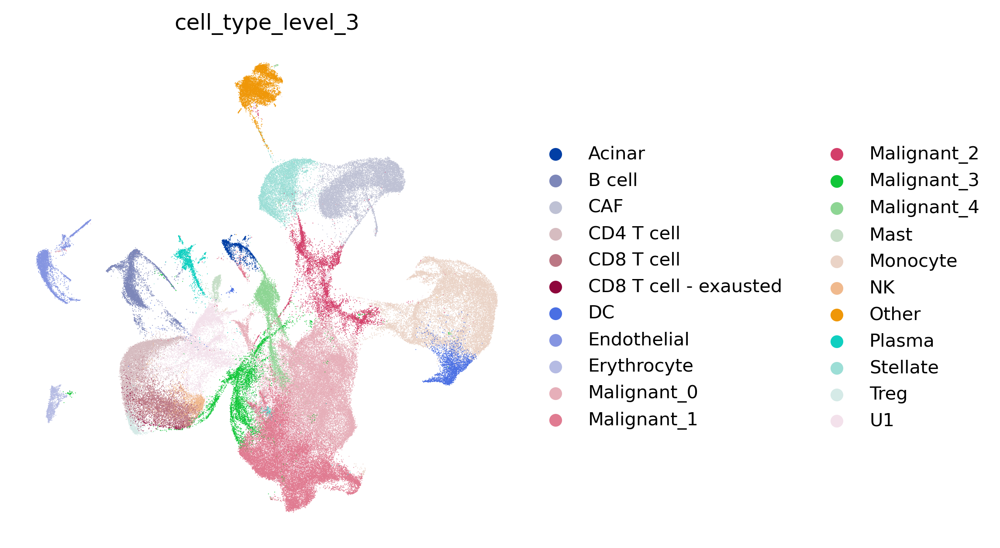

In [12]:
sc.pl.umap(adata, color='cell_type_level_3', frameon=False, )

In [13]:
names = {
    'CD8 T cell - exausted': 'CD4_CD8_T_cell - exhausted',
    'Malignant_0': 'Malignant - Classical Low',
    'Malignant_1': 'Malignant - Classical High',
    'Malignant_2': 'Malignant - Basal',
    'Malignant_3': 'Malignant - Mixed',
    'Malignant_4': 'Malignant - ADEX',
    'Stellate': 'Stellate 1',
    'Other': 'Stellate 2'
}
adata.obs['final_cell_types'] = [names.get(x, x) for x in adata.obs['cell_type_level_3']]

In [51]:
names = {
    'CD8 T cell - exausted': 'CD4/CD8 T cell - exhausted',
    'Malignant_0': 'Malignant - Classical Low',
    'Malignant_1': 'Malignant - Classical High',
    'Malignant_2': 'Malignant - Basal',
    'Malignant_3': 'Malignant - Mixed',
    'Malignant_4': 'Malignant - ADEX',
    'Stellate': 'Stellate 1',
    'Other': 'Stellate 2'
}
adata.obs['final_cell_types'] = [names.get(x, x) for x in adata.obs['cell_type_level_3']]

... storing 'final_cell_types' as categorical


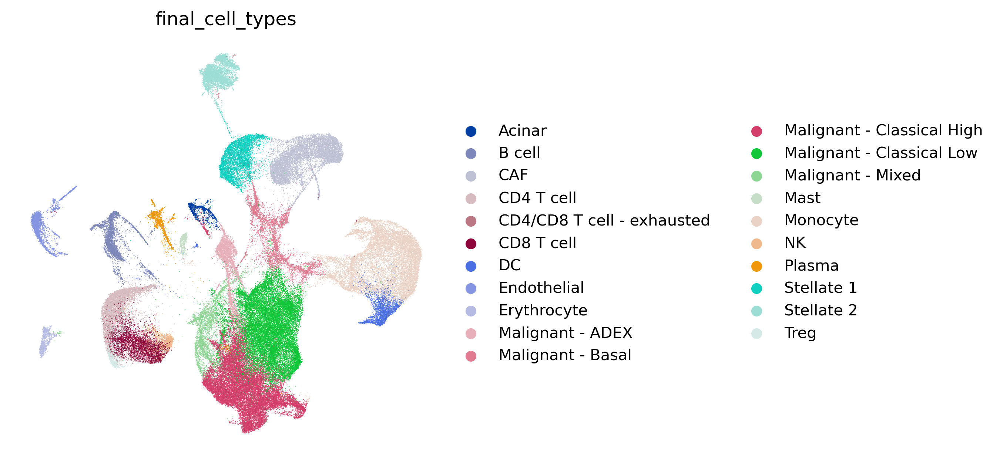

In [52]:
sc.pl.umap(adata, color='final_cell_types', frameon=False, )

In [14]:
## renaming dataset to final names
d = {
    'chan-seng-yue': 'Chan-Seng-Yue',
    'lin': 'Lin',
    'peng': 'Peng',
    'inhouse - eus': 'In-house: EUS-FNB',
    'inhouse - surgical': 'In-house: Surgical'
}
adata.obs['dataset'] = [d[x] for x in adata.obs['dataset']]

In [16]:
adata.write_h5ad('../data/combined/ecotyper_sc_start_08232021.h5ad')

... storing 'dataset' as categorical


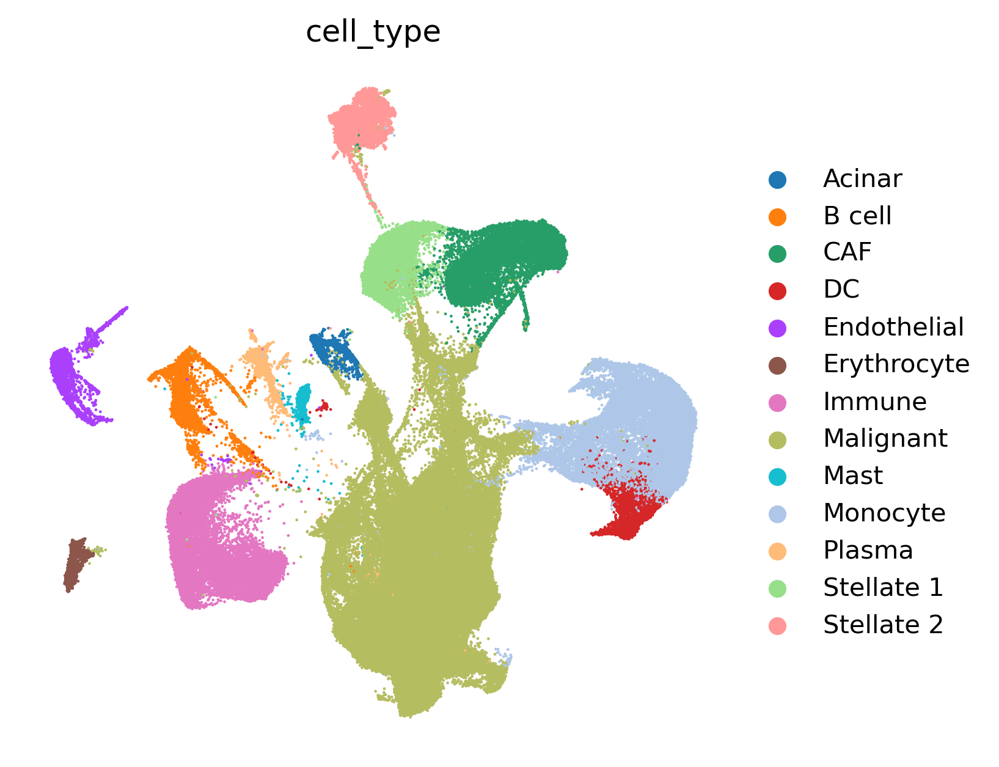

In [54]:
sc.pl.umap(adata, color='cell_type', frameon=False, size=5.)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


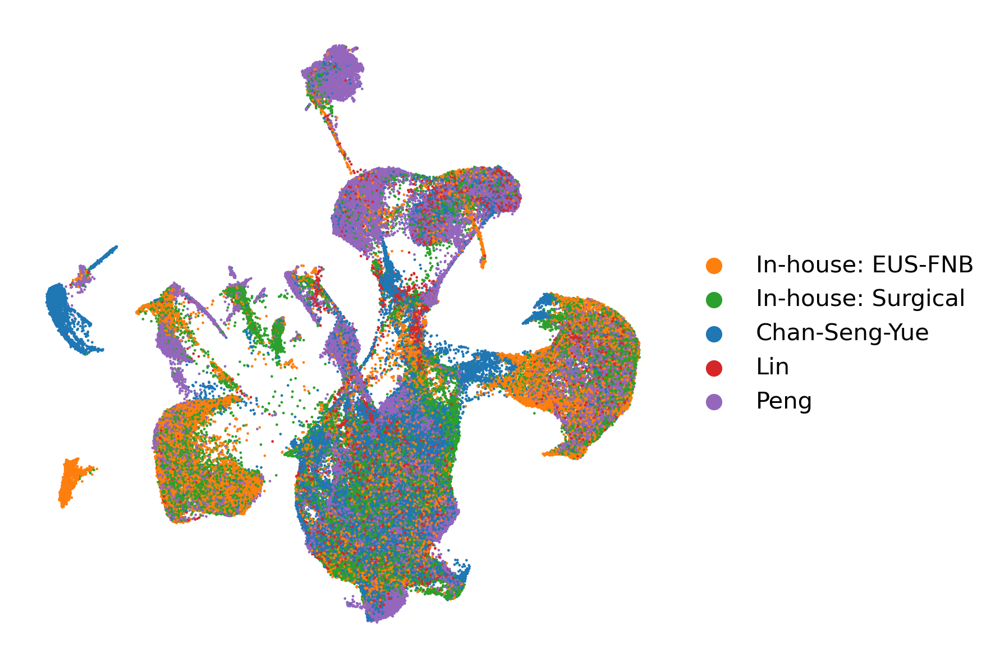

In [56]:
shuffled = adata.obs.index.to_list()
np.random.shuffle(shuffled)
sc.pl.umap(adata[shuffled], color='dataset', frameon=False, size=5., sort_order=False, title='',
           groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_general_by_dataset.png')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


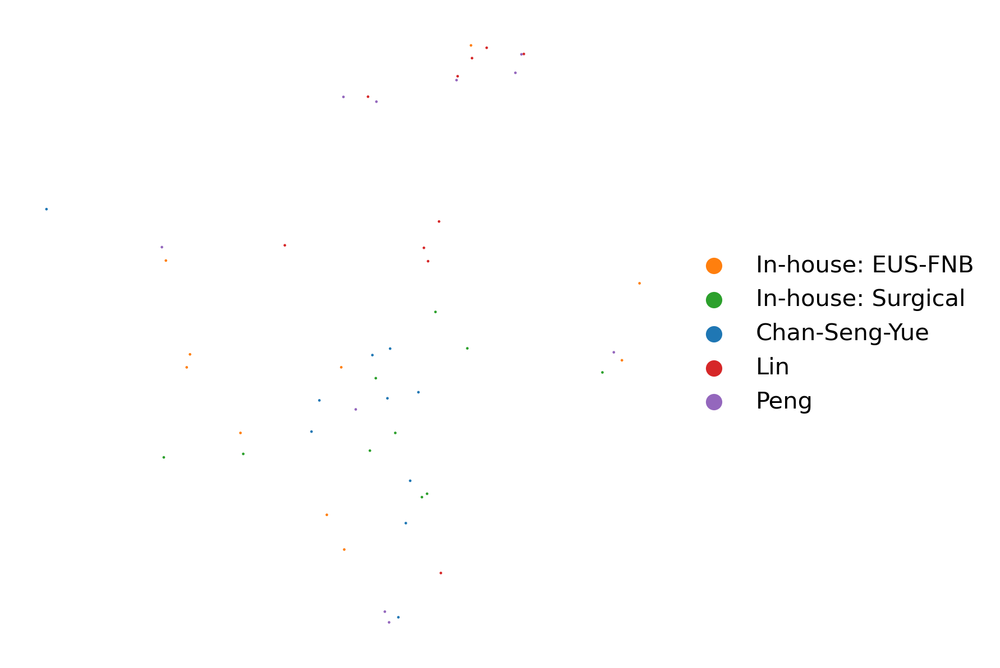

In [57]:
sc.pl.umap(downsample_adata(adata[shuffled], 'dataset'),
           color='dataset', frameon=False, size=5., sort_order=False, title='',
           groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_general_by_dataset.pdf')

In [58]:
tumor = tumor[list(set(tumor.obs.index).intersection(adata.obs.index))]
tumor.obs['cell_type'] = [adata.obs.loc[x, 'final_cell_types'] for x in tumor.obs.index]
tumor.obs['dataset'] = [adata.obs.loc[x, 'dataset'] for x in tumor.obs.index]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.obs` of view, copying.


In [59]:
immune = immune[list(set(immune.obs.index).intersection(adata.obs.index))]
immune.obs['cell_type'] = [adata.obs.loc[x, 'final_cell_types'] for x in immune.obs.index]
immune.obs['dataset'] = [adata.obs.loc[x, 'dataset'] for x in immune.obs.index]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.obs` of view, copying.


... storing 'cell_type' as categorical
... storing 'dataset' as categorical


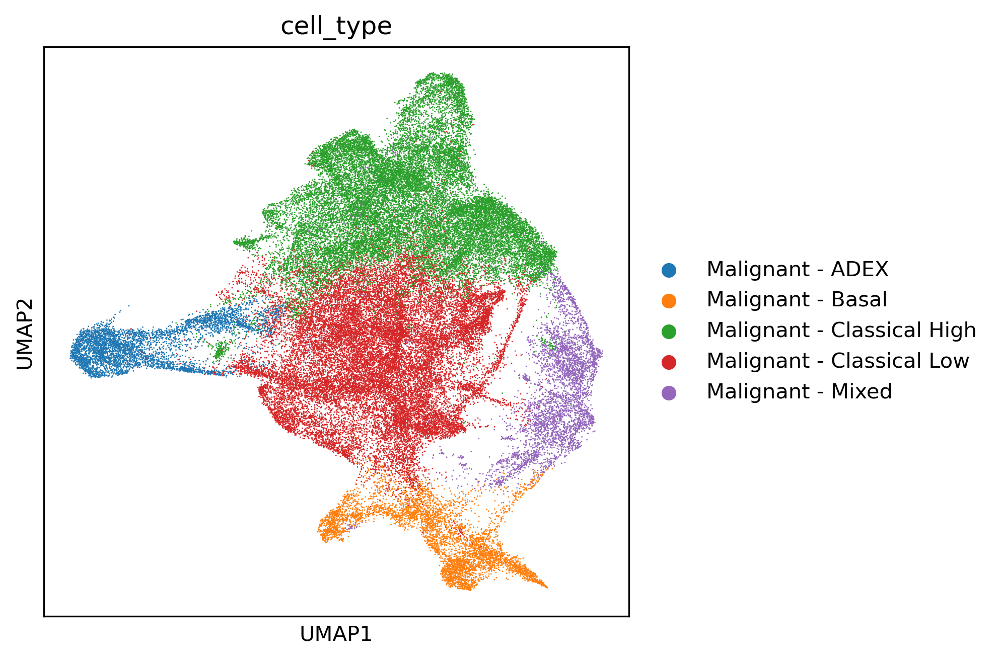

In [60]:
sc.pl.umap(tumor, color='cell_type')

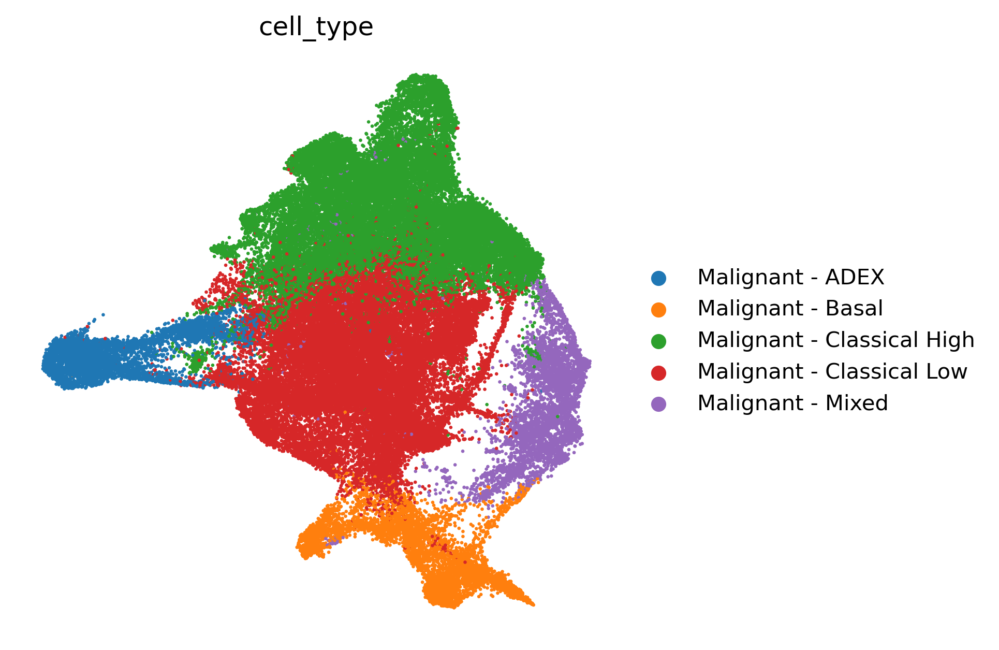

In [127]:
sc.pl.umap(tumor, color='cell_type', size=10., frameon=False, save='_tumor_subtypes.png', palette=sns.color_palette()[:5])

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


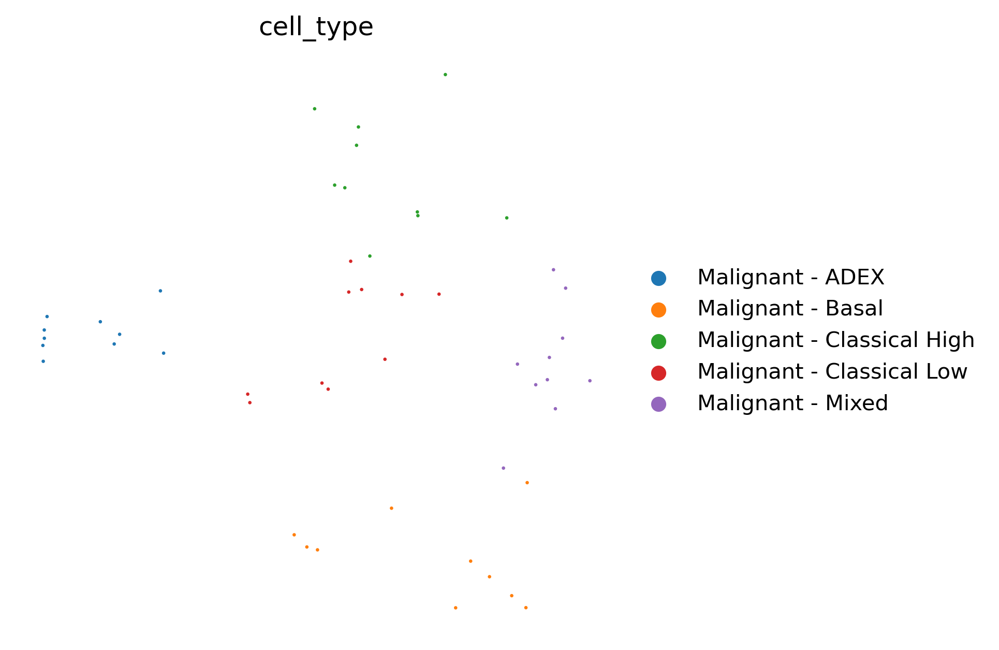

In [128]:
sc.pl.umap(downsample_adata(tumor, 'cell_type'),
           color='cell_type', size=10., frameon=False,
           save='_tumor_subtypes.pdf', palette=sns.color_palette()[:5])

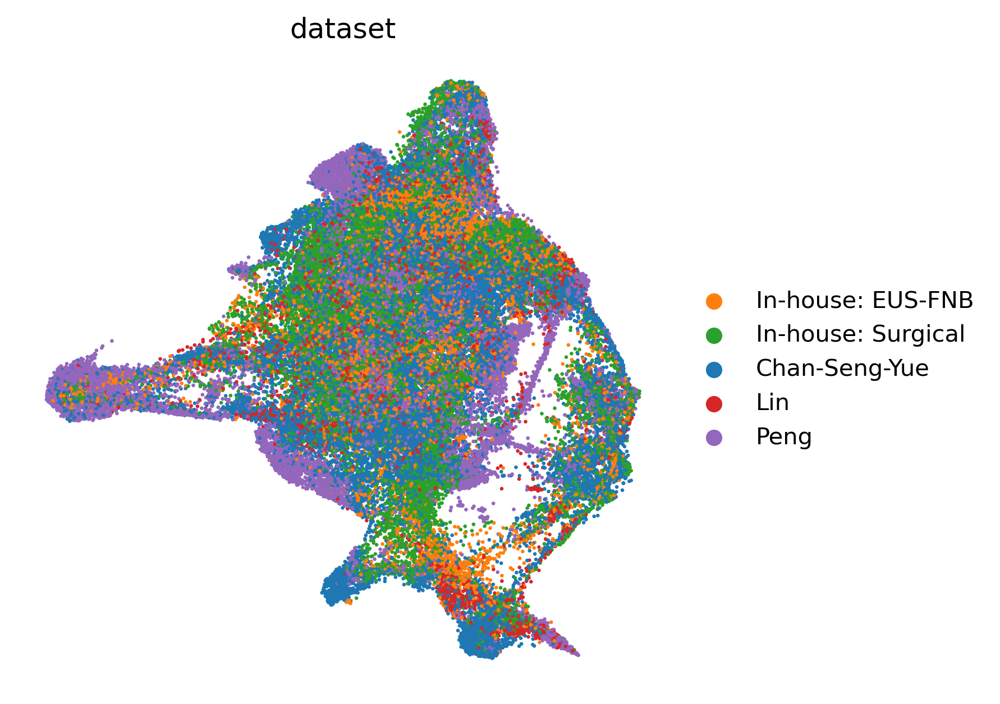

In [75]:
sc.pl.umap(tumor, color='dataset', size=10., frameon=False, groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_tumor_by_dataset.png')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


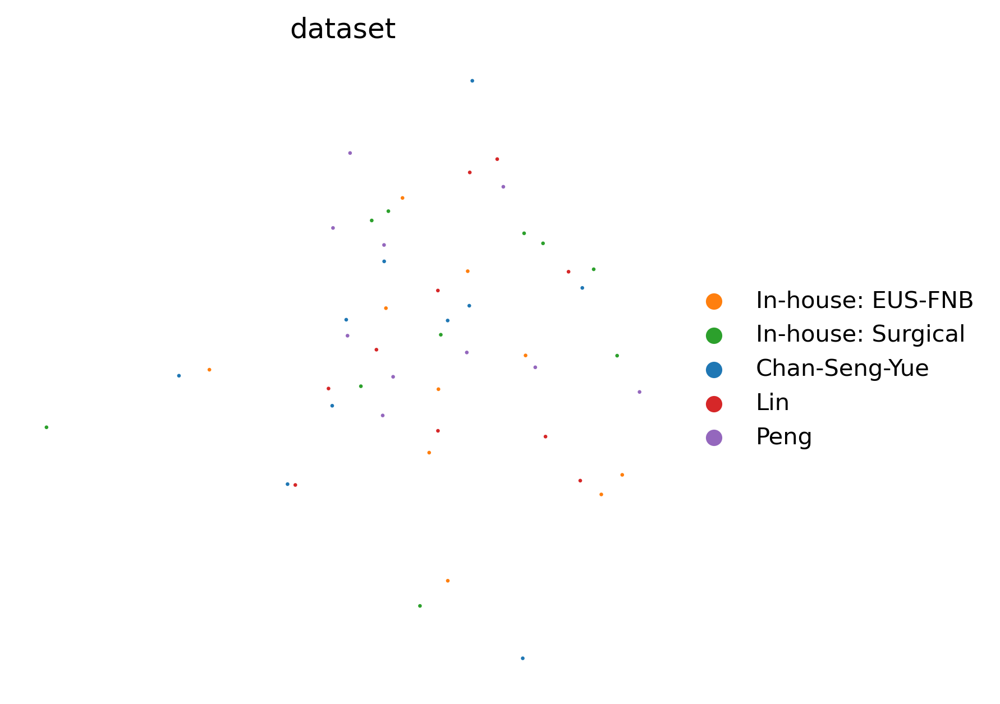

In [76]:
sc.pl.umap(downsample_adata(tumor, 'dataset'),
           color='dataset', size=10., frameon=False, groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_tumor_by_dataset.pdf')

In [ ]:
sc.pl.umap(tumor, color=['PRSS1', 'CDH5', 'EPCAM'])

In [ ]:
sc.pl.umap(adata, color=['PRSS1', 'CDH5', 'EPCAM'])

In [131]:
mpl.rcParams['figure.figsize'] = (6, 4)

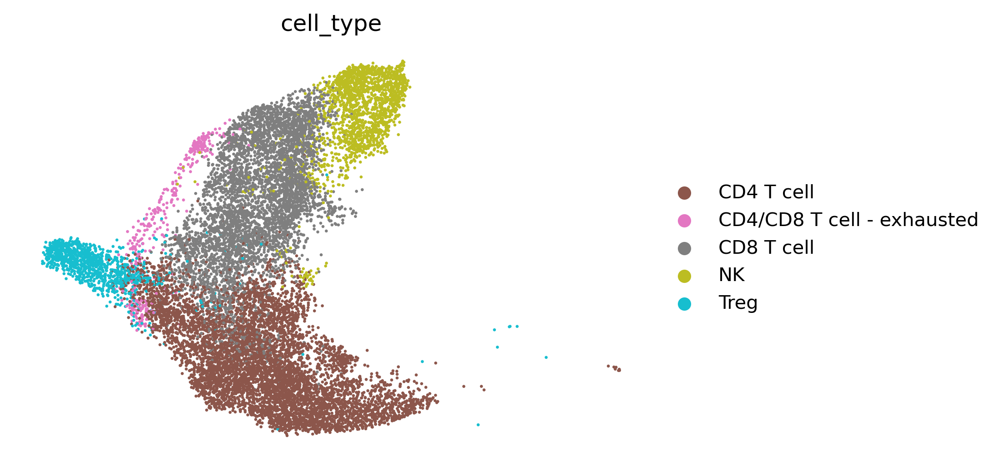

In [132]:
sc.pl.umap(immune, color='cell_type', frameon=False, size=10., save='_immune_subtypes.png', palette=sns.color_palette()[-5:])

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


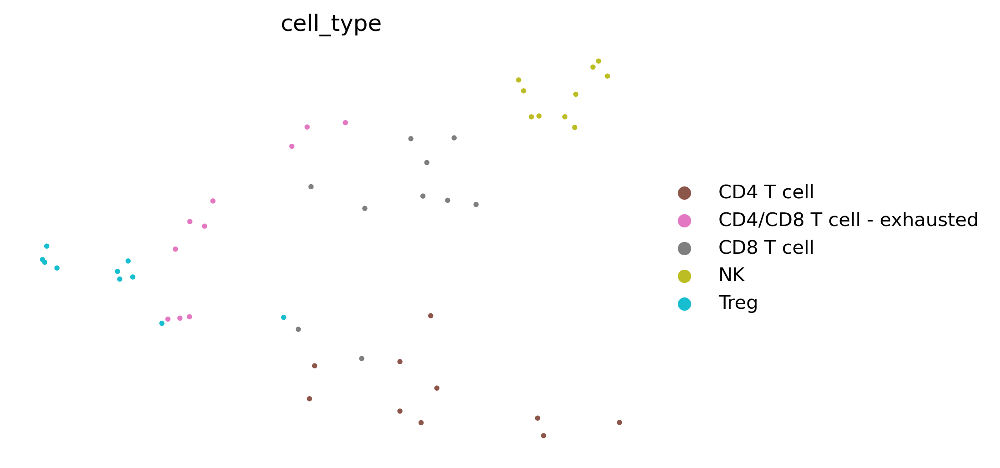

In [133]:
sc.pl.umap(downsample_adata(immune, 'cell_type'),
           color='cell_type', frameon=False, size=30., save='_immune_subtypes.pdf', palette=sns.color_palette()[-5:])

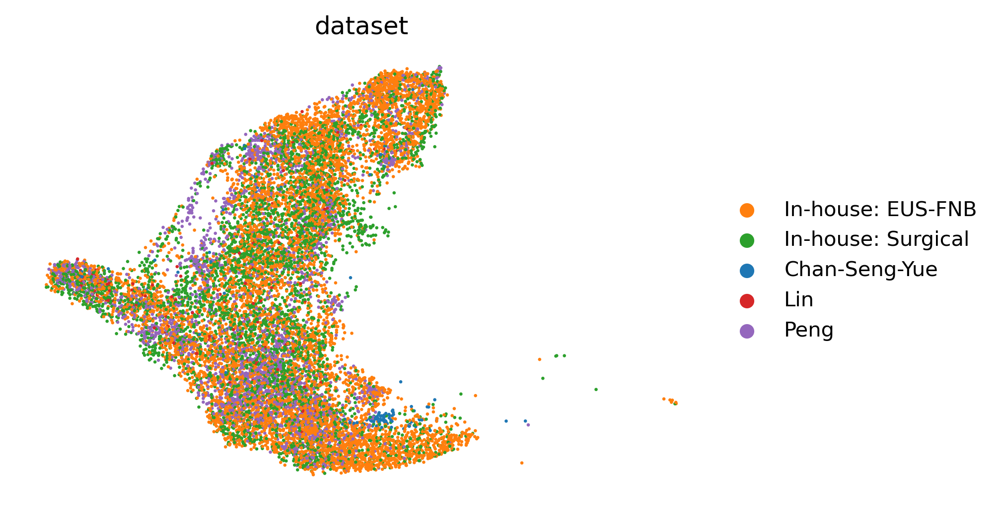

In [134]:
sc.pl.umap(immune, color='dataset', size=10., frameon=False, groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_immune_by_dataset.png')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


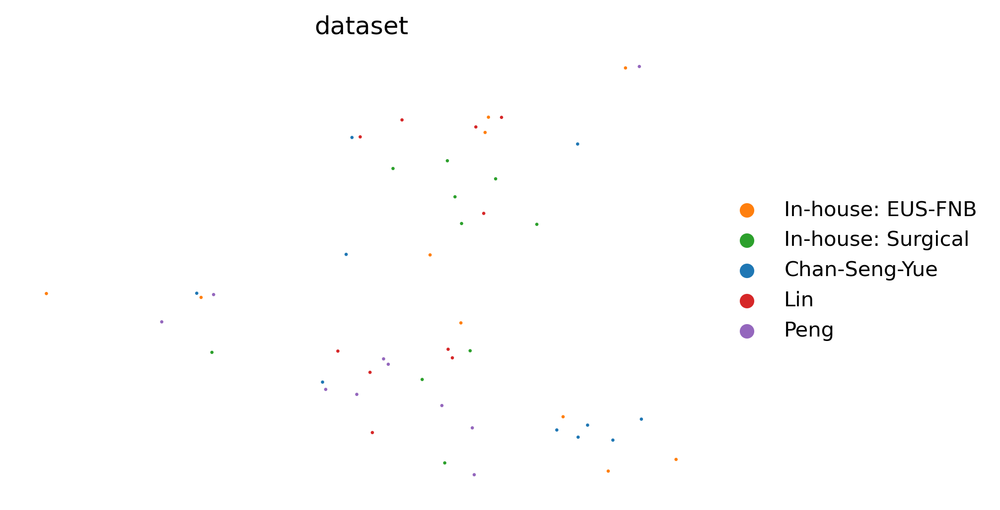

In [135]:
sc.pl.umap(downsample_adata(immune, 'dataset'),
           color='dataset', size=10., frameon=False, groups=['In-house: EUS-FNB', 'In-house: Surgical', 'Chan-Seng-Yue', 'Lin', 'Peng'],
           save='_immune_by_dataset.pdf')

In [136]:
mpl.rcParams['figure.figsize'] = (5, 5)

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


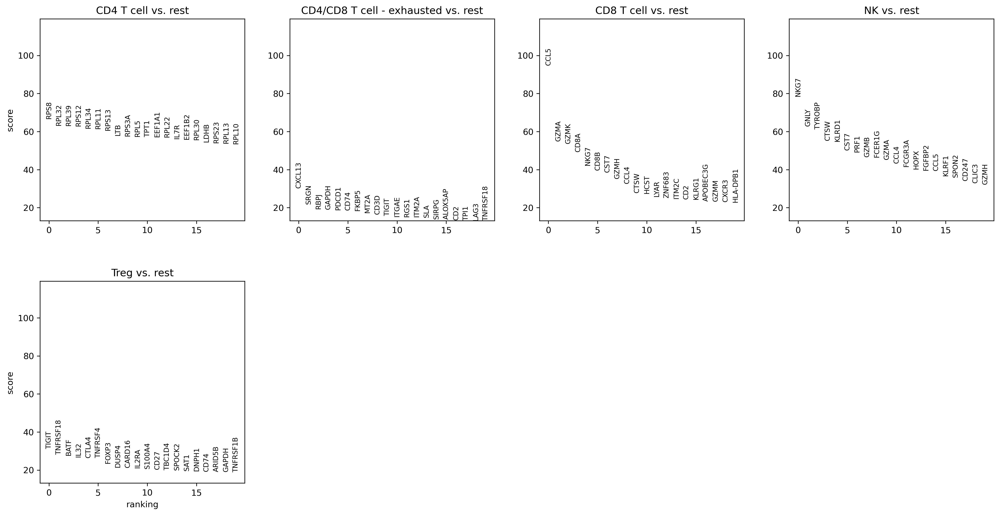

In [80]:
sc.tl.rank_genes_groups(immune, groupby='cell_type')
sc.pl.rank_genes_groups(immune)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


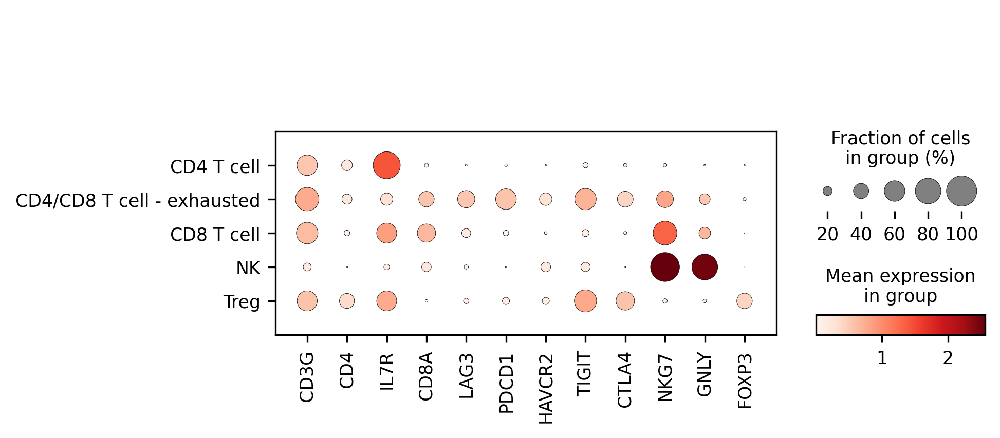

In [85]:
marker_genes = ['CD3G', 'CD4', 'IL7R', 'CD8A', 'LAG3', 'PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'NKG7', 'GNLY', 'FOXP3']
sc.pl.dotplot(immune, marker_genes, groupby='cell_type', save='_immune_marker_dotplot.pdf')

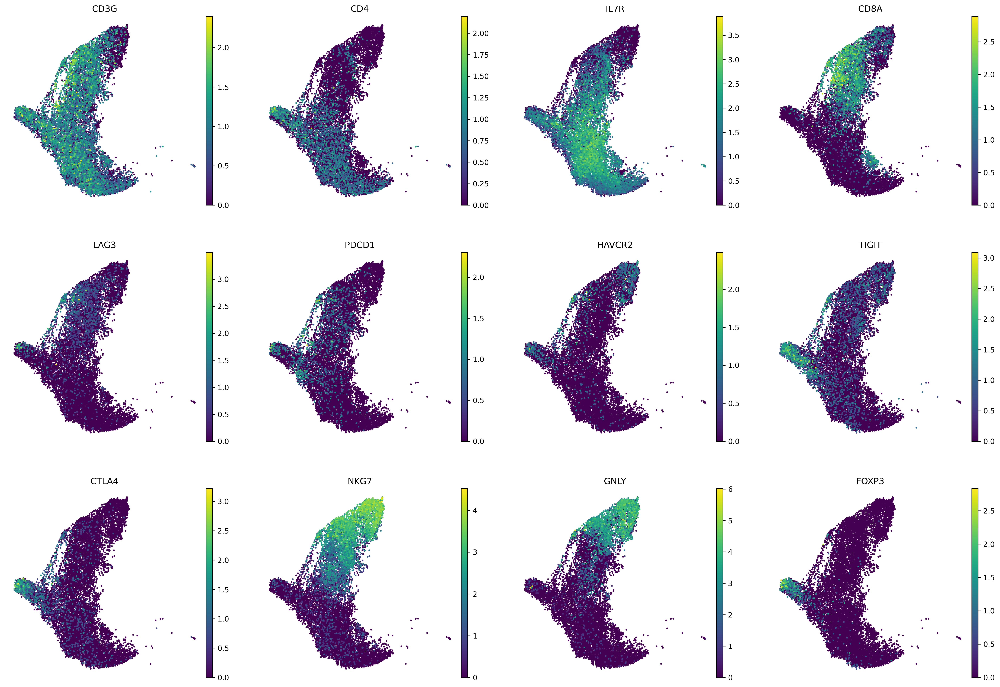

In [86]:
sc.pl.umap(immune, color=marker_genes, size=20., frameon=False)

In [32]:
# tumor.obs['cell_type'] = [adata.obs.loc[x, 'cell_type_level_3'] for x in tumor.obs.index]

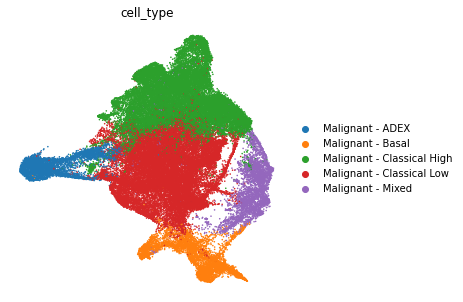

In [33]:
sc.pl.umap(tumor, color='cell_type', frameon=False, size=10.)

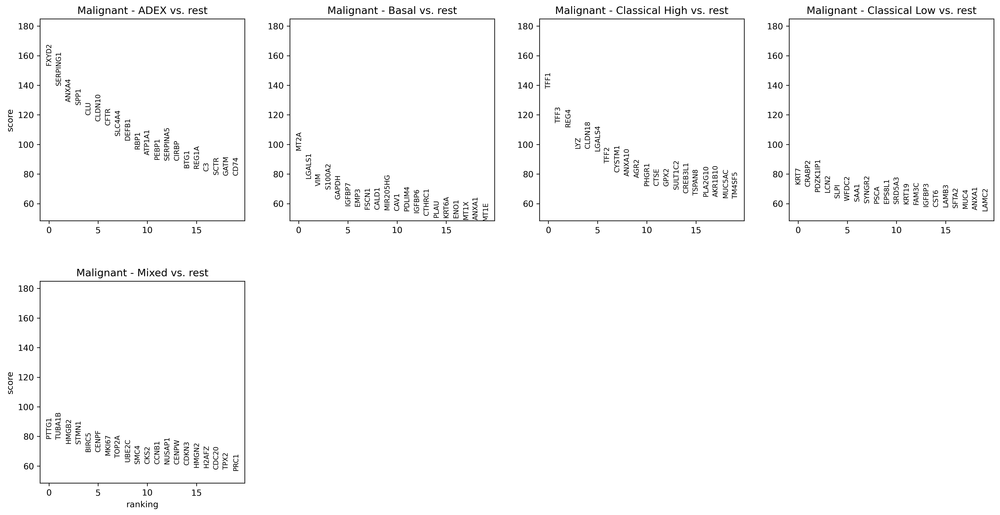

In [87]:
sc.tl.rank_genes_groups(tumor, groupby='cell_type')
sc.pl.rank_genes_groups(tumor)

 Bailey set: MTMR7, ARX, ABCC8, CEACAM7, CACNA2D2, MAPK8IP2, SYT7, LTF, NR1H4, SLC7A14, PRSS3, CPA1, AQP8, FGL1, SERPINI2, REG1A, NR5A2, RBPJL, KIRREL2, CLPS (Adex); CFH, CD99, HECW1, PLXND1, RECQL, C1orf112, M6PR, FKBP4, GGCT, DBF4, SEMA3F, ANKIB1, MAD1L1, CDC27, WDR54, DPM1, NME2, UTP18, SLC25A39, TTC27 (Squamous); ENPP4, CFTR, CYP51A1, ABP1, LASP1, TMEM176A, ICA1, DBNDD1, CASP10, SARM1, UPF1, ACSM3, SPPL2B, PDK2, OSBPL7, TMEM98, BAIAP2L1, ALDH3B1, TTC22, FARP2 (PancProg); CD38, PDK4, FBXL3, CD79B, MYLIP, RWDD2A, ACPP, TRAF3IP3, ACAP1, ARHGAP15, CST7, P2RY10, SIRPG, GRAP2, FGR, ITGAL, CEACAM21, CD4, BTK, TYROBP (Immunogenic). Collisson set: REG1B, REG3A, REG1A, PNLIPRP2, CEL, PNLIP, PLA2G1B, CELA3A, CPB1, CELA3B, CTRB2, CLPS, CELA2B, PRSS2, PRSS1, GP2, SLC3A1, CFTR, SLC4A4, SPINK1 (Exocrine-like); AIM2, CALHM6, GPM6B, S100A2, KRT14, CAV1, LOX, SLC2A3, TWIST1, PAPPA, NT5E, CKS2, HMMR, SLC5A3, PMAIP1, PHLDA1, SLC16A1 (Quasi-Mesenchymal); FERMT1, HK2, AHNAK2, TMEM45B, SDR16C5, GPRC5A, AGR2, S100P, FXYD3, ST6GALNAC1, CEACAM5, CEACAM6, TFF1, TFF3, CAPN8, FOXQ1, ELF3, ERBB3, TSPAN8, TOX3, LGALS4, PLS1, GPX2, ATP10B, MUC13 (Classical). Moffitt set: S100A2, KRT6A, CST6, GPR87, SCEL, ANXA8L2, KRT6C, SERPINB4, SERPINB3, LY6D, LY6D, PLAG1, IL20RB, C16orf74, DCBLD2, KRT17P3, HMGA2, SPRR3, SPRR1B, KRT17 (Basal-like); TM4SF5, TFF1, PLA2G10, GPX2, SPINK4, LOC400573, BTNL8, DMBT1, ATAD4, TFF3, FAM3D, LYZ, MYO1A, ANXA10, CLRN3, AKR1B10, CTSE, TSPAN8, LGALS4, REG4 (Classical)

In [88]:
gene_set_map = {
    'Bailey': {
        'ADEX': [
            "MTMR7",
            "ARX",
            "ABCC8",
            "CEACAM7",
            "CACNA2D2",
            "MAPK8IP2",
            "SYT7",
            "LTF",
            "NR1H4",
            "SLC7A14",
            "PRSS3",
            "CPA1",
            "AQP8",
            "FGL1",
            "SERPINI2",
            "REG1A",
            "NR5A2",
            "RBPJL",
            "KIRREL2",
            "CLP",
        ],
        'Squamous': [
            "CFH",
            "CD99",
            "HECW1",
            "PLXND1",
            "RECQL",
            "C1orf112",
            "M6PR",
            "FKBP4",
            "GGCT",
            "DBF4",
            "SEMA3F",
            "ANKIB1",
            "MAD1L1",
            "CDC27",
            "WDR54",
            "DPM1",
            "NME2",
            "UTP18",
            "SLC25A39",
            "TTC2",
        ],
        'Pancreatic Progenitor': [
            "ENPP4",
            "CFTR",
            "CYP51A1",
            "ABP1",
            "LASP1",
            "TMEM176A",
            "ICA1",
            "DBNDD1",
            "CASP10",
            "SARM1",
            "UPF1",
            "ACSM3",
            "SPPL2B",
            "PDK2",
            "OSBPL7",
            "TMEM98",
            "BAIAP2L1",
            "ALDH3B1",
            "TTC22",
            "FARP",    
        ],
        'Immunogenic': [
            "CD38",
            "PDK4",
            "FBXL3",
            "CD79B",
            "MYLIP",
            "RWDD2A",
            "ACPP",
            "TRAF3IP3",
            "ACAP1",
            "ARHGAP15",
            "CST7",
            "P2RY10",
            "SIRPG",
            "GRAP2",
            "FGR",
            "ITGAL",
            "CEACAM21",
            "CD4",
            "BTK",
            "TYROB",
        ],
    },
    'Collison': {
        'Exocrine-like': [
            "REG1B",
            "REG3A",
            "REG1A",
            "PNLIPRP2",
            "CEL",
            "PNLIP",
            "PLA2G1B",
            "CELA3A",
            "CPB1",
            "CELA3B",
            "CTRB2",
            "CLPS",
            "CELA2B",
            "PRSS2",
            "PRSS1",
            "GP2",
            "SLC3A1",
            "CFTR",
            "SLC4A4",
            "SPINK",
        ],
        'Quasi-Mesanchymal': [
            "AIM2",
            "CALHM6",
            "GPM6B",
            "S100A2",
            "KRT14",
            "CAV1",
            "LOX",
            "SLC2A3",
            "TWIST1",
            "PAPPA",
            "NT5E",
            "CKS2",
            "HMMR",
            "SLC5A3",
            "PMAIP1",
            "PHLDA1",
            "SLC16A",
        ],
        'Classical': [
            "FERMT1",
            "HK2",
            "AHNAK2",
            "TMEM45B",
            "SDR16C5",
            "GPRC5A",
            "AGR2",
            "S100P",
            "FXYD3",
            "ST6GALNAC1",
            "CEACAM5",
            "CEACAM6",
            "TFF1",
            "TFF3",
            "CAPN8",
            "FOXQ1",
            "ELF3",
            "ERBB3",
            "TSPAN8",
            "TOX3",
            "LGALS4",
            "PLS1",
            "GPX2",
            "ATP10B",
            "MUC1",
        ]
    },
    'Moffit': {
        'Basal-like': [
            "S100A2",
            "KRT6A",
            "CST6",
            "GPR87",
            "SCEL",
            "ANXA8L2",
            "KRT6C",
            "SERPINB4",
            "SERPINB3",
            "LY6D",
            "LY6D",
            "PLAG1",
            "IL20RB",
            "C16orf74",
            "DCBLD2",
            "KRT17P3",
            "HMGA2",
            "SPRR3",
            "SPRR1B",
            "KRT1",
        ],
        'Classical': [
            "TM4SF5",
            "TFF1",
            "PLA2G10",
            "GPX2",
            "SPINK4",
            "LOC400573",
            "BTNL8",
            "DMBT1",
            "ATAD4",
            "TFF3",
            "FAM3D",
            "LYZ",
            "MYO1A",
            "ANXA10",
            "CLRN3",
            "AKR1B10",
            "CTSE",
            "TSPAN8",
            "LGALS4",
            "REG",
        ]
    }
}

In [89]:
data = []
order = sorted(set(tumor.obs['cell_type']))
for study, d in gene_set_map.items():
    for subtype, genes in d.items():
        for ct in order:
            small = tumor[tumor.obs['cell_type']==ct]
            score = np.sum(small[:, [g for g in genes if g in small.var.index]].X.toarray().flatten())
            score = np.log(score / small.shape[0])
            data.append([study, subtype, ct, score])
df = pd.DataFrame(data=data, columns=['Study', 'Subtype', 'Cell Type', 'Score'])
df

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,Study,Subtype,Cell Type,Score
0,Bailey,ADEX,Malignant - ADEX,1.324899
1,Bailey,ADEX,Malignant - Basal,-0.373130
2,Bailey,ADEX,Malignant - Classical High,0.031822
3,Bailey,ADEX,Malignant - Classical Low,-0.100709
4,Bailey,ADEX,Malignant - Mixed,-0.285431
5,Bailey,Squamous,Malignant - ADEX,1.093619
6,Bailey,Squamous,Malignant - Basal,1.389651
7,Bailey,Squamous,Malignant - Classical High,0.794163
8,Bailey,Squamous,Malignant - Classical Low,1.061070
9,Bailey,Squamous,Malignant - Mixed,1.319366


In [90]:
charts = None
for study in sorted(set(df['Study'])):
    source = df[df['Study']==study]
    
#     source = pd.DataFrame(source.values / np.sum(source.values, axis=0))
    
    chart = alt.Chart(source, title=study).mark_rect().encode(
        x=alt.X('Cell Type'),
        y=alt.Y('Subtype'),
        color=alt.Color('Score:Q', scale=alt.Scale(scheme='viridis'))
    )
    if charts is None:
        charts = chart
    else:
        charts = alt.vconcat(charts, chart)
charts

alt.VConcatChart(...)

In [91]:
for study, d in gene_set_map.items():
    for subtype, genes in d.items():
        tumor.obs[f'{study}_{subtype}'] = np.mean(tumor[:, [g for g in genes if g in tumor.var.index]].X.toarray(),
                                                 axis=1).flatten()

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


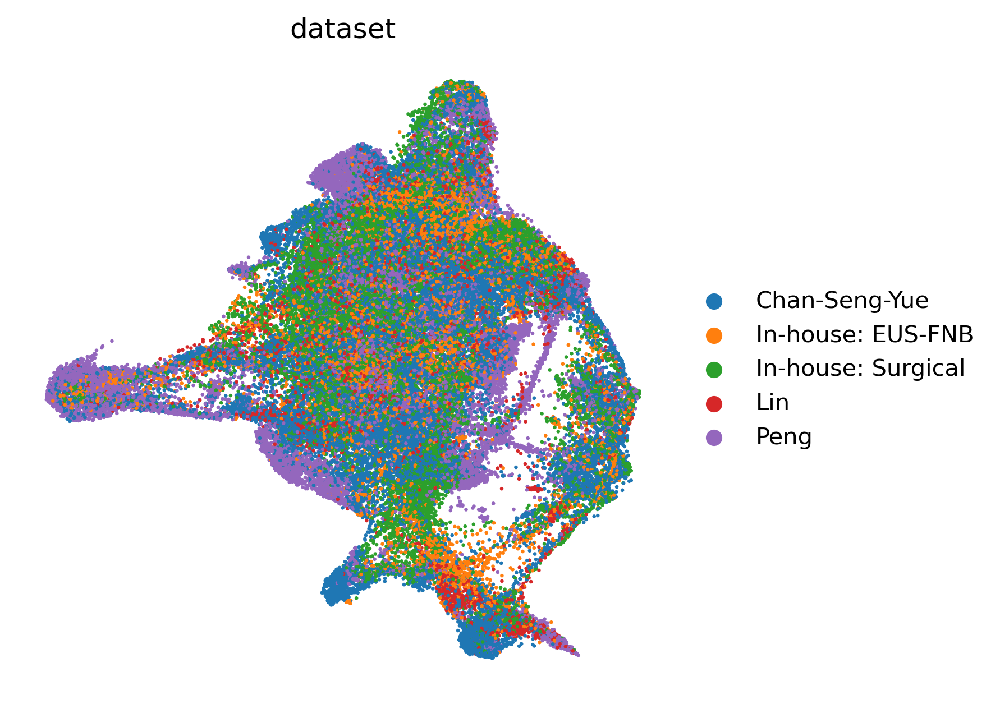

In [92]:
sc.pl.umap(tumor, color=['dataset'],
           frameon=False, size=10.)

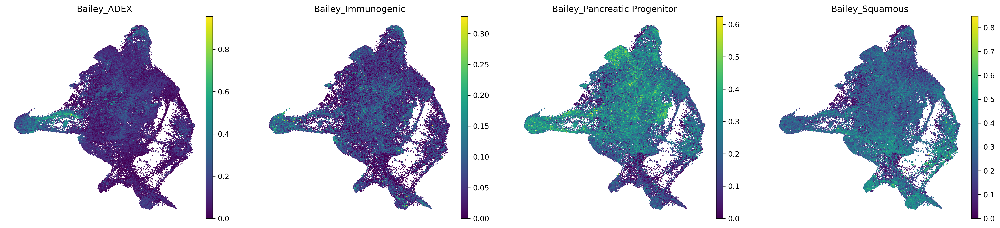

In [96]:
sc.pl.umap(tumor, color=['Bailey_ADEX', 'Bailey_Immunogenic', 'Bailey_Pancreatic Progenitor', 'Bailey_Squamous'],
           frameon=False, size=10., save='_tumor_subtypes_bailey.png')

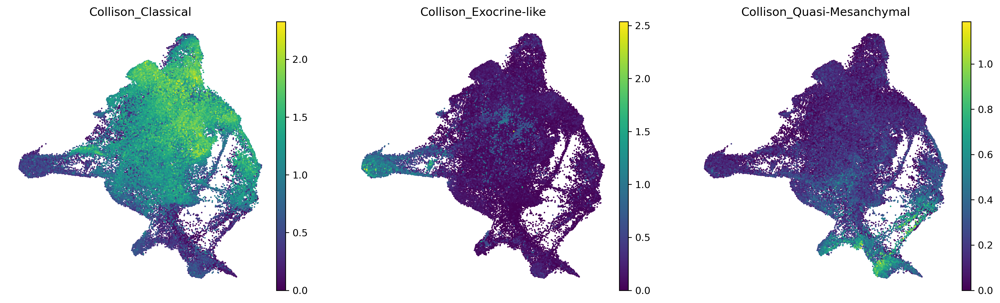

In [97]:
sc.pl.umap(tumor, color=['Collison_Classical', 'Collison_Exocrine-like', 'Collison_Quasi-Mesanchymal'],
           frameon=False, size=10., save='_tumor_subtypes_collison.png')

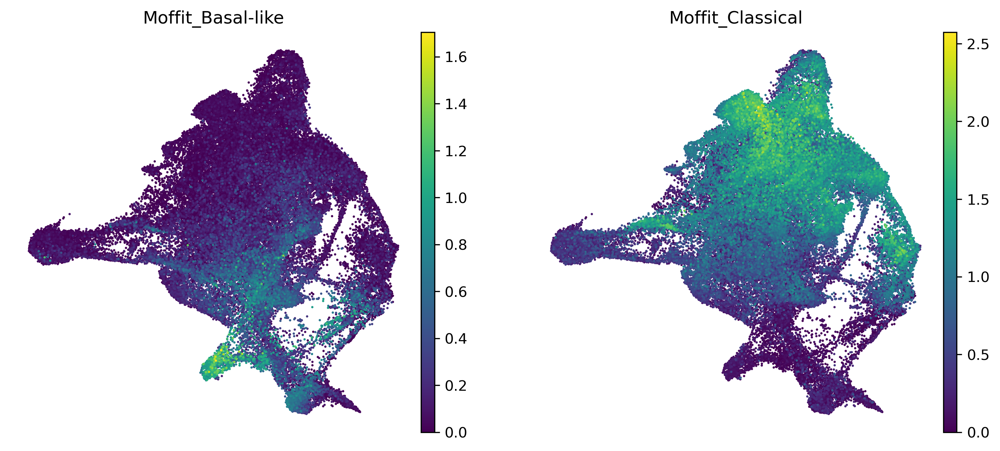

In [98]:
sc.pl.umap(tumor, color=['Moffit_Basal-like', 'Moffit_Classical'],
           frameon=False, size=10., save='_tumor_subtypes_moffit.png')

In [99]:
clfs = [f'{k}_{v}' for k, vs in gene_set_map.items() for v in vs.keys()]
clfs = ['Bailey_Squamous', 'Collison_Quasi-Mesanchymal', 'Moffit_Basal-like',
       'Bailey_Pancreatic Progenitor', 'Collison_Classical', 'Moffit_Classical',
       'Bailey_ADEX', 'Collison_Exocrine-like',
       'Bailey_Immunogenic']
padata = anndata.AnnData(X=tumor.obs[clfs], obs=tumor.obs.copy())
padata.var.index = clfs
padata

AnnData object with n_obs × n_vars = 65977 × 9
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'integrated_snn_res.0.1', 'active.ident', 'cell_type', 'dataset', 'Bailey_ADEX', 'Bailey_Squamous', 'Bailey_Pancreatic Progenitor', 'Bailey_Immunogenic', 'Collison_Exocrine-like', 'Collison_Quasi-Mesanchymal', 'Collison_Classical', 'Moffit_Basal-like', 'Moffit_Classical'

In [100]:
clfs

['Bailey_Squamous',
 'Collison_Quasi-Mesanchymal',
 'Moffit_Basal-like',
 'Bailey_Pancreatic Progenitor',
 'Collison_Classical',
 'Moffit_Classical',
 'Bailey_ADEX',
 'Collison_Exocrine-like',
 'Bailey_Immunogenic']

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


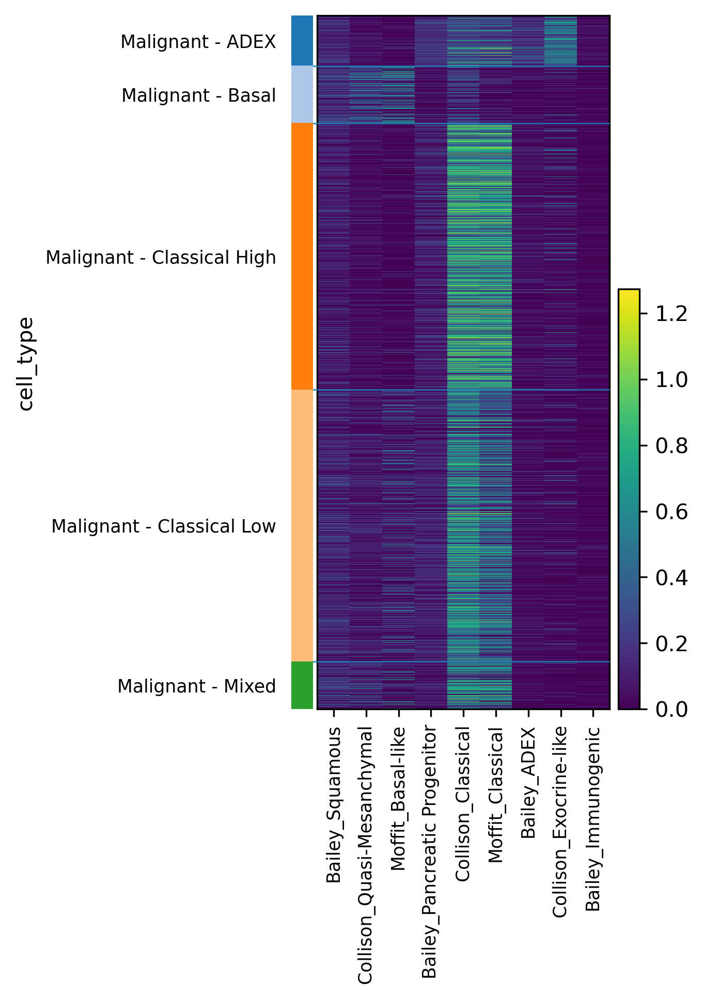

In [101]:
sc.pl.heatmap(padata, var_names=padata.var.index, groupby='cell_type', log=True)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


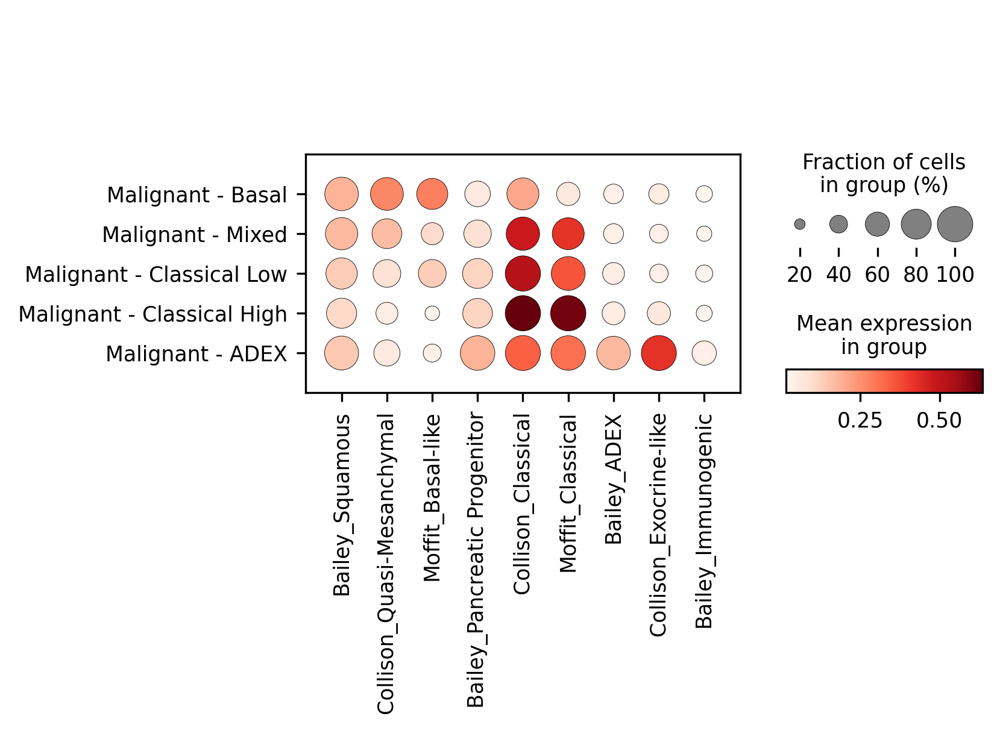

In [103]:
sc.pl.dotplot(padata, var_names=padata.var.index, groupby='cell_type', log=True,
              categories_order=['Malignant - Basal', 'Malignant - Mixed', 'Malignant - Classical Low',
                               'Malignant - Classical High', 'Malignant - ADEX'],
              save='_tumor_subtype_dotplot.pdf')

###### cytotrace

In [104]:
cytotrace = pd.read_csv('/diskmnt/Projects/Users/estorrs/sc_pdac/data/cytotrace/05242021/results.txt',
                       sep='\t')
# cytotrace.index = [x[:-2] + '-' + x[-1] for x in cytotrace.index]
cytotrace.index = [x.replace('.', '-') if 'h5.h5' not in x else x for x in cytotrace.index]
cytotrace.index = [x[:-2] + '-' + x[-1] if 'h5.h5' in x else x for x in cytotrace.index]
cytotrace.index = [x[1:] if 'X'==x[0] else x for x in cytotrace.index]

cytotrace.columns = ['Cytotrace']
cytotrace

,Cytotrace
100070_filtered_gene_bc_matrices_h5.h5_AAACCTGAGCGTAATA-1,0.761194
100070_filtered_gene_bc_matrices_h5.h5_AAACCTGCAATCCGAT-1,0.717413
100070_filtered_gene_bc_matrices_h5.h5_AAACCTGCACTAGTAC-1,0.944279
100070_filtered_gene_bc_matrices_h5.h5_AAACGGGAGACTGGGT-1,0.744279
100070_filtered_gene_bc_matrices_h5.h5_AAACGGGAGGGTCGAT-1,0.813930
...,...
TWCE-HT081P1-XB1_TTTCCTCTCGTGTTCC-1,0.232836
TWCE-HT081P1-XB1_TTTGACTCAACTCGTA-1,0.154229
TWCE-HT081P1-XB1_TTTGACTTCGGCTTGG-1,0.334328
TWCE-HT081P1-XB1_TTTGGAGGTTGTCATG-1,0.282587


In [105]:
m = pd.merge(cytotrace, tumor.obs, left_index=True, right_index=True)
from collections import Counter
Counter(m['dataset']), Counter(tumor.obs['dataset'])

(Counter({'Chan-Seng-Yue': 23410,
          'In-house: EUS-FNB': 8723,
          'Lin': 4735,
          'Peng': 14155,
          'In-house: Surgical': 14954}),
 Counter({'Peng': 14155,
          'In-house: EUS-FNB': 8723,
          'In-house: Surgical': 14954,
          'Lin': 4735,
          'Chan-Seng-Yue': 23410}))

In [106]:
len(set(tumor.obs.index).intersection(set(cytotrace.index)))

65977

In [107]:
tumor.obs = pd.merge(tumor.obs, cytotrace, left_index=True, right_index=True)

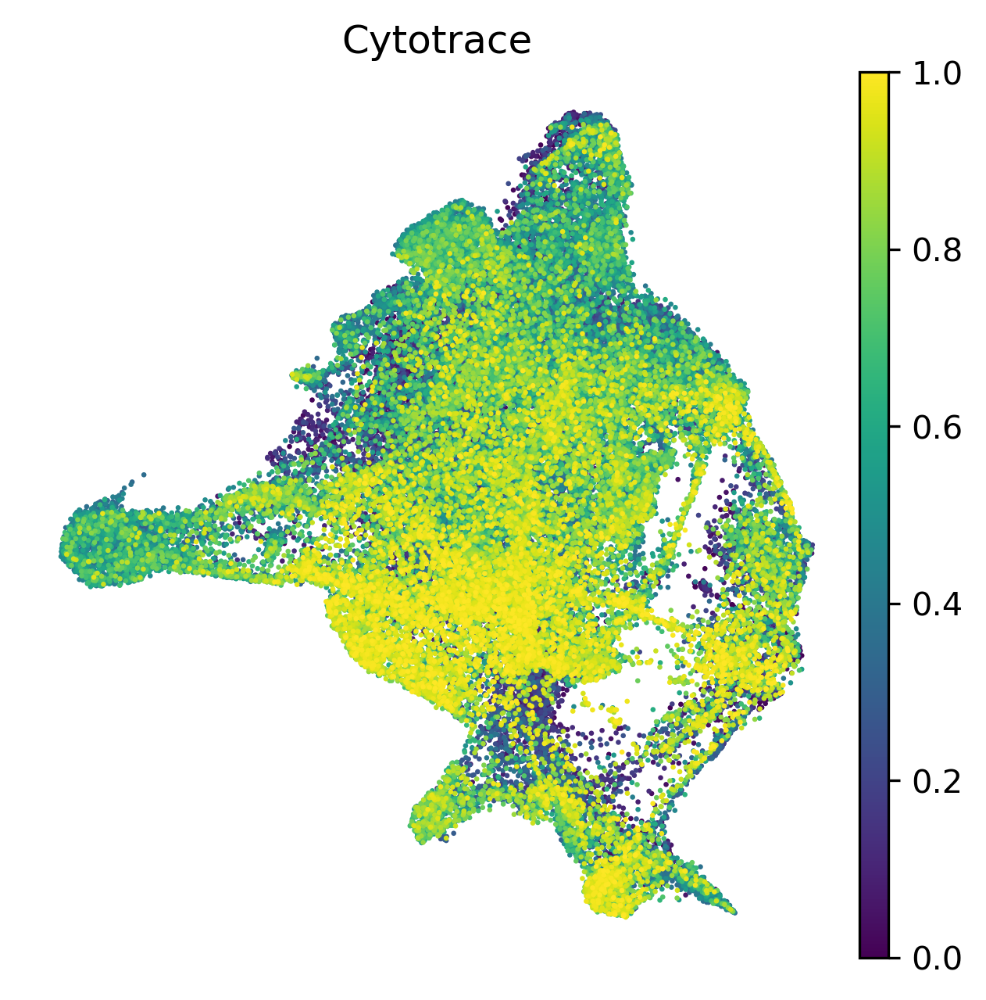

In [108]:
sc.pl.umap(tumor, color=['Cytotrace'],
           frameon=False, size=10.)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


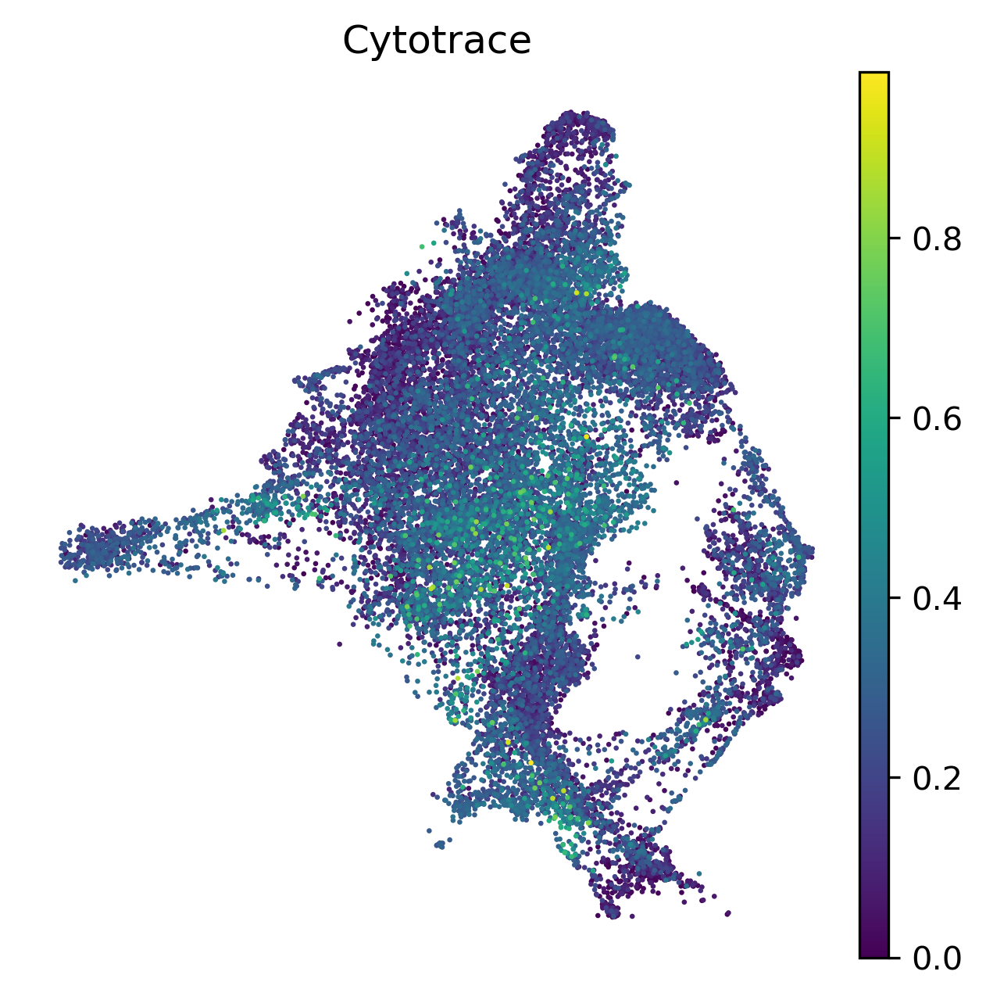

In [112]:
sc.pl.umap(tumor[[True if 'house' in x else False for x in tumor.obs['dataset']]], color=['Cytotrace'],
           frameon=False, size=10., save='_cytotrace_inhouse.png')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


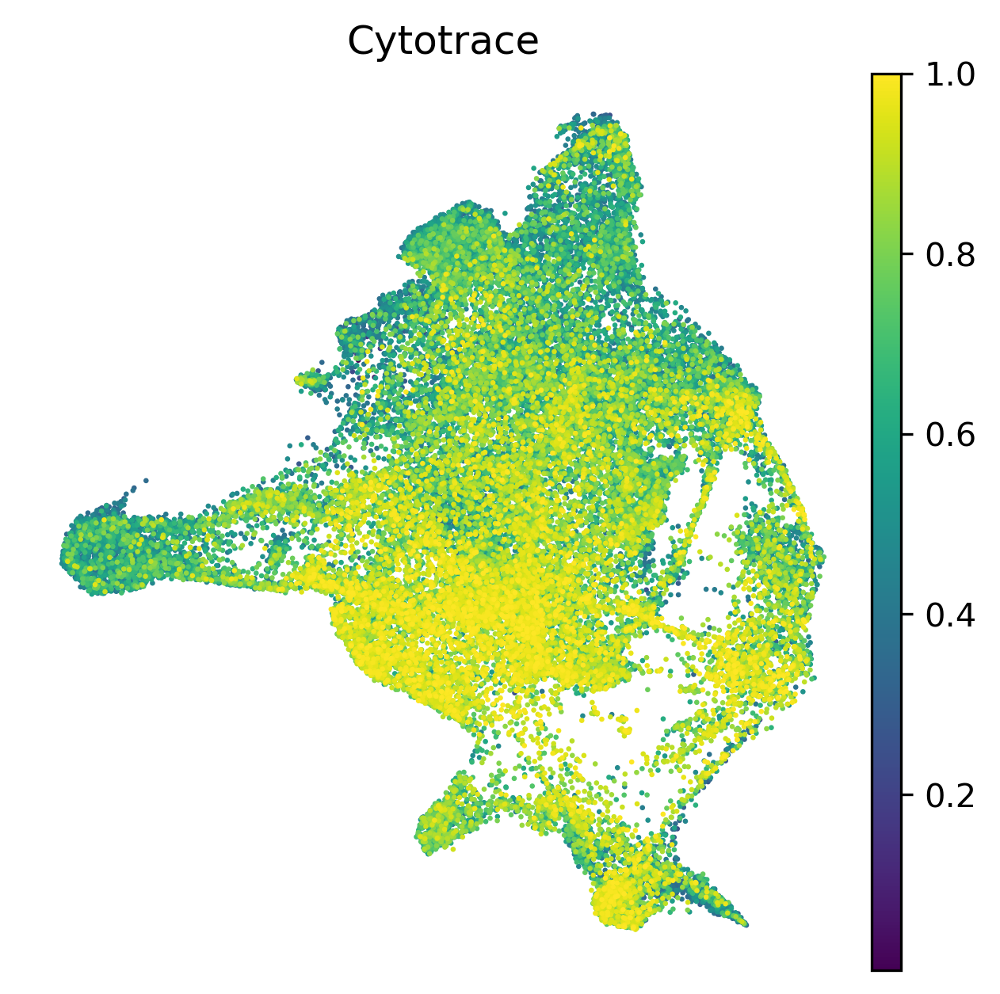

In [111]:
sc.pl.umap(tumor[[True if 'house' not in x else False for x in tumor.obs['dataset']]], color=['Cytotrace'],
           frameon=False, size=10., save='_cytotrace_public.png')

In [113]:
nohouse = tumor[[True if 'house' not in x else False for x in tumor.obs['dataset']]]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'Malignant - ADEX'),
  Text(1, 0, 'Malignant - Basal'),
  Text(2, 0, 'Malignant - Classical High'),
  Text(3, 0, 'Malignant - Classical Low'),
  Text(4, 0, 'Malignant - Mixed')])

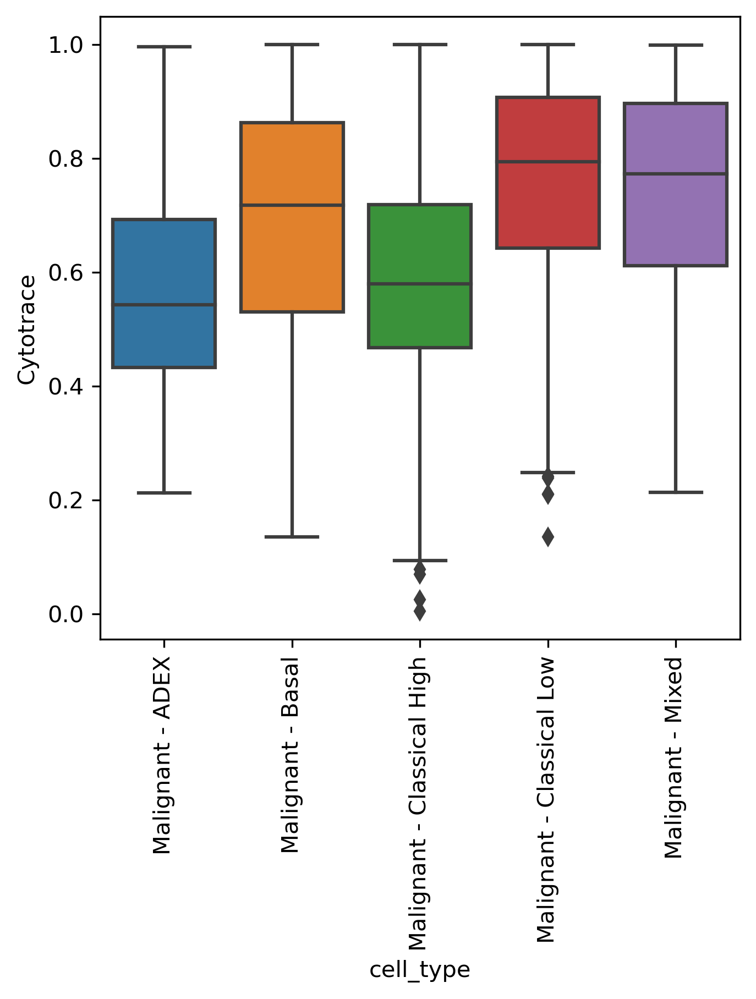

In [114]:
sns.boxplot(data=nohouse.obs, x='cell_type', y='Cytotrace')
plt.xticks(rotation=90)

In [115]:
house = tumor[[True if 'house' in x else False for x in tumor.obs['dataset']]]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


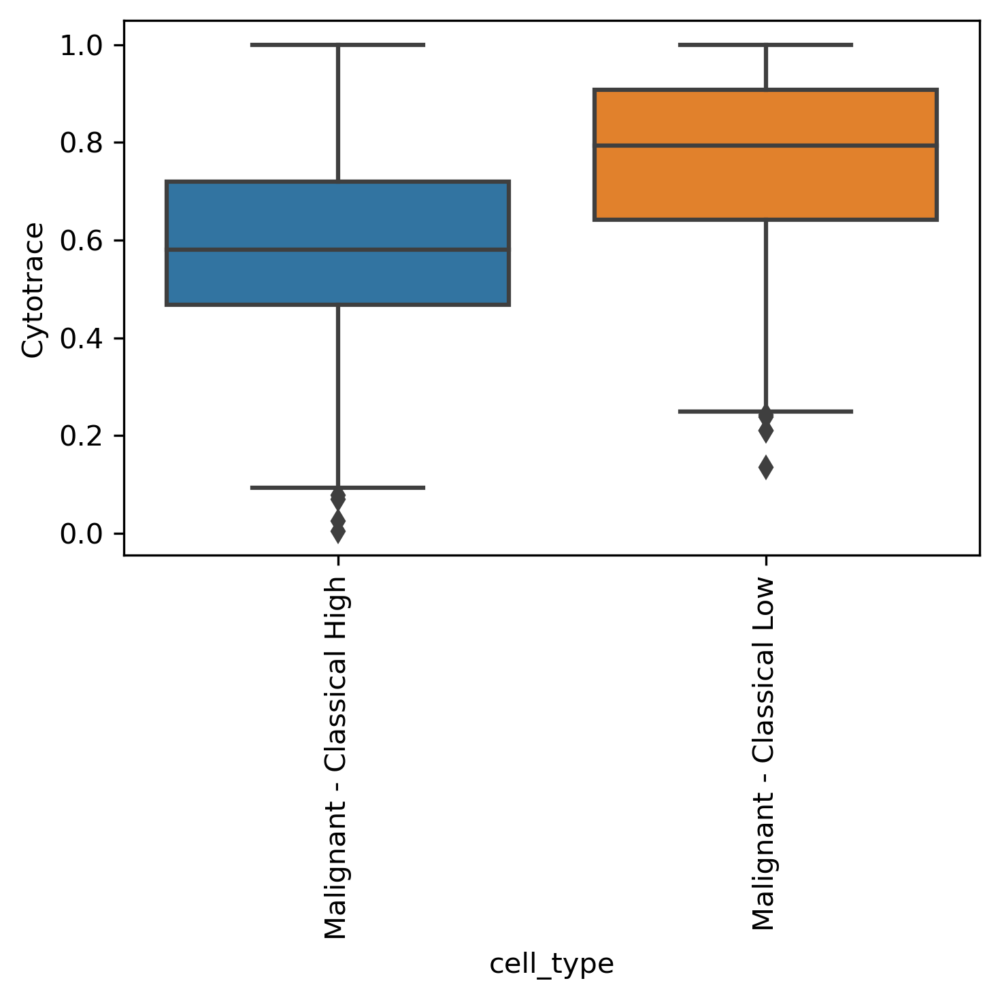

In [119]:
sns.boxplot(data=nohouse[[True if 'Classical' in x else False for x in nohouse.obs['cell_type']]].obs,
            x='cell_type', y='Cytotrace')
plt.xticks(rotation=90)
plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'cytotrace_classical_boxplot.pdf'))

###### cibersortx/bulk

In [34]:
integrated = sc.read_h5ad('../results/survival/05242021/integrated_v2.h5ad')

In [35]:
integrated

AnnData object with n_obs × n_vars = 391 × 21
    obs: 'age', 'gender', 'race', 'tumor_stage', 'survival_time', 'status', 'dataset', 'Malignant_0_tumor_fraction', 'Malignant_1_tumor_fraction', 'Malignant_2_tumor_fraction', 'Malignant_3_tumor_fraction', 'Malignant_4_tumor_fraction', 'leiden'
    uns: 'dataset_colors', "dendrogram_['leiden']", 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'

In [36]:
from collections import Counter
Counter(integrated.obs['dataset']).most_common()

[('tcga', 136), ('moffit', 123), ('bailey', 87), ('kirby', 45)]

In [37]:
mpl.rcParams['figure.figsize'] = (5, 5)

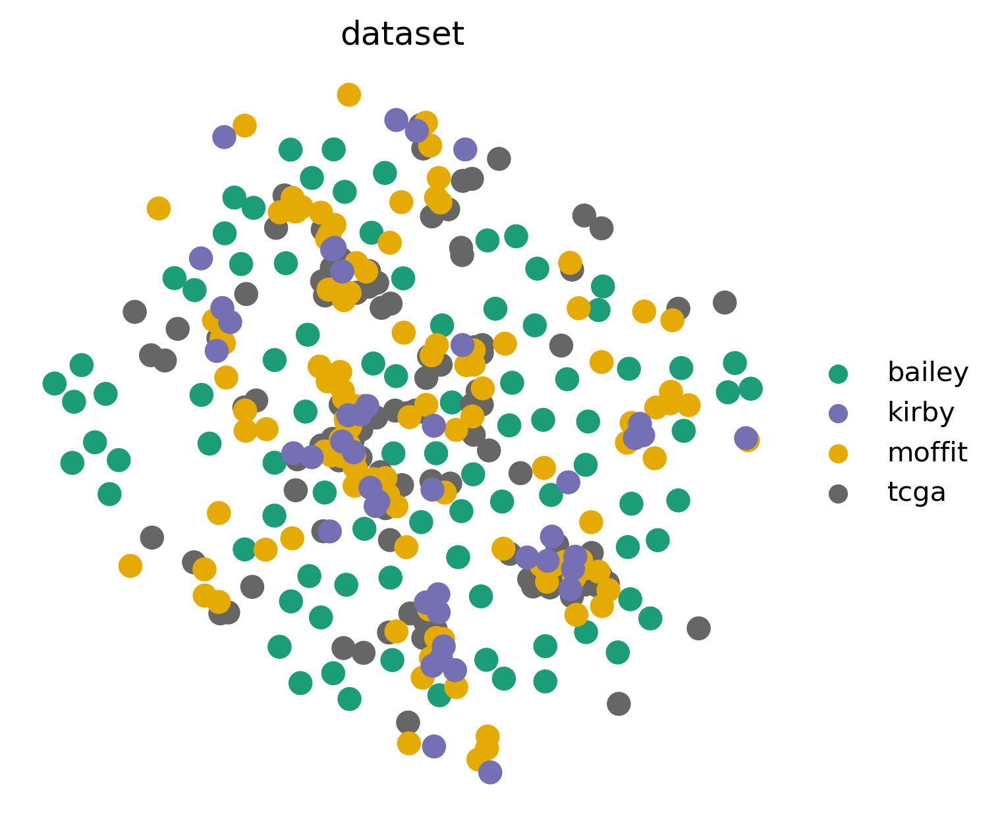

In [38]:
sc.pl.umap(integrated, color='dataset', frameon=False, save='_community_dataset.pdf', palette='Dark2')

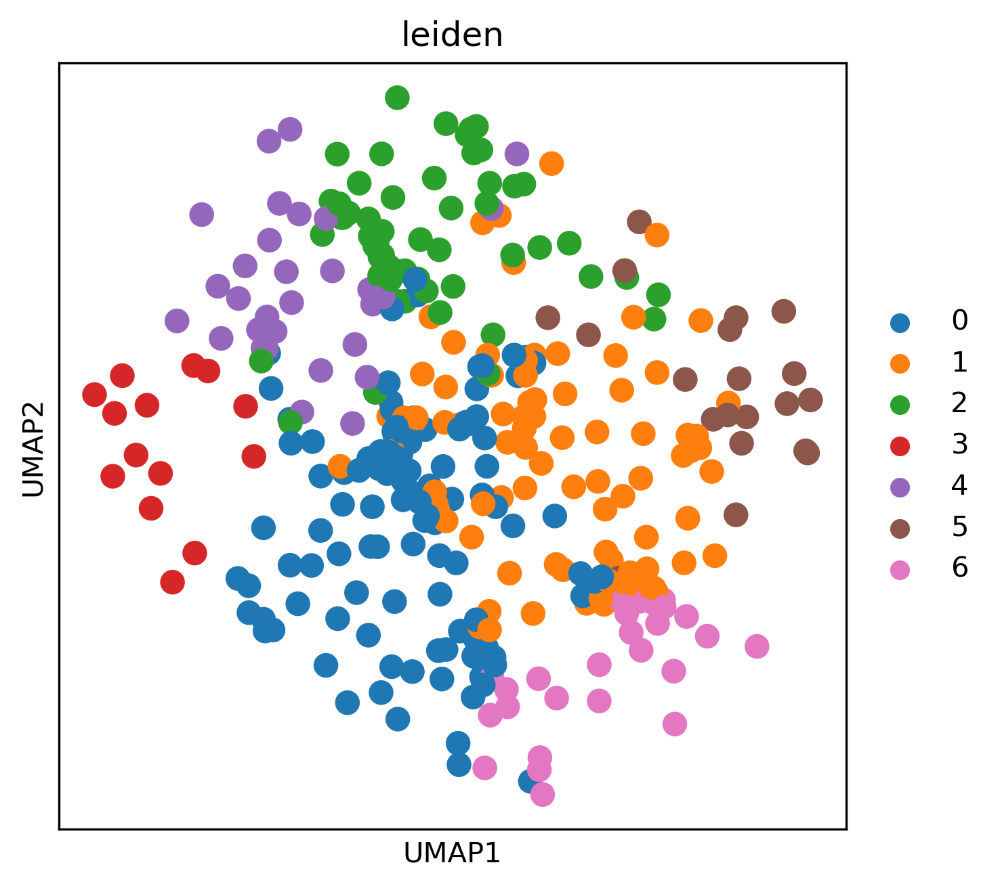

In [39]:
sc.pl.umap(integrated, color='leiden')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


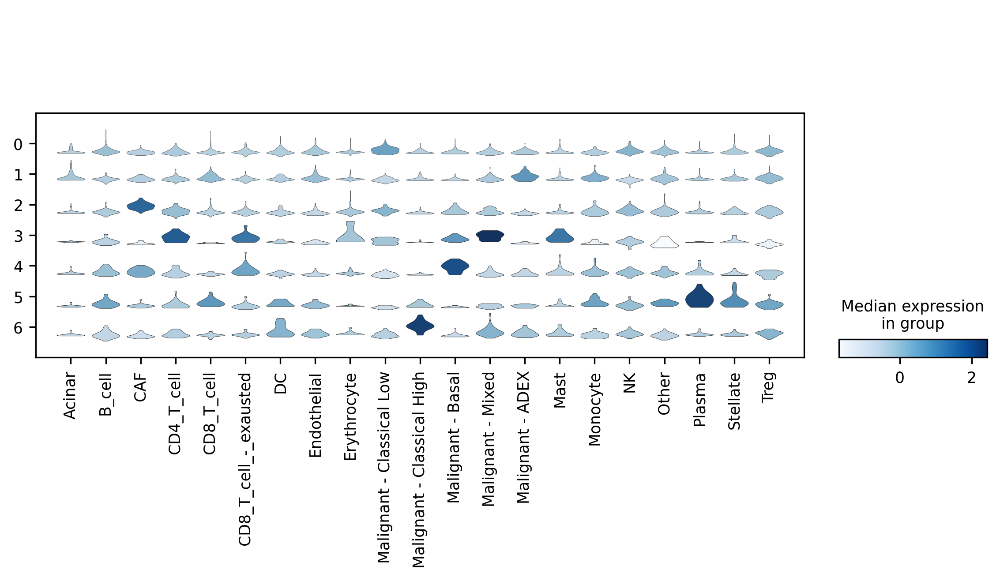

In [40]:
sc.pl.stacked_violin(integrated, groupby='leiden', var_names=integrated.var.index)

In [41]:
names = {
    'Other': 'Stellate 2',
    'Stellate': 'Stellate 1',
    'CD8_T_cell_-_exausted': 'CD4/CD8 T cell - exhausted'
}
integrated.var.index = [names.get(x, x) for x in integrated.var.index]

In [42]:
names = {
    '0': 'Classical Low',
    '1': 'ADEX',
    '2': 'CAF High',
    '3': 'Basal/Classical',
    '4': 'Basal',
    '5': 'Mixed - Immune High',
    '6': 'Classical High',
}
integrated.obs['cluster'] = [names[x] for x in integrated.obs['leiden']]

In [43]:
integrated.uns.keys()
# integrated.uns.pop("dendrogram_['cluster']")

dict_keys(['dataset_colors', "dendrogram_['leiden']", 'leiden_colors', 'rank_genes_groups'])

In [44]:
var_order = [
    'Malignant - Basal',
    'Malignant - Mixed',
    'Malignant - Classical Low',
    'Malignant - Classical High',
    'Malignant - ADEX',
    'CD4_T_cell',
    'CD8_T_cell',
    'CD4/CD8 T cell - exhausted',
    'DC',
    'Mast',
    'Monocyte',
    'NK',
    'Plasma',
    'Treg',
    'Acinar',
    'CAF',
    'Endothelial',
    'Erythrocyte',
    'Stellate 1',
    'Stellate 2'
]
cluster_order = [
    'Basal',
    'Basal/Classical',
    'Classical Low',
    'Classical High',
    'ADEX',
    'Mixed - Immune High',
    'CAF High'
]

... storing 'cluster' as categorical


/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


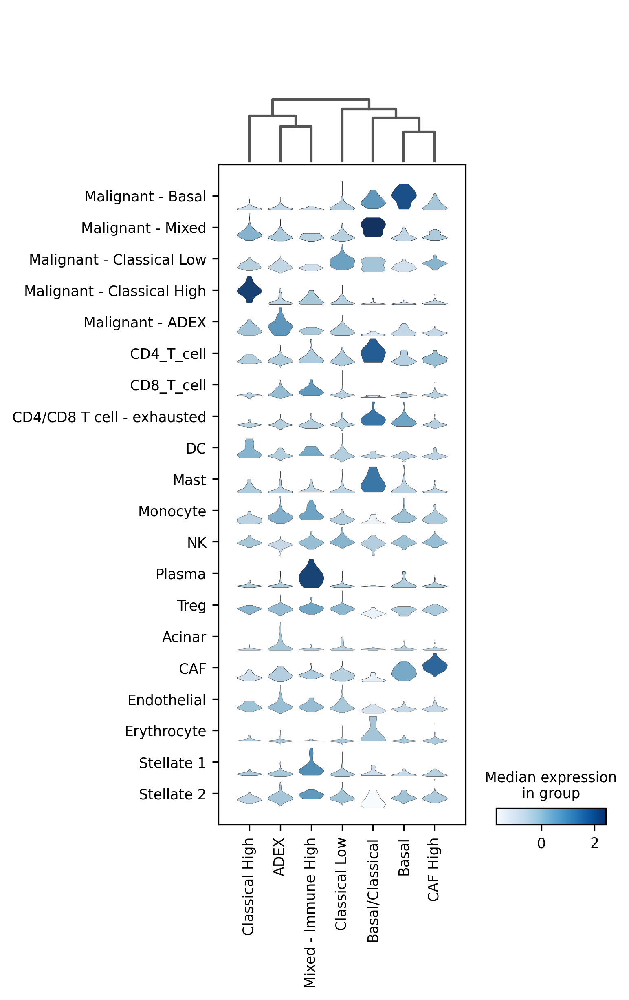

In [45]:
axs = sc.pl.stacked_violin(integrated, groupby='cluster', var_names=var_order, dendrogram=True,
                           swap_axes=True, categories_order=cluster_order)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


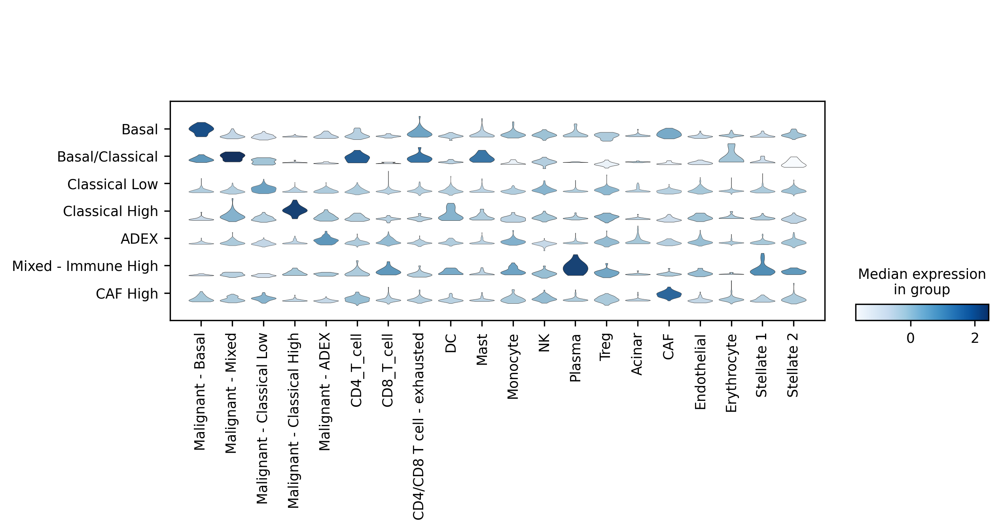

In [46]:
axs = sc.pl.stacked_violin(integrated, groupby='cluster', var_names=var_order, dendrogram=False,
                           swap_axes=False, categories_order=cluster_order, save='_community_cell_fraction_violins.pdf')

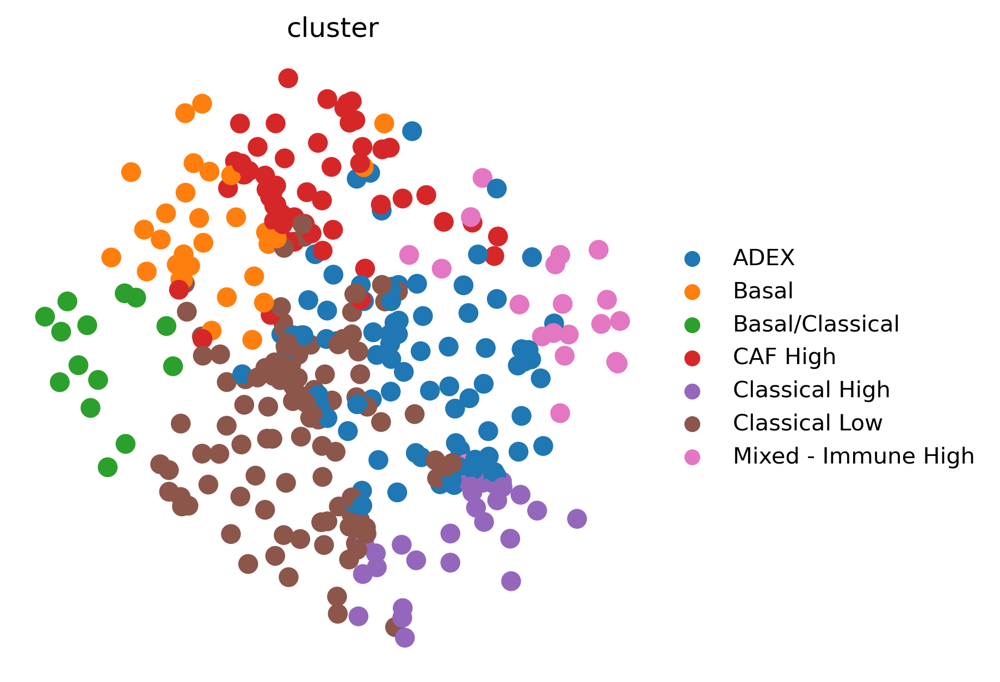

In [47]:
sc.pl.umap(integrated, color='cluster', frameon=False, save='_community_cluster.pdf')

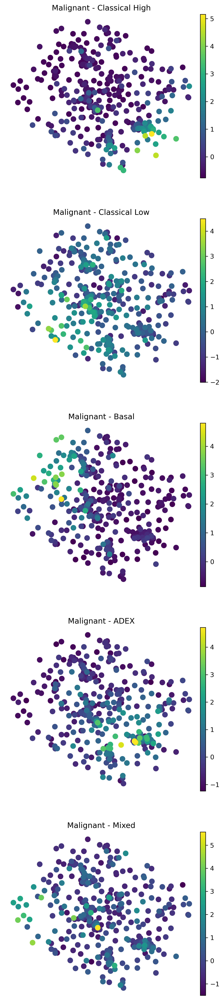

In [48]:
markers = ['Malignant - Classical High', 'Malignant - Classical Low', 'Malignant - Basal', 'Malignant - ADEX',
          'Malignant - Mixed']
sc.pl.umap(integrated, color=markers, ncols=1, frameon=False)

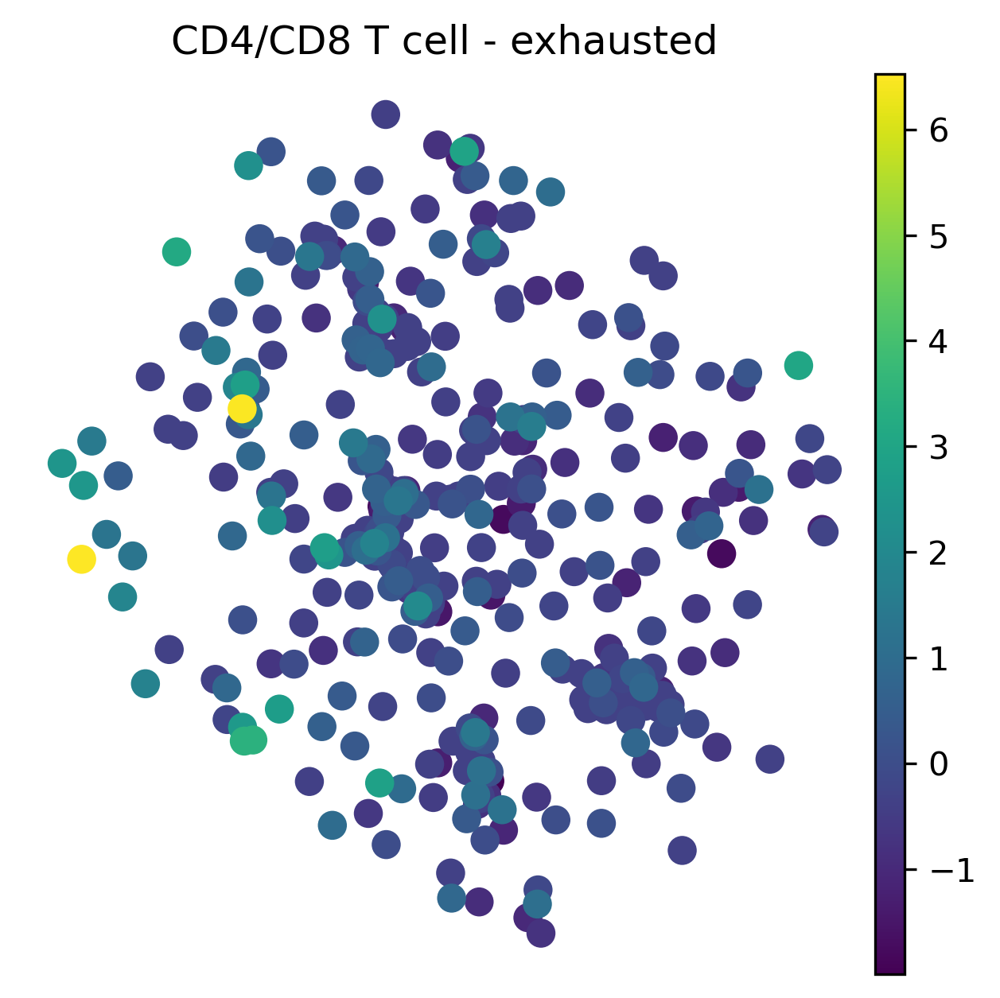

In [49]:
markers = ['CD4/CD8 T cell - exhausted']
sc.pl.umap(integrated, color=markers, ncols=1, frameon=False)

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


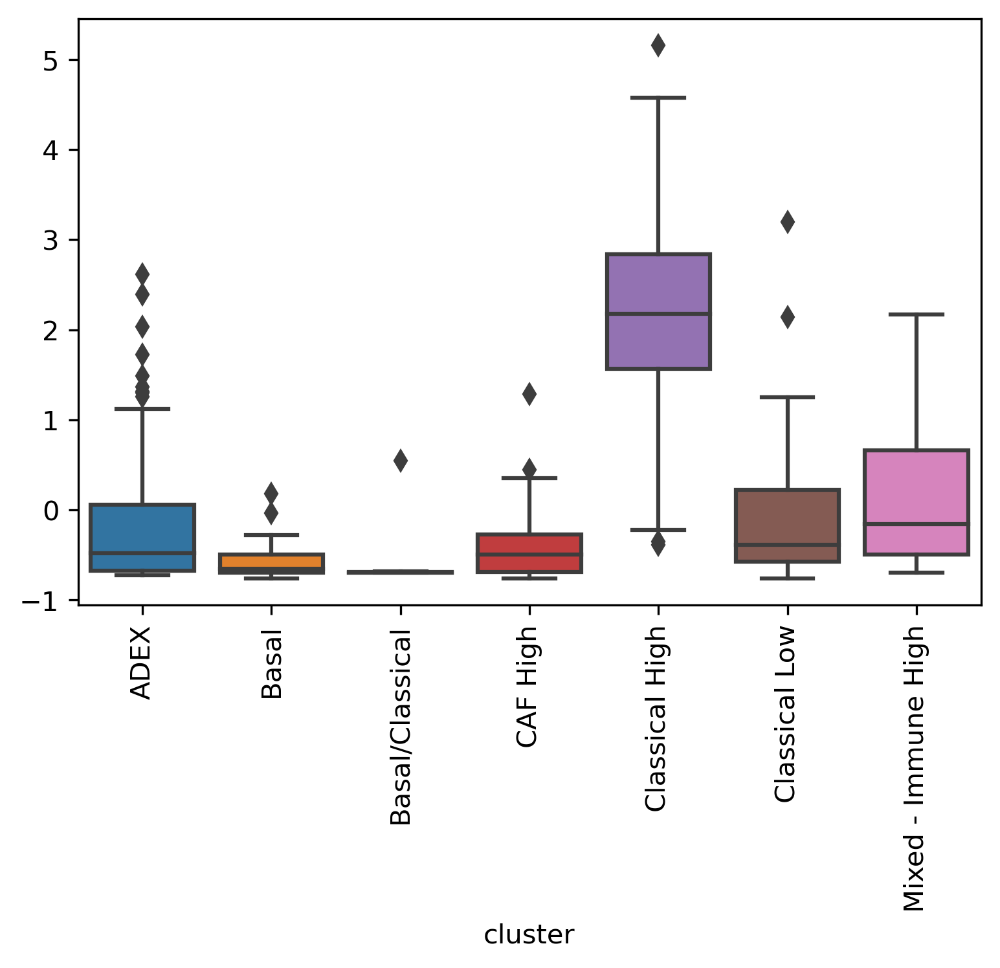

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


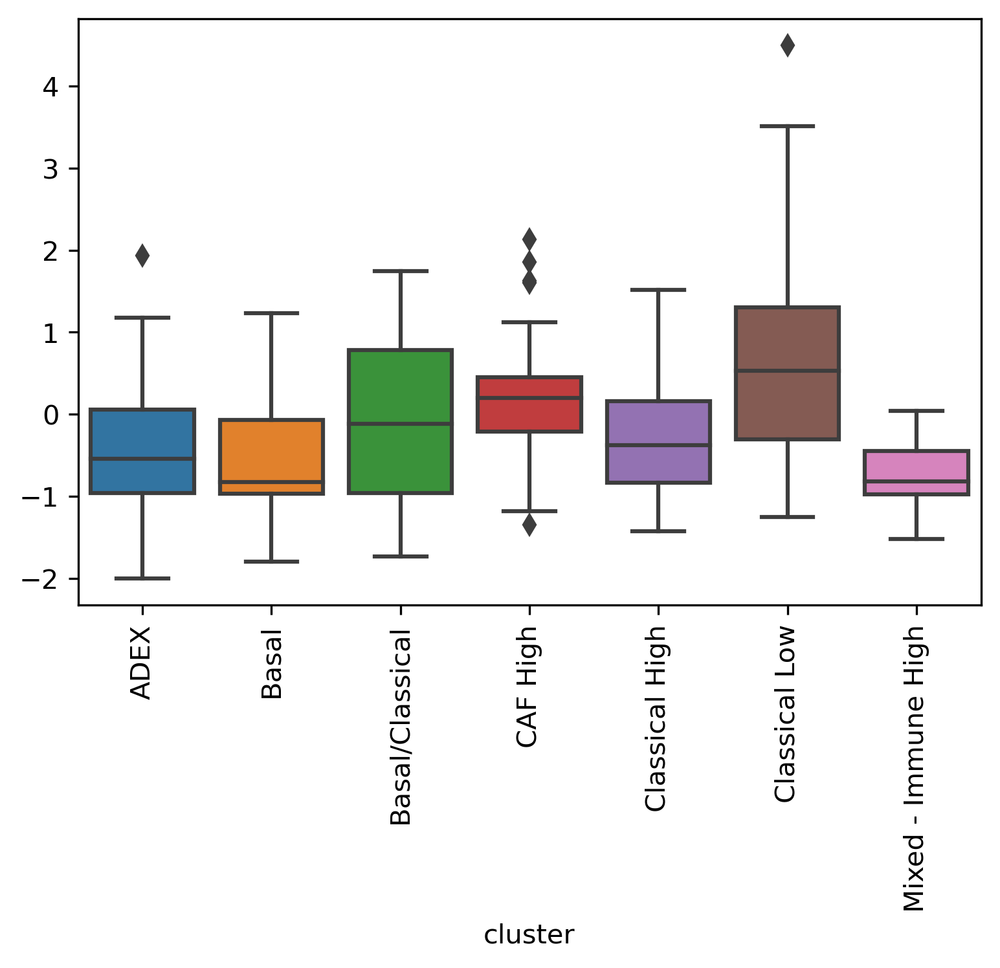

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


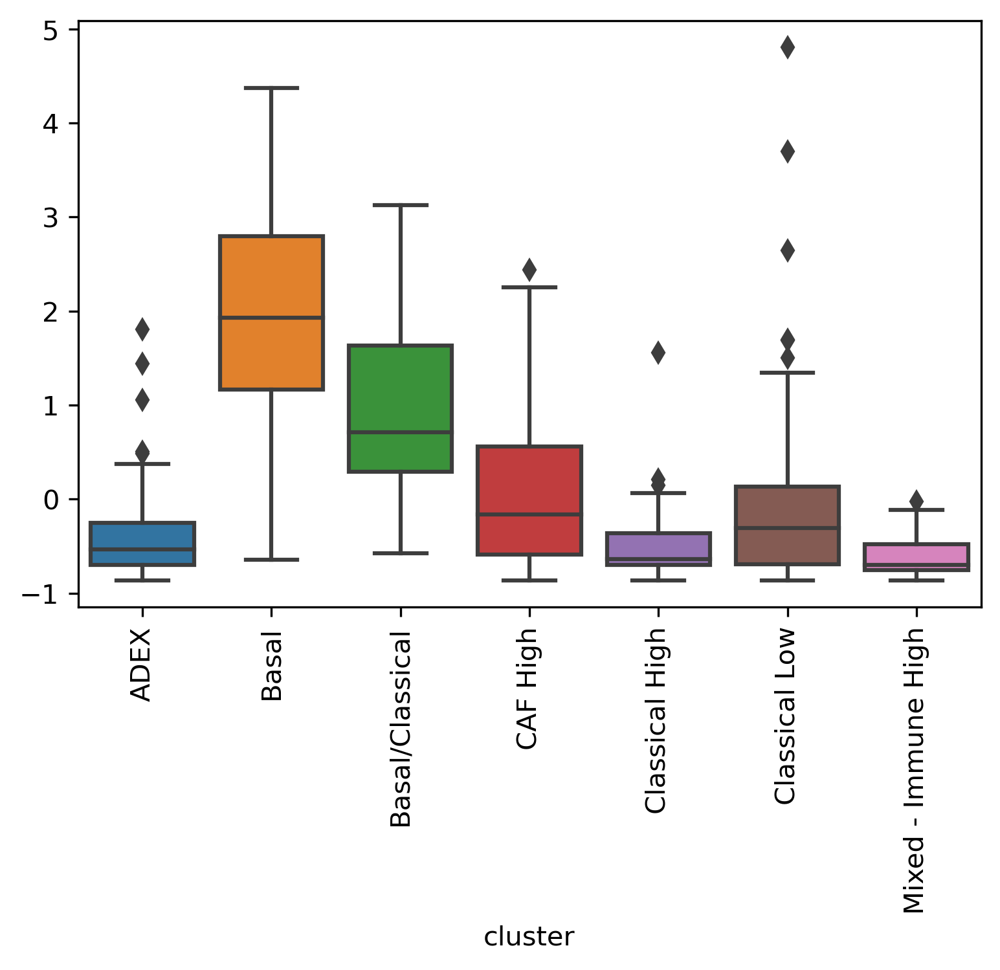

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


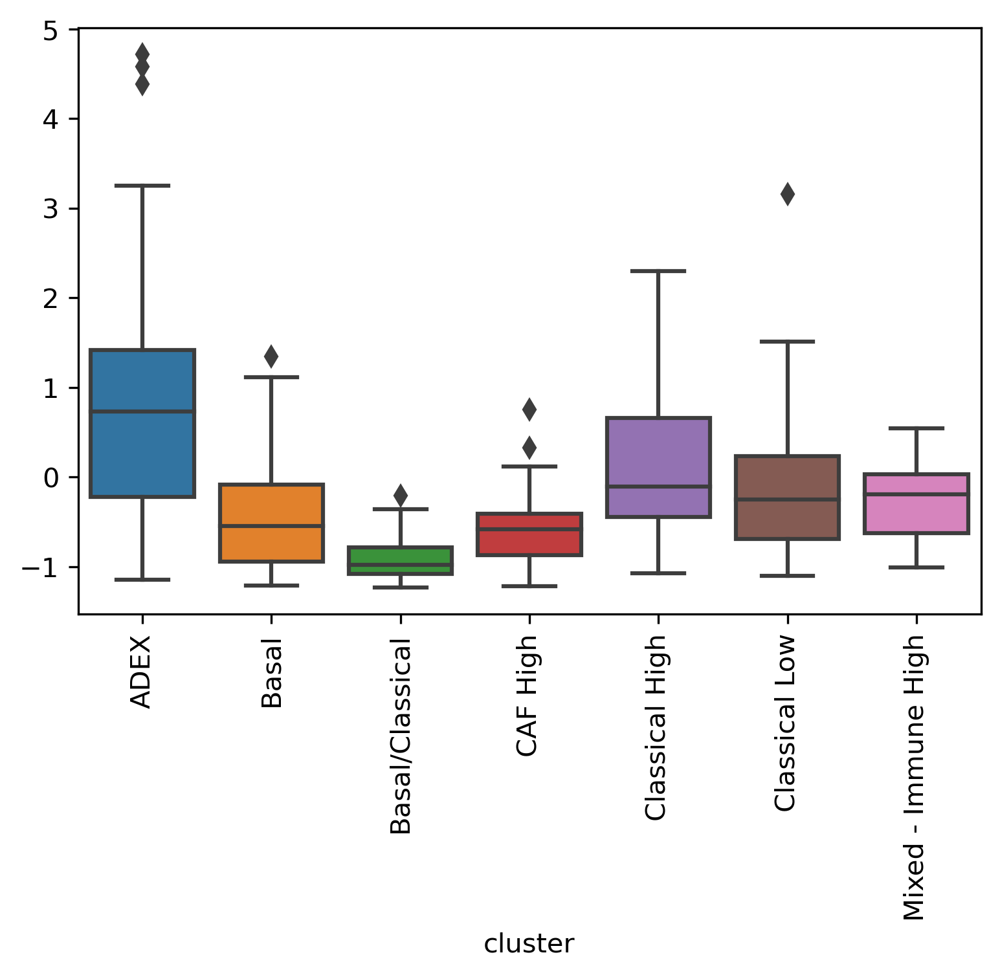

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


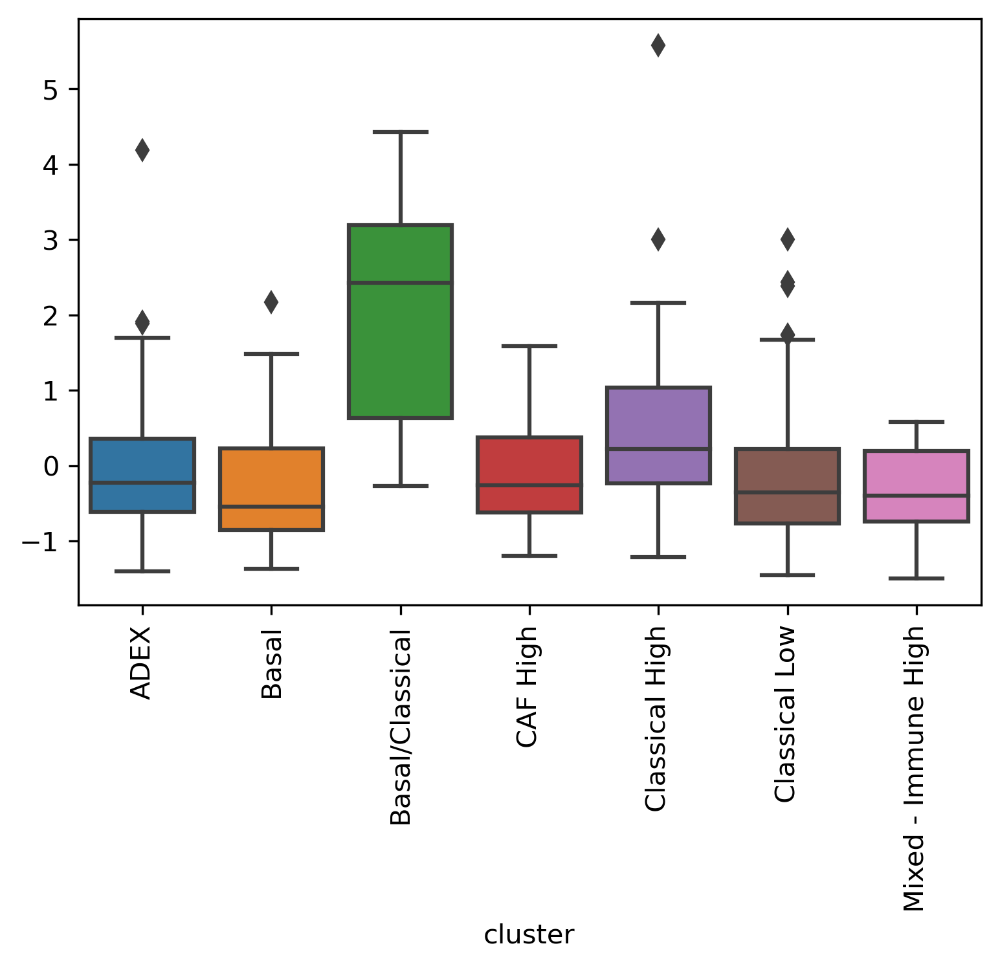

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


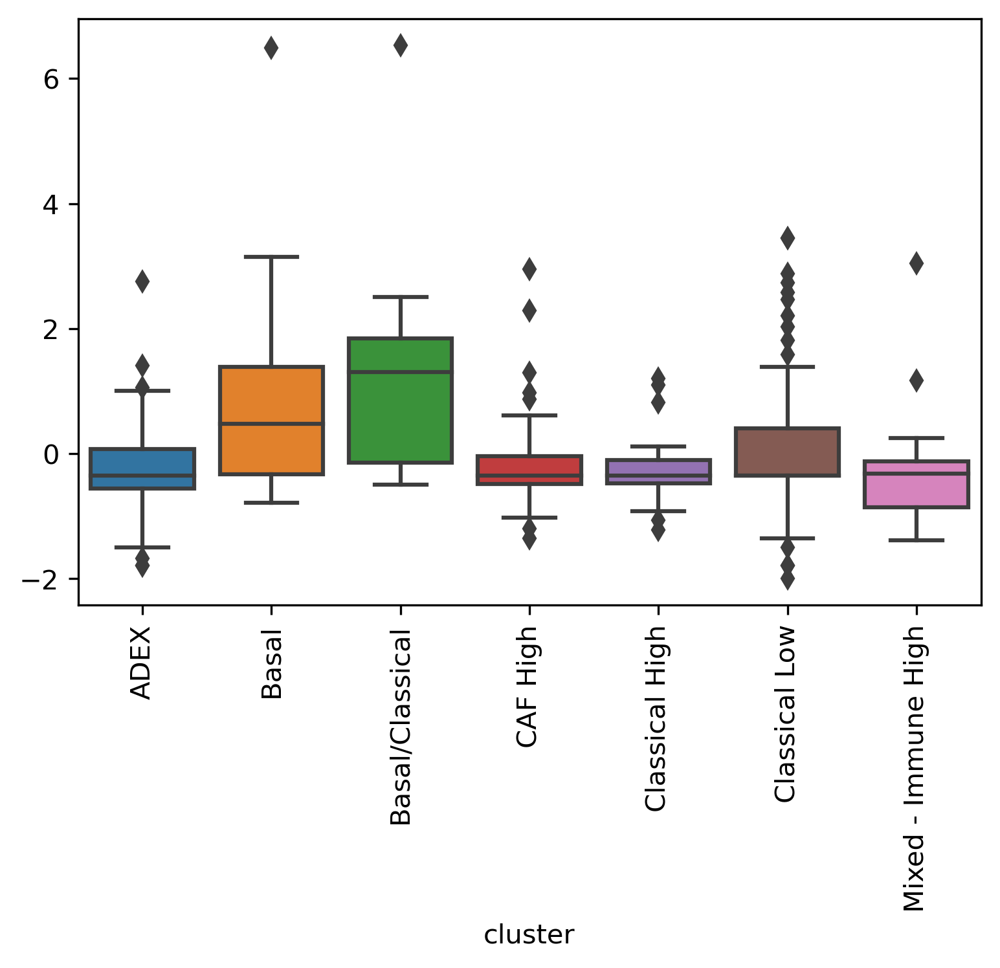

In [50]:
markers = ['Malignant - Classical High', 'Malignant - Classical Low', 'Malignant - Basal', 'Malignant - ADEX',
          'Malignant - Mixed', 'CD4/CD8 T cell - exhausted']
for marker in markers:
    fig, axs = plt.subplots(figsize=(6, 4))
    sns.boxplot(data=integrated.obs, x='cluster', y=integrated[:, marker].X.toarray().flatten())
    plt.xticks(rotation=90)
    plt.show()

In [51]:
sc.tl.rank_genes_groups(integrated, groupby='cluster', method='wilcoxon')

In [52]:
integrated.uns['rank_genes_groups'].keys()

dict_keys(['params', 'names', 'scores', 'pvals', 'pvals_adj', 'logfoldchanges'])

In [53]:
for cluster in sorted(set(integrated.obs['cluster'])):
    pvals = []
    for x in integrated.uns['rank_genes_groups']['pvals_adj'][cluster]:
        if x <= .05:
            pvals.append(x)
        else:
            break
    cell_types = integrated.uns['rank_genes_groups']['names'][cluster][:len(pvals)]
    for p, c in zip(pvals, cell_types): print(cluster, c, p)

ADEX Malignant - ADEX 2.7281468508994295e-13
ADEX CD8_T_cell 7.713131129758965e-08
ADEX Acinar 5.1623284148851025e-06
ADEX Monocyte 1.931229919917956e-05
ADEX Endothelial 0.0035545964987187284
Basal Malignant - Basal 2.1332632414580326e-12
Basal CD4/CD8 T cell - exhausted 0.0002925820276337441
Basal CAF 0.04701463017583578
Basal/Classical Malignant - Mixed 1.1911042052150612e-05
Basal/Classical Mast 6.638906022437551e-05
Basal/Classical Malignant - Basal 0.00010234267692064458
Basal/Classical CD4/CD8 T cell - exhausted 0.0012701510450974732
Basal/Classical CD4_T_cell 0.0012726659180996532
CAF High CAF 4.987241329033006e-25
Classical High Malignant - Classical High 6.7513175117038235e-18
Classical High Malignant - Mixed 0.0016443330157144638
Classical High DC 0.0016443330157144638
Classical Low Malignant - Classical Low 2.508136366710421e-14
Classical Low NK 2.5884810070286727e-08
Classical Low B_cell 0.00328272354015491
Classical Low Endothelial 0.03060996702772119
Mixed - Immune High 

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'ADEX'),
  Text(1, 0, 'Basal'),
  Text(2, 0, 'Basal/Classical'),
  Text(3, 0, 'CAF High'),
  Text(4, 0, 'Classical High'),
  Text(5, 0, 'Classical Low'),
  Text(6, 0, 'Mixed - Immune High')])

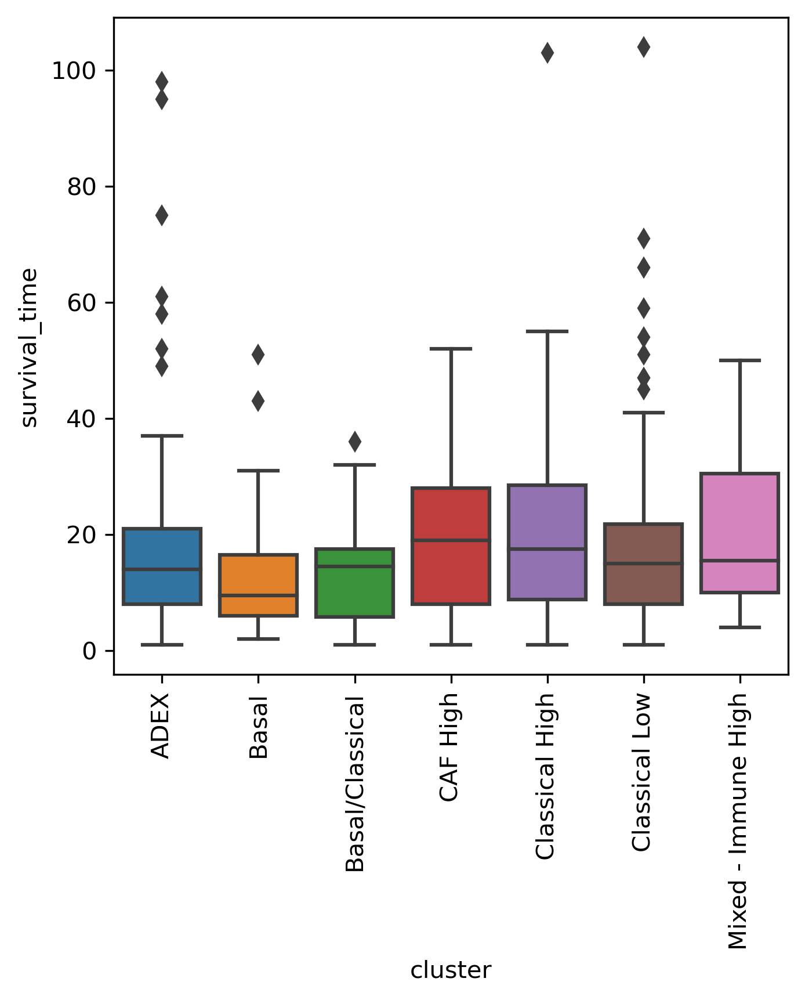

In [54]:
sns.boxplot(data=integrated.obs, x='cluster', y='survival_time')
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'ADEX'),
  Text(1, 0, 'Basal'),
  Text(2, 0, 'Basal/Classical'),
  Text(3, 0, 'CAF High'),
  Text(4, 0, 'Classical High'),
  Text(5, 0, 'Classical Low'),
  Text(6, 0, 'Mixed - Immune High')])

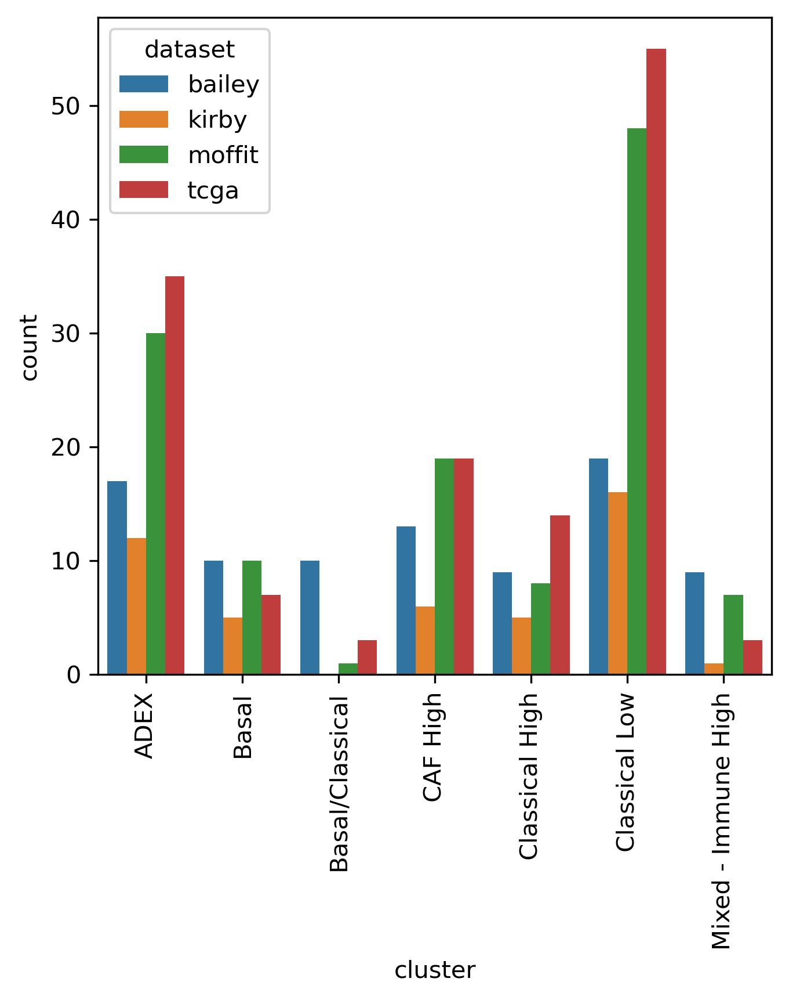

In [55]:
sns.countplot(data=integrated.obs, x='cluster', hue='dataset')
plt.xticks(rotation=90)

In [56]:
import lifelines
from lifelines.statistics import logrank_test
from lifelines import KaplanMeierFitter

In [57]:
integrated.obs['classification'] = ['Squamous' if x > .3 else 'Classical' for x in integrated[:, 'Malignant - Basal'].X.flatten()]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


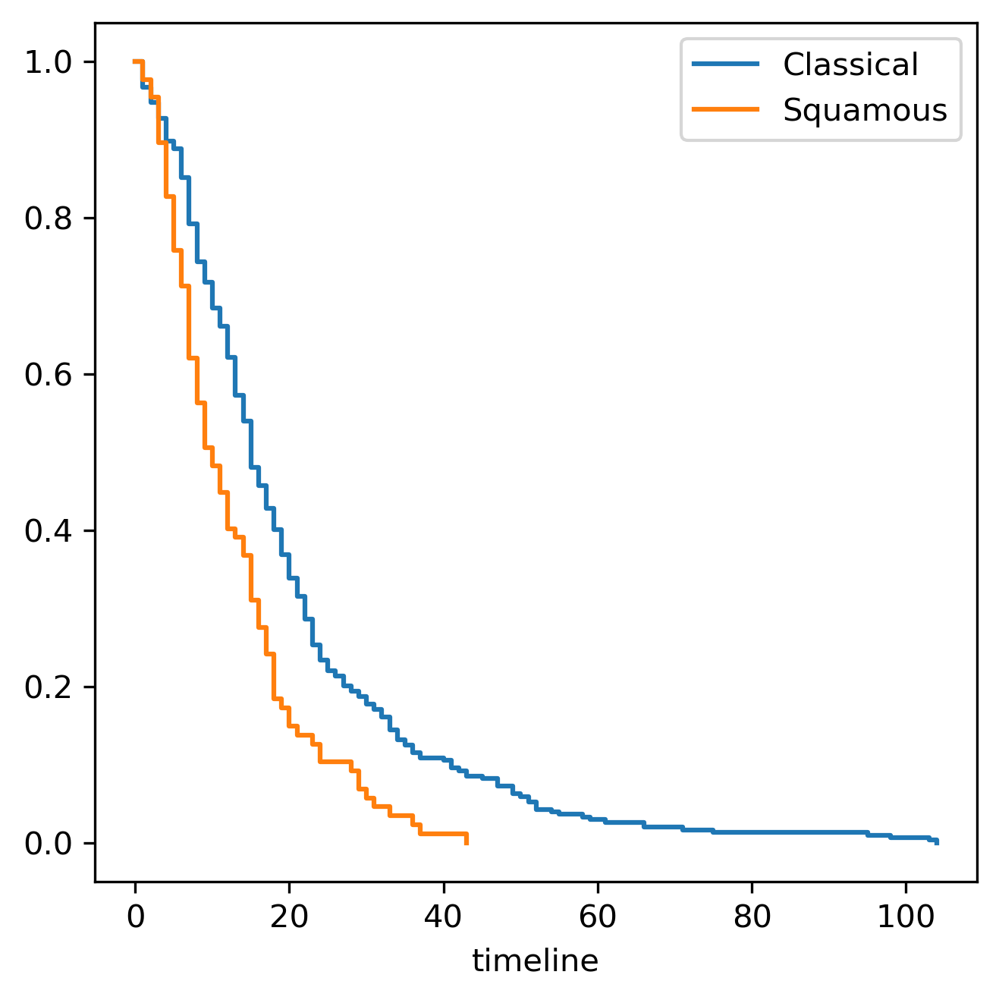

In [58]:
kmf = KaplanMeierFitter()
ft = integrated.obs.copy()
T = ft['survival_time']
E = ft['status']
ft['classification'] = integrated.obs['classification'].to_list()
groups = ft[f'classification']

for cluster in sorted(set(ft['classification'])): 
    kmf.fit(T[groups==cluster], E[groups==cluster], label=cluster)
    ax = kmf.plot(show_censors=True, ci_show=False, )

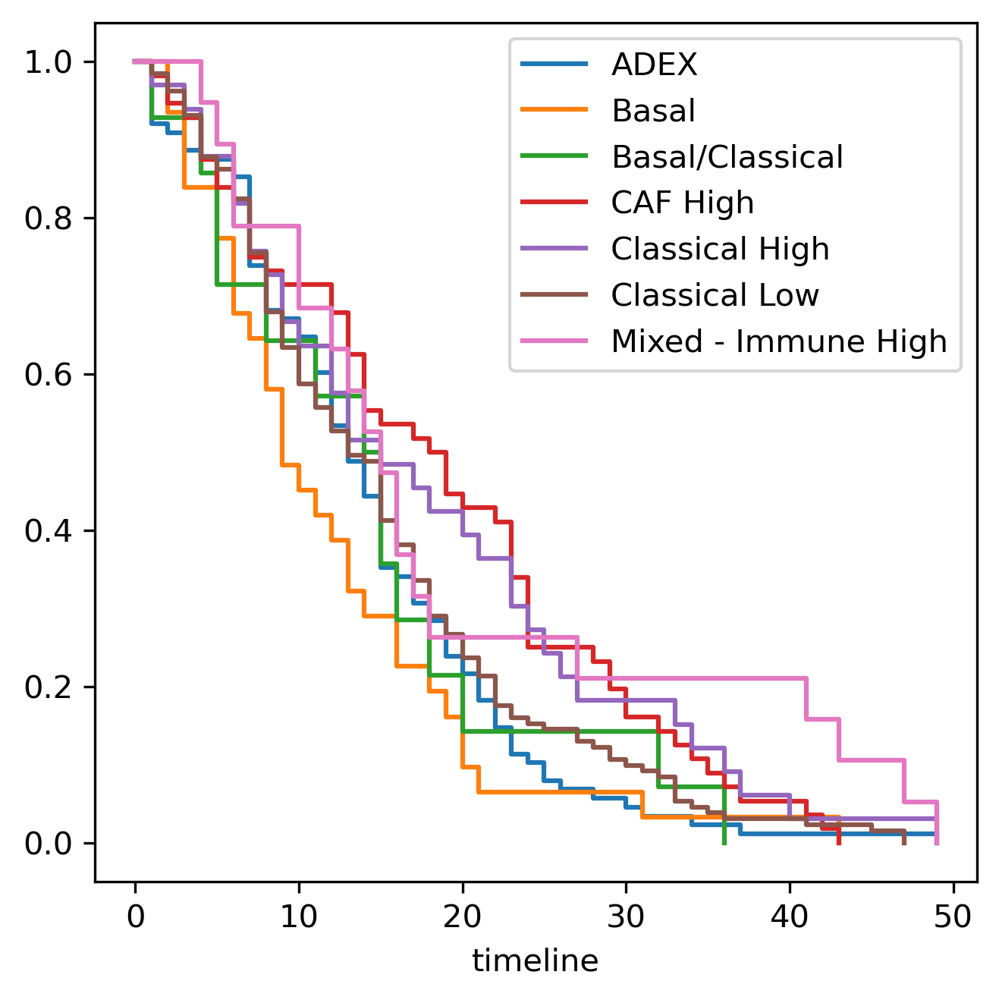

In [59]:
kmf = KaplanMeierFitter()
ft = integrated.obs.copy()
ft = ft[ft['survival_time']<50]
T = ft['survival_time']
E = ft['status']
groups = ft[f'cluster']

for cluster in sorted(set(ft['cluster'])): 
    kmf.fit(T[groups==cluster], E[groups==cluster], label=cluster)
    ax = kmf.plot(show_censors=True, ci_show=False,)
plt.savefig(os.path.join(save_dir, 'survival_all_communities.pdf'))

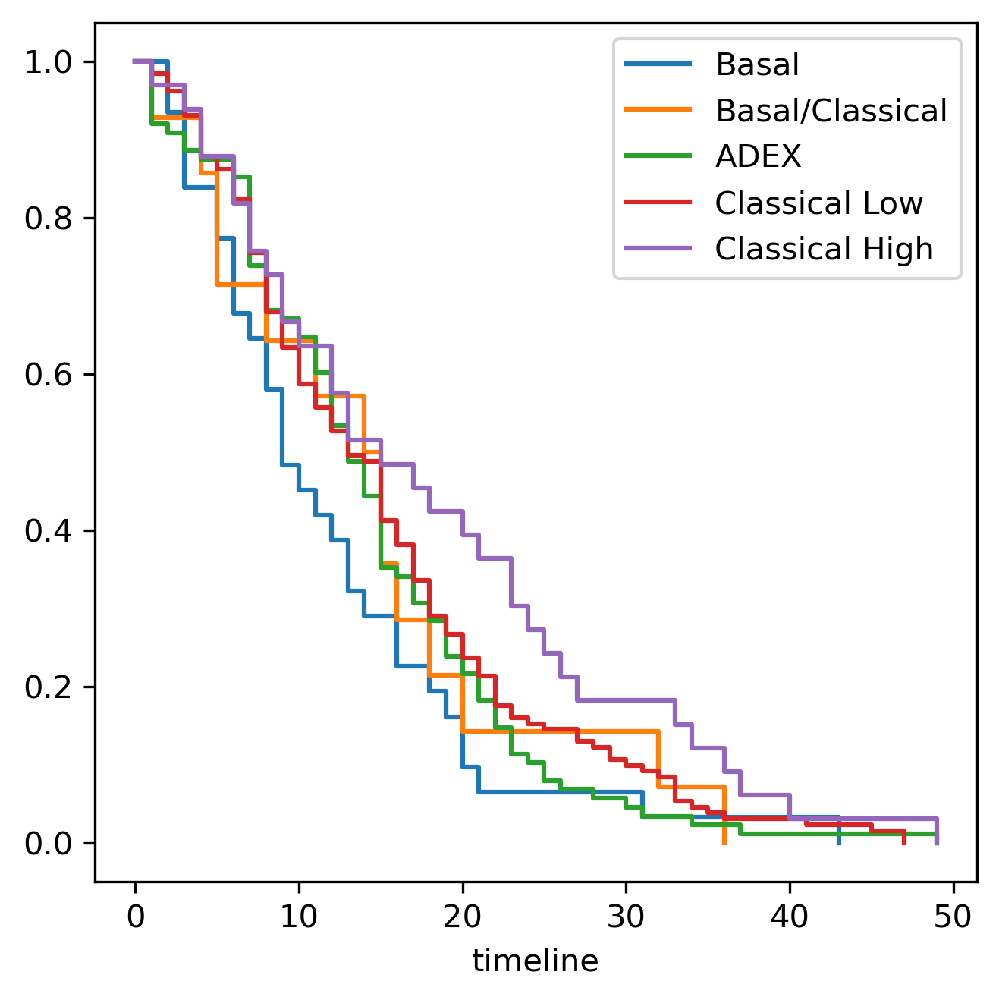

In [60]:
kmf = KaplanMeierFitter()
ft = integrated.obs.copy()
ft = ft[ft['survival_time']<50]
T = ft['survival_time']
E = ft['status']
groups = ft[f'cluster']

clusters = ['Basal', 'Basal/Classical', 'ADEX', 'Classical Low', 'Classical High']
for cluster in clusters: 
    kmf.fit(T[groups==cluster], E[groups==cluster], label=cluster)
    ax = kmf.plot(show_censors=True, ci_show=False,)
plt.savefig(os.path.join(save_dir, 'survival_tumor_communities only.pdf'))

In [61]:
result = lifelines.statistics.pairwise_logrank_test(ft['survival_time'], ft['cluster'], ft['status'])
result.print_summary()

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
                                     test_statistic    p  -log2(p)
ADEX            Basal                          1.69 0.19      2.37
                Basal/Classical                0.02 0.89      0.17
                CAF High                       7.24 0.01      7.13
                Classical High                 3.95 0.05      4.42
                Classical Low                  0.54 0.46      1.11
                Mixed - Immune High            2.73 0.10      3.35
Basal           Basal/Classical                0.46 0.50      1.00
                CAF High                       7.13 0.01      7.05
                Classical High                 4.93 0.03      5.25
                Classical Low                  3.28 0.07      3.83
                Mixed - Immune High            4.00 0.05      4.46
Basal/Classical CAF High                       1.81 0.18      2.48
                Classical High                 1.31 0.25      1.99
                Classical Low                  0.08 0.77      0.37
                Mixed - Immune High            1.39 0.24      2.06
CAF High        Classical High                 0.00 0.97      0.05
                Classical Low                  3.40 0.07      3.94
                Mixed - Immune High            0.69 0.41      1.30
Classical High  Classical Low                  2.36 0.12      3.00
                Mixed - Immune High            0.36 0.55      0.87
Classical Low   Mixed - Immune High            2.63 0.10      3.25

In [115]:
ft = integrated.obs.copy()
ft

,age,gender,race,tumor_stage,survival_time,status,dataset,Malignant_0_tumor_fraction,Malignant_1_tumor_fraction,Malignant_2_tumor_fraction,Malignant_3_tumor_fraction,Malignant_4_tumor_fraction,leiden,cluster,classification
SA518851,67.0,male,unknown,unknown,5,2,bailey,0.067734,0.000000,0.770468,0.127692,0.034106,4,Basal,Squamous
SA528766,61.0,female,unknown,unknown,8,2,bailey,0.548283,0.039154,0.202108,0.000000,0.210455,0,Classical Low,Classical
SA528763,52.0,male,unknown,unknown,36,2,bailey,0.843169,0.095722,0.000000,0.000000,0.061109,2,CAF High,Classical
SA518854,55.0,male,unknown,unknown,5,1,bailey,0.588064,0.000000,0.204188,0.133946,0.073802,2,CAF High,Classical
SA518806,51.0,female,unknown,unknown,14,2,bailey,0.629661,0.017354,0.246252,0.034876,0.071858,2,CAF High,Classical
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T_11_02_A148a,68.0,male,white,unknown,20,2,kirby,0.414887,0.240987,0.067763,0.186472,0.089891,0,Classical Low,Classical
T_11_04_A026b,64.0,female,white,unknown,49,1,kirby,0.498230,0.130810,0.067889,0.080138,0.222934,5,Mixed - Immune High,Classical
T_11_05_A018b,76.0,male,white,unknown,36,2,kirby,0.358808,0.379275,0.076582,0.025945,0.159389,6,Classical High,Classical
T_11_06_A011a,68.0,female,white,unknown,10,2,kirby,0.617157,0.000000,0.165348,0.108672,0.108823,0,Classical Low,Classical


In [64]:
df = ft[['survival_time', 'status']]
df['status'] = [x - 1 for x in df['status']]
df['Basal'] = [1 if x == 'Basal' else 0 for x in ft['cluster']]
df

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,survival_time,status,Basal
SA518851,5,1,1
SA528766,8,1,0
SA528763,36,1,0
SA518854,5,0,0
SA518806,14,1,0
...,...,...,...
T_11_02_A148a,20,1,0
T_11_04_A026b,49,0,0
T_11_05_A018b,36,1,0
T_11_06_A011a,10,1,0


In [66]:
from lifelines import CoxPHFitter
cph = CoxPHFitter()
cph.fit(df, duration_col='survival_time', event_col='status')

cph.print_summary()

<lifelines.CoxPHFitter: fitted with 391 total observations, 134 right-censored observations>
             duration col = 'survival_time'
                event col = 'status'
      baseline estimation = breslow
   number of observations = 391
number of events observed = 257
   partial log-likelihood = -1320.05
         time fit was run = 2021-10-06 15:09:20 UTC

---
            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                         
Basal       0.58       1.78       0.21             0.16             0.99                 1.18                 2.69

             z    p   -log2(p)
covariate                     
Basal     2.73 0.01       7.30
---
Concordance = 0.53
Partial AIC = 2642.11
log-likelihood ratio test = 6.41 on 1 df
-log2(p) of ll-ratio test = 6.46

In [118]:
result = None
cs = ['ADEX', 'Basal', 'Basal/Classical', 'Classical Low', 'Classical High']
for community in cs:
    ft = integrated.obs.copy()
    df = ft[['survival_time', 'status']]
    df['status'] = [x - 1 for x in df['status']]
    df[community] = [1 if x == community else 0 for x in ft['cluster']]
    
    cph = CoxPHFitter()
    cph.fit(df, duration_col='survival_time', event_col='status')
    r = cph.summary[['coef', 'z', 'p', '-log2(p)']]
    if result is None:
        result = r
    else:
        result = pd.concat((result, r))
result
    

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

,coef,z,p,-log2(p)
covariate,,,,
ADEX,0.018846,0.127984,0.898162,0.154953
Basal,0.576862,2.729583,0.006341,7.300970
Basal/Classical,0.524049,1.767743,0.077104,3.697052
Classical Low,0.105996,0.819348,0.412588,1.277226
Classical High,-0.258500,-1.179852,0.238059,2.070609


In [117]:
result = None
cs = ['ADEX', 'Basal', 'Basal/Classical', 'Classical Low', 'Classical High']
for d in 
for community in cs:
    ft = integrated.obs.copy()
    ft = ft[ft['dataset']=='bailey']
    df = ft[['survival_time', 'status']]
    df['status'] = [x - 1 for x in df['status']]
    df[community] = [1 if x == community else 0 for x in ft['cluster']]
    
    cph = CoxPHFitter()
    cph.fit(df, duration_col='survival_time', event_col='status')
    r = cph.summary[['coef', 'z', 'p', '-log2(p)']]
    if result is None:
        result = r
    else:
        result = pd.concat((result, r))
result
    

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice f

,coef,z,p,-log2(p)
covariate,,,,
ADEX,-0.826635,-1.900159,0.057412,4.122496
Basal,1.102601,2.611405,0.009017,6.793122
Basal/Classical,0.836643,2.359331,0.018308,5.771389
Classical Low,0.511655,1.611490,0.107073,3.223334
Classical High,-0.269910,-0.572578,0.566930,0.818756


In [92]:
source = result.sort_values('z')
source['Community'] = source.index.to_list()
c = alt.Chart(source).mark_bar().encode(
    y=alt.Y('Community', sort='-color'),
    x=alt.X('-log2(p)'),
    color=alt.Color('z', scale=alt.Scale(scheme='redblue', domain=[-2.5, 2.5]))
)
line = alt.Chart(pd.DataFrame({'x': [4.32]})).mark_rule(color='gray', strokeDash=[4,1]).encode(x='x')

c + line

alt.LayerChart(...)

In [85]:
integrated.X.shape

(391, 21)

In [100]:
??sc.pl.matrixplot

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


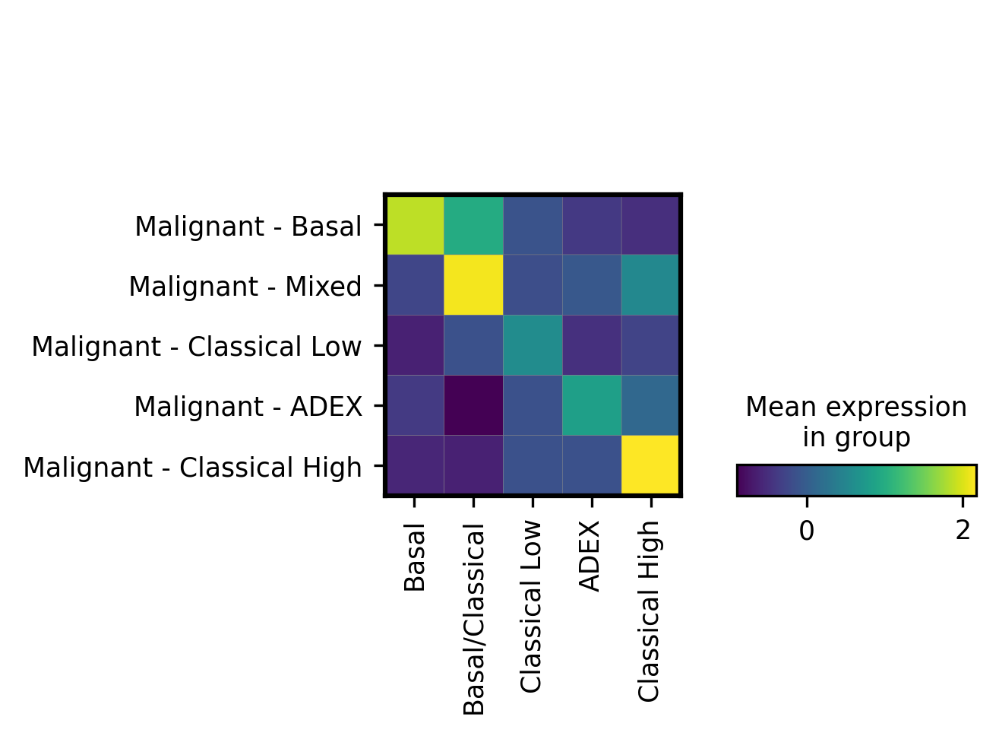

In [111]:
order = ['Basal', 'Basal/Classical', 'Classical Low', 'ADEX', 'Classical High']
cts = ['Malignant - Basal', 'Malignant - Mixed', 'Malignant - Classical Low', 'Malignant - ADEX', 'Malignant - Classical High']
sc.pl.matrixplot(integrated[[True if c in order else False for c in integrated.obs['cluster']]],
                 groupby='cluster', var_names=cts, swap_axes=True, categories_order=order,
                 save='_malignant_continoum_heatmap.pdf')

## eus pseudo-bulk analysis

In [7]:
adata = sc.read_h5ad('../backups/final_adata.h5ad')
eus = adata[adata.obs['dataset']=='In-house: EUS-FNB']
eus

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 28313 × 30840
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_SCT', 'nFeature_SCT', 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'integrated_snn_res.1.25', 'seurat_clusters', 'integrated_snn_res.2', 'integrated_snn_res.3', 'integrated_snn_res.1', 'integrated_snn_res.0.5', 'active.ident', 'cell_type', 'dataset', 'sample_id', 'cell_type_level_2', 'cell_type_level_3', 'tumor_original_seurat', 'malignant_exclude', 'final_cell_types'
    var: 'is_highly_variable'
    uns: 'cell_type_colors', 'cell_type_level_2_colors', 'cell_type_level_3_colors', 'dataset_colors', 'final_cell_types_colors', 'rank_genes_groups'
    obsm: 'X_umap'
    layers: 'counts'

In [8]:
deconv = pd.read_csv('../data/pdac/cibersortx_eus_pseudo_bulk_fractions.txt', sep='\t', index_col=0)
deconv

,Acinar,B cell,CAF,CD4 T cell,CD8 T cell,CD4/CD8 T cell - exhausted,DC,Endothelial,Erythrocyte,Malignant - Classical Low,Malignant - Classical High,Malignant - Basal,Malignant - Mixed,Malignant - ADEX,Mast,Monocyte,NK,Plasma,Stellate,Treg
Mixture,,,,,,,,,,,,,,,,,,,,
wu01,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,0.000045,0.043452,0.000265,0.000000,0.009412,0.010570,0.013547,0.132944,0.264703,0.091824,0.009195,0.007145,0.000000
wu02,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,0.005196,0.027542,0.044176,0.005867,0.036678,0.019382,0.016462,0.096006,0.173096,0.068045,0.005937,0.013414,0.000000
wu03,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,0.000357,0.085153,0.240589,0.089277,0.043232,0.000000,0.018073,0.116379,0.136612,0.065944,0.000000,0.000000,0.000000
wu04,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,0.000144,0.026369,0.396892,0.078613,0.086102,0.014312,0.025741,0.155164,0.000000,0.047345,0.000000,0.000000,0.000000
wu05,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,0.000090,0.038782,0.304592,0.235928,0.038195,0.000000,0.000000,0.124495,0.042597,0.029725,0.000000,0.000000,0.027636
wu07,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,0.000167,0.041239,0.003575,0.000000,0.090906,0.019562,0.012611,0.060304,0.237366,0.074038,0.008147,0.000000,0.000000
wu09,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,0.000449,0.005197,0.341057,0.232545,0.066440,0.000000,0.021777,0.110109,0.000000,0.045246,0.000000,0.000000,0.097969
wu14,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,0.000013,0.023542,0.048796,0.170466,0.033170,0.041673,0.015176,0.061344,0.103104,0.044053,0.001011,0.070129,0.000000
wu15,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,0.000021,0.009178,0.016373,0.015054,0.014617,0.013732,0.027301,0.004317,0.020724,0.069362,0.005112,0.000000,0.010037


In [9]:
freq = pd.crosstab(eus.obs['sample_id'], eus.obs['final_cell_types'])
freq = freq.sort_values(['Malignant - Basal'], ascending=False)
fractions = pd.DataFrame(data=freq.values / freq.values.sum(axis=1).reshape((-1, 1)),
                         columns=list(freq.columns), index=freq.index.to_list())
fractions['Stellate'] = fractions[['Stellate 1', 'Stellate 2']].values.sum(axis=1).flatten()
fractions = fractions[[c for c in fractions.columns if 'Stellate 1'!=c and 'Stellate 2'!=c]]
fractions = fractions.loc[deconv.index.to_list(), deconv.columns]
fractions

,Acinar,B cell,CAF,CD4 T cell,CD8 T cell,CD4/CD8 T cell - exhausted,DC,Endothelial,Erythrocyte,Malignant - Classical Low,Malignant - Classical High,Malignant - Basal,Malignant - Mixed,Malignant - ADEX,Mast,Monocyte,NK,Plasma,Stellate,Treg
wu01,0.000000,0.035883,0.208687,0.005666,0.015109,0.000000,0.050992,0.000944,0.000944,0.037771,0.006610,0.012276,0.006610,0.002833,0.025496,0.501416,0.032106,0.026440,0.025496,0.004721
wu02,0.000000,0.062751,0.071787,0.007530,0.013554,0.000502,0.126506,0.006024,0.000000,0.091365,0.034639,0.094378,0.018072,0.000502,0.006526,0.396084,0.008032,0.013554,0.045683,0.002510
wu03,0.000000,0.002324,0.000581,0.024985,0.066241,0.012783,0.001743,0.002905,0.017432,0.291691,0.183614,0.004067,0.009297,0.011621,0.006973,0.314933,0.042417,0.003486,0.000581,0.002324
wu04,0.000000,0.000000,0.026549,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.725664,0.168142,0.017699,0.017699,0.008850,0.000000,0.008850,0.026549,0.000000,0.000000,0.000000
wu05,0.000000,0.000000,0.001451,0.010160,0.002903,0.000000,0.000000,0.000000,0.000000,0.611030,0.296081,0.018868,0.013062,0.000000,0.001451,0.036284,0.001451,0.001451,0.002903,0.002903
wu07,0.000501,0.089384,0.030796,0.105158,0.030045,0.004757,0.088883,0.000501,0.000000,0.061592,0.015273,0.122684,0.050826,0.005508,0.007011,0.335253,0.022534,0.011267,0.008262,0.009765
wu09,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.660870,0.278261,0.000000,0.017391,0.017391,0.000000,0.026087,0.000000,0.000000,0.000000,0.000000
wu14,0.000000,0.017544,0.416876,0.037594,0.061821,0.001671,0.023392,0.000000,0.000000,0.101086,0.161236,0.000000,0.004177,0.000000,0.000000,0.111947,0.013367,0.001671,0.039265,0.008354
wu15,0.001727,0.112263,0.007772,0.468048,0.088946,0.000864,0.042314,0.000864,0.000000,0.033679,0.006045,0.000864,0.001727,0.025907,0.000864,0.163212,0.018135,0.006045,0.006045,0.014680
wu16,0.004882,0.020417,0.004439,0.109188,0.031514,0.000000,0.014203,0.000444,0.552597,0.012428,0.001332,0.001332,0.012428,0.038615,0.000444,0.165557,0.002663,0.000444,0.021749,0.005326


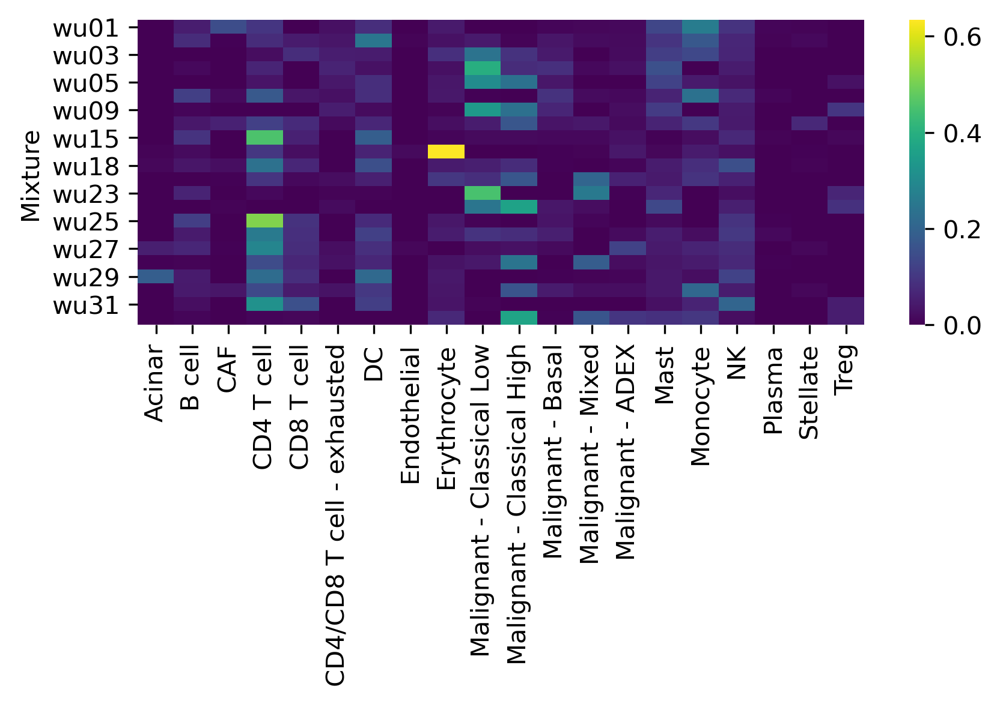

In [32]:
sns.heatmap(deconv, cmap='viridis')
plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'pseudo_cx_deconv_heatmap.pdf'))

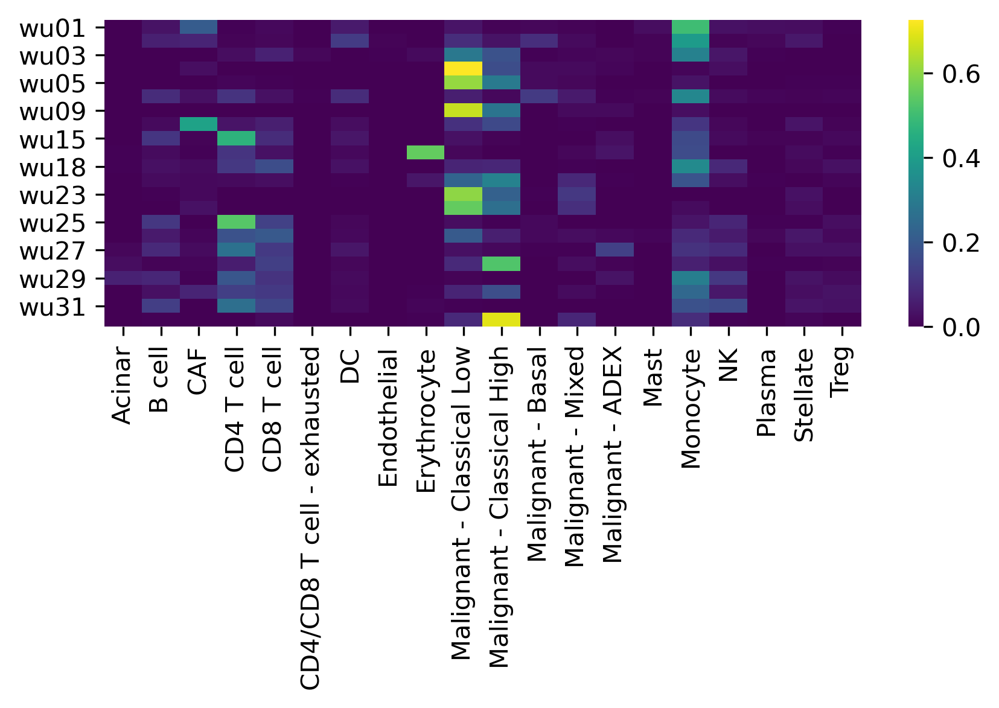

In [34]:
sns.heatmap(fractions, cmap='viridis')
plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'pseudo_sc_fractions_heatmap.pdf'))

In [16]:
fractions.melt()

,variable,value
0,Acinar,0.000000
1,Acinar,0.000000
2,Acinar,0.000000
3,Acinar,0.000000
4,Acinar,0.000000
...,...,...
435,Treg,0.008285
436,Treg,0.022000
437,Treg,0.034066
438,Treg,0.031765


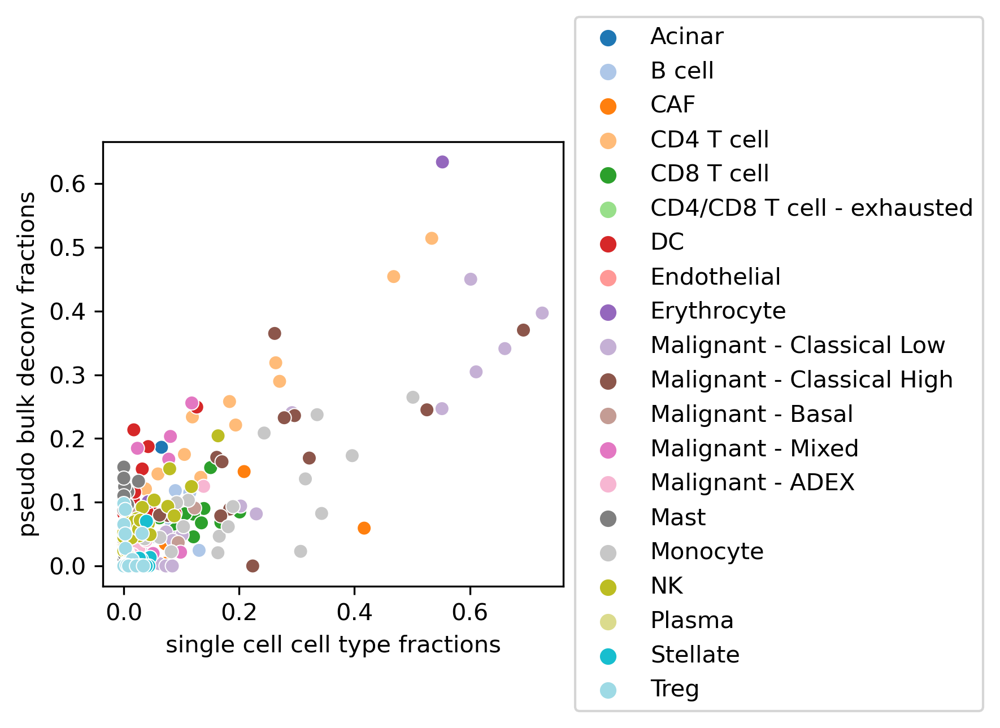

In [25]:
pdf = pd.DataFrame.from_dict({
    'single cell cell type fractions': fractions.melt()['value'].to_list(),
    'pseudo bulk deconv fractions': deconv.melt()['value'].to_list(),
    'cell_type': fractions.melt()['variable'].to_list()
})
sns.scatterplot(data=pdf, x='single cell cell type fractions', y='pseudo bulk deconv fractions',
            hue='cell_type', palette='tab20')

# Put a legend to the right of the current axis
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.tight_layout()

plt.savefig(os.path.join(save_dir, 'pseudo_deconv_correlation_by_cell_type.pdf'))

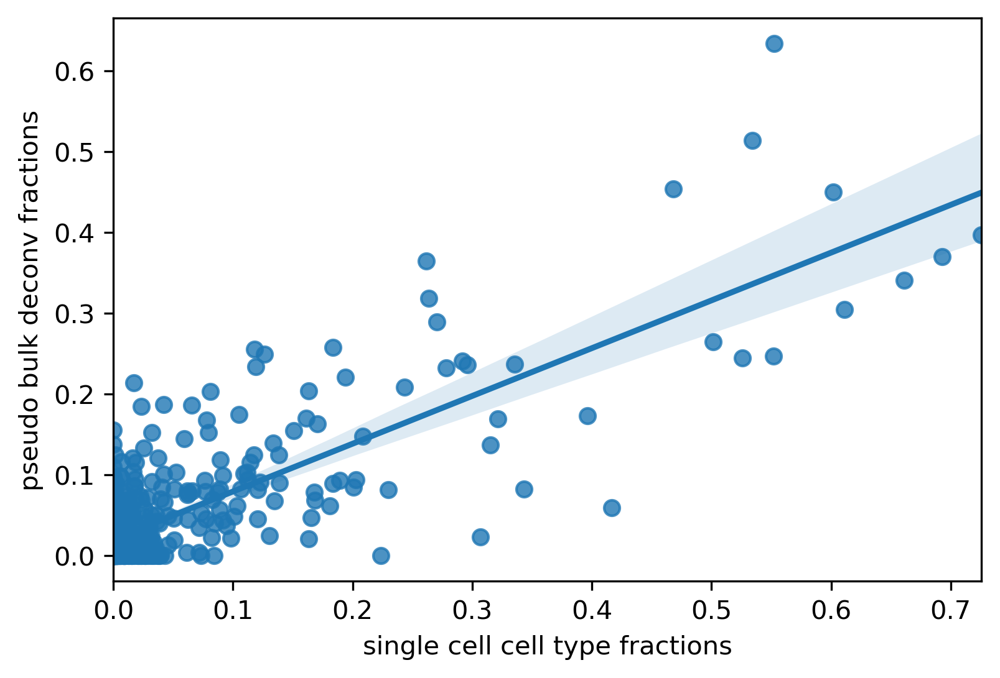

In [26]:
sns.regplot(data=pdf, x='single cell cell type fractions', y='pseudo bulk deconv fractions')
plt.savefig(os.path.join(save_dir, 'pseudo_deconv_correlation_reg_line.pdf'))

In [137]:
scipy.stats.spearmanr(pdf['single cell cell type fractions'], pdf['pseudo bulk deconv fractions'])

SpearmanrResult(correlation=0.5375767131168729, pvalue=2.5648989034318034e-34)

In [29]:
clinical = pd.read_csv('../data/pdac/eus_clinical_formatted.txt', sep='\t', index_col=0)
clinical

,Patient/Sample ID,1-liner,Sample/Biopsy Date,Gender,Age,Ethnicity,Patient being followed at Wash U?,Stage (AJCC 8),T,N,...,Dz Progression?,Prog date or last imaging f/u,PFS time (mo),Died?,Death date or last clinical f/u,OS time (mo),Notes,Unnamed: 42,overall_survival,status
wu01,WU001,NaN,2/4/19,Female,61.0,White,No,NaN,3.0,0,...,peritoneal metastasis,2/5/19,NaN,Yes,4/9/19,NaN,No clinical follow up at WashU,NaN,2.0,Dead
wu02,WU002,NaN,2/4/19,Female,90.0,White,No,NaN,3.0,1,...,mass tethers the small bowel,2/21/19,NaN,Yes,4/3/19,NaN,Final note in pt's chart states to cancel all ...,NaN,1.0,Dead
wu03,WU003,NaN,3/5/19,Female,71.0,White,No,NaN,2.0,1,...,enlarged nodes suspicious for mets,3/11/19,NaN,Yes,4/3/19,NaN,Last note in pt's chart states pt had stroke a...,NaN,0.0,Dead
wu04,WU004,NaN,3/22/19,Male,72.0,White,Yes,NaN,2.0,1,...,NaN,10/16/19,NaN,Yes,12/9/20,NaN,Final note says patient passed away in his hom...,NaN,20.0,Dead
wu05,WU005,NaN,3/27/19,Female,74.0,White,Yes,NaN,3.0,0,...,no evidence of residual mets,10/14/19,NaN,NaN,3/4/22,NaN,Still alive as of 3/4/22,NaN,35.0,Alive
wu06,WU006,NaN,3/29/19,Female,60.0,White,Yes,NaN,2.0,1,...,"no, stable",10/22/19,NaN,Yes,3/18/20,NaN,Encounter in chart shows that patient passed a...,NaN,11.0,Dead
wu07,WU007,NaN,5/3/19,Male,80.0,White,No,NaN,3.0,0,...,terminal,10/1/19,NaN,Yes,10/1/19,NaN,Pt died at home on hospice,NaN,5.0,Dead
wu08,WU008,NaN,5/14/19,Female,71.0,White,No,NaN,1.0,0,...,NaN,6/13/19,NaN,Yes,8/10/19,NaN,No follow up at WashU,NaN,2.0,Dead
wu09,WU009,NaN,5/17/19,Female,80.0,White,Yes,NaN,2.0,1,...,No mets,7/29/19,NaN,Yes,1/14/20,NaN,NaN,NaN,8.0,Dead
wu10,WU010,NaN,8/1/19,Male,66.0,White,Yes,NaN,2.0,x,...,Stable,8/23/19,NaN,NaN,3/4/22,NaN,Still alive as of 3/4/22,NaN,31.0,Alive


In [27]:
integrated = sc.read_h5ad('../results/survival/03102022/integrated_with_eusfnb_pseudo.h5ad')
integrated

AnnData object with n_obs × n_vars = 413 × 20
    obs: 'leiden', 'dataset', 'cluster', 'community'
    uns: 'cluster_colors', 'community_colors', 'dataset_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'

In [28]:
pseudo_only = integrated[integrated.obs['dataset']=='eus pseudo']
pseudo_only

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 22 × 20
    obs: 'leiden', 'dataset', 'cluster', 'community'
    uns: 'cluster_colors', 'community_colors', 'dataset_colors', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'

In [45]:
df = clinical[['overall_survival', 'status']]
df['community'] = [pseudo_only.obs.loc[s, 'community'] if s in pseudo_only.obs.index else np.nan
                   for s in df.index.to_list()]
df = df[~pd.isnull(df['community'])]
df

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,overall_survival,status,community
wu01,2.0,Dead,CAF High
wu02,1.0,Dead,Basal
wu03,0.0,Dead,Classical Low
wu04,20.0,Dead,Classical Low
wu05,35.0,Alive,Classical Low
wu07,5.0,Dead,Basal
wu09,8.0,Dead,Classical Low
wu14,29.0,Alive,Mixed - Immune High
wu15,29.0,Alive,Classical Low
wu16,7.0,Dead,Classical Low


In [48]:
temp = deconv.copy()
temp.columns = [f'CIBERSORTx {s} fraction' for s in temp.columns]
df = pd.merge(df, temp, how='left', left_index=True, right_index=True)
df

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,CIBERSORTx Malignant - Classical High fraction,CIBERSORTx Malignant - Basal fraction,CIBERSORTx Malignant - Mixed fraction,CIBERSORTx Malignant - ADEX fraction,CIBERSORTx Mast fraction,CIBERSORTx Monocyte fraction,CIBERSORTx NK fraction,CIBERSORTx Plasma fraction,CIBERSORTx Stellate fraction,CIBERSORTx Treg fraction
wu01,2.0,Dead,CAF High,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,...,0.000000,0.009412,0.010570,0.013547,0.132944,0.264703,0.091824,0.009195,0.007145,0.000000
wu02,1.0,Dead,Basal,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,...,0.005867,0.036678,0.019382,0.016462,0.096006,0.173096,0.068045,0.005937,0.013414,0.000000
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,0.089277,0.043232,0.000000,0.018073,0.116379,0.136612,0.065944,0.000000,0.000000,0.000000
wu04,20.0,Dead,Classical Low,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,...,0.078613,0.086102,0.014312,0.025741,0.155164,0.000000,0.047345,0.000000,0.000000,0.000000
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,0.235928,0.038195,0.000000,0.000000,0.124495,0.042597,0.029725,0.000000,0.000000,0.027636
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,0.000000,0.090906,0.019562,0.012611,0.060304,0.237366,0.074038,0.008147,0.000000,0.000000
wu09,8.0,Dead,Classical Low,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,...,0.232545,0.066440,0.000000,0.021777,0.110109,0.000000,0.045246,0.000000,0.000000,0.097969
wu14,29.0,Alive,Mixed - Immune High,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,...,0.170466,0.033170,0.041673,0.015176,0.061344,0.103104,0.044053,0.001011,0.070129,0.000000
wu15,29.0,Alive,Classical Low,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,...,0.015054,0.014617,0.013732,0.027301,0.004317,0.020724,0.069362,0.005112,0.000000,0.010037
wu16,7.0,Dead,Classical Low,0.005177,0.017579,0.000000,0.101419,0.024037,0.000000,0.060583,...,0.000000,0.003621,0.006063,0.039926,0.010096,0.046653,0.026321,0.000000,0.002797,0.001008


In [49]:
cd8 = pd.read_csv('../data/ecotyper/results/bulk_recovery_pseudo/CD8.T.cell/state_assignment.txt',
                       sep='\t', index_col=0)
cd8 = cd8[['State']]
cd8.columns = ['Ecotyper CD8 T cell state']
df = pd.merge(df, cd8, how='left', left_index=True, right_index=True)
df

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,CIBERSORTx Malignant - Basal fraction,CIBERSORTx Malignant - Mixed fraction,CIBERSORTx Malignant - ADEX fraction,CIBERSORTx Mast fraction,CIBERSORTx Monocyte fraction,CIBERSORTx NK fraction,CIBERSORTx Plasma fraction,CIBERSORTx Stellate fraction,CIBERSORTx Treg fraction,Ecotyper CD8 T cell state
wu01,2.0,Dead,CAF High,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,...,0.009412,0.010570,0.013547,0.132944,0.264703,0.091824,0.009195,0.007145,0.000000,S01
wu02,1.0,Dead,Basal,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,...,0.036678,0.019382,0.016462,0.096006,0.173096,0.068045,0.005937,0.013414,0.000000,NaN
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,0.043232,0.000000,0.018073,0.116379,0.136612,0.065944,0.000000,0.000000,0.000000,S02
wu04,20.0,Dead,Classical Low,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,...,0.086102,0.014312,0.025741,0.155164,0.000000,0.047345,0.000000,0.000000,0.000000,NaN
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,0.038195,0.000000,0.000000,0.124495,0.042597,0.029725,0.000000,0.000000,0.027636,NaN
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,0.090906,0.019562,0.012611,0.060304,0.237366,0.074038,0.008147,0.000000,0.000000,S02
wu09,8.0,Dead,Classical Low,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,...,0.066440,0.000000,0.021777,0.110109,0.000000,0.045246,0.000000,0.000000,0.097969,NaN
wu14,29.0,Alive,Mixed - Immune High,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,...,0.033170,0.041673,0.015176,0.061344,0.103104,0.044053,0.001011,0.070129,0.000000,NaN
wu15,29.0,Alive,Classical Low,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,...,0.014617,0.013732,0.027301,0.004317,0.020724,0.069362,0.005112,0.000000,0.010037,S01
wu16,7.0,Dead,Classical Low,0.005177,0.017579,0.000000,0.101419,0.024037,0.000000,0.060583,...,0.003621,0.006063,0.039926,0.010096,0.046653,0.026321,0.000000,0.002797,0.001008,S01


In [50]:
cd8_ab = pd.read_csv('../data/ecotyper/results/bulk_recovery_pseudo/CD8.T.cell/state_abundances.txt',
                       sep='\t', index_col=0)
cd8_ab = cd8_ab.transpose()
cd8_ab.columns = [f'Ecotyper CD8 T cell state {s} abundance' for s in cd8_ab.columns]
df = pd.merge(df, cd8_ab, how='left', left_index=True, right_index=True)
df

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,CIBERSORTx Mast fraction,CIBERSORTx Monocyte fraction,CIBERSORTx NK fraction,CIBERSORTx Plasma fraction,CIBERSORTx Stellate fraction,CIBERSORTx Treg fraction,Ecotyper CD8 T cell state,Ecotyper CD8 T cell state S01 abundance,Ecotyper CD8 T cell state S02 abundance,Ecotyper CD8 T cell state S03 abundance
wu01,2.0,Dead,CAF High,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,...,0.132944,0.264703,0.091824,0.009195,0.007145,0.000000,S01,3.392896e-01,2.680908e-01,2.847413e-01
wu02,1.0,Dead,Basal,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,...,0.096006,0.173096,0.068045,0.005937,0.013414,0.000000,NaN,1.400904e-01,4.593479e-15,1.174348e-01
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,0.116379,0.136612,0.065944,0.000000,0.000000,0.000000,S02,1.910391e-01,5.170655e-01,2.293641e-01
wu04,20.0,Dead,Classical Low,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,...,0.155164,0.000000,0.047345,0.000000,0.000000,0.000000,NaN,1.974917e-15,1.974917e-15,9.105888e-02
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,0.124495,0.042597,0.029725,0.000000,0.000000,0.027636,NaN,4.924772e-15,4.924772e-15,8.089047e-02
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,0.060304,0.237366,0.074038,0.008147,0.000000,0.000000,S02,3.161887e-01,5.234855e-01,1.490707e-01
wu09,8.0,Dead,Classical Low,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,...,0.110109,0.000000,0.045246,0.000000,0.000000,0.097969,NaN,1.836634e-15,1.836634e-15,6.211821e-02
wu14,29.0,Alive,Mixed - Immune High,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,...,0.061344,0.103104,0.044053,0.001011,0.070129,0.000000,NaN,8.600641e-02,6.054912e-15,1.406103e-01
wu15,29.0,Alive,Classical Low,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,...,0.004317,0.020724,0.069362,0.005112,0.000000,0.010037,S01,5.960415e-01,1.007973e-01,6.145799e-15
wu16,7.0,Dead,Classical Low,0.005177,0.017579,0.000000,0.101419,0.024037,0.000000,0.060583,...,0.010096,0.046653,0.026321,0.000000,0.002797,0.001008,S01,4.475434e-01,2.725114e-01,7.721468e-05


In [51]:
malignant = pd.read_csv('../data/ecotyper/results/bulk_recovery_pseudo/Malignant/state_assignment.txt',
                       sep='\t', index_col=0)
malignant = malignant[['State']]
malignant.columns = ['Ecotyper Malignant state']
df = pd.merge(df, malignant, how='left', left_index=True, right_index=True)
df

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,CIBERSORTx Monocyte fraction,CIBERSORTx NK fraction,CIBERSORTx Plasma fraction,CIBERSORTx Stellate fraction,CIBERSORTx Treg fraction,Ecotyper CD8 T cell state,Ecotyper CD8 T cell state S01 abundance,Ecotyper CD8 T cell state S02 abundance,Ecotyper CD8 T cell state S03 abundance,Ecotyper Malignant state
wu01,2.0,Dead,CAF High,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,...,0.264703,0.091824,0.009195,0.007145,0.000000,S01,3.392896e-01,2.680908e-01,2.847413e-01,NaN
wu02,1.0,Dead,Basal,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,...,0.173096,0.068045,0.005937,0.013414,0.000000,NaN,1.400904e-01,4.593479e-15,1.174348e-01,NaN
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,0.136612,0.065944,0.000000,0.000000,0.000000,S02,1.910391e-01,5.170655e-01,2.293641e-01,S03
wu04,20.0,Dead,Classical Low,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,...,0.000000,0.047345,0.000000,0.000000,0.000000,NaN,1.974917e-15,1.974917e-15,9.105888e-02,NaN
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,0.042597,0.029725,0.000000,0.000000,0.027636,NaN,4.924772e-15,4.924772e-15,8.089047e-02,S04
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,0.237366,0.074038,0.008147,0.000000,0.000000,S02,3.161887e-01,5.234855e-01,1.490707e-01,S01
wu09,8.0,Dead,Classical Low,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,...,0.000000,0.045246,0.000000,0.000000,0.097969,NaN,1.836634e-15,1.836634e-15,6.211821e-02,NaN
wu14,29.0,Alive,Mixed - Immune High,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,...,0.103104,0.044053,0.001011,0.070129,0.000000,NaN,8.600641e-02,6.054912e-15,1.406103e-01,NaN
wu15,29.0,Alive,Classical Low,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,...,0.020724,0.069362,0.005112,0.000000,0.010037,S01,5.960415e-01,1.007973e-01,6.145799e-15,NaN
wu16,7.0,Dead,Classical Low,0.005177,0.017579,0.000000,0.101419,0.024037,0.000000,0.060583,...,0.046653,0.026321,0.000000,0.002797,0.001008,S01,4.475434e-01,2.725114e-01,7.721468e-05,NaN


In [52]:
malignant_ab = pd.read_csv('../data/ecotyper/results/bulk_recovery_pseudo/Malignant/state_abundances.txt',
                       sep='\t', index_col=0)
malignant_ab = malignant_ab.transpose()
malignant_ab.columns = [f'Ecotyper Malignant state {s} abundance' for s in malignant_ab.columns]
df = pd.merge(df, malignant_ab, how='left', left_index=True, right_index=True)
df

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,Ecotyper CD8 T cell state,Ecotyper CD8 T cell state S01 abundance,Ecotyper CD8 T cell state S02 abundance,Ecotyper CD8 T cell state S03 abundance,Ecotyper Malignant state,Ecotyper Malignant state S01 abundance,Ecotyper Malignant state S02 abundance,Ecotyper Malignant state S03 abundance,Ecotyper Malignant state S04 abundance,Ecotyper Malignant state S05 abundance
wu01,2.0,Dead,CAF High,0.000067,0.049889,0.148100,0.098574,0.000000,0.026366,0.082429,...,S01,3.392896e-01,2.680908e-01,2.847413e-01,NaN,2.167996e-02,2.912954e-15,2.912954e-15,2.912954e-15,1.885867e-02
wu02,1.0,Dead,Basal,0.000004,0.077198,0.004083,0.077402,0.044808,0.035114,0.249363,...,NaN,1.400904e-01,4.593479e-15,1.174348e-01,NaN,2.968282e-15,1.332010e-02,8.737192e-10,2.968282e-15,2.968282e-15
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,S02,1.910391e-01,5.170655e-01,2.293641e-01,S03,7.584739e-02,1.544481e-15,3.643826e-01,2.513002e-01,3.084698e-01
wu04,20.0,Dead,Classical Low,0.000179,0.012850,0.000006,0.064243,0.000000,0.061144,0.028692,...,NaN,1.974917e-15,1.974917e-15,9.105888e-02,NaN,7.484072e-02,8.674499e-03,1.345944e-02,1.779800e-15,1.779800e-15
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,NaN,4.924772e-15,4.924772e-15,8.089047e-02,S04,9.565007e-07,2.776025e-01,2.430386e-01,3.310847e-01,3.262544e-15
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,S02,3.161887e-01,5.234855e-01,1.490707e-01,S01,4.505488e-01,2.277875e-15,1.720850e-01,1.447814e-08,1.573352e-01
wu09,8.0,Dead,Classical Low,0.001436,0.007692,0.000000,0.000107,0.000000,0.051568,0.018408,...,NaN,1.836634e-15,1.836634e-15,6.211821e-02,NaN,3.936626e-02,1.492712e-02,1.766809e-02,1.831179e-15,4.325010e-06
wu14,29.0,Alive,Mixed - Immune High,0.000041,0.041424,0.059354,0.120918,0.075470,0.015946,0.068149,...,NaN,8.600641e-02,6.054912e-15,1.406103e-01,NaN,3.723697e-15,3.081701e-01,1.009047e-01,8.025129e-02,1.974432e-02
wu15,29.0,Alive,Classical Low,0.000095,0.093825,0.001656,0.454125,0.057154,0.000000,0.187316,...,S01,5.960415e-01,1.007973e-01,6.145799e-15,NaN,3.244768e-02,3.051710e-04,4.238042e-15,4.238042e-15,1.544214e-01
wu16,7.0,Dead,Classical Low,0.005177,0.017579,0.000000,0.101419,0.024037,0.000000,0.060583,...,S01,4.475434e-01,2.725114e-01,7.721468e-05,NaN,1.041221e-01,7.572148e-05,3.160641e-15,3.160641e-15,5.159891e-02


In [56]:
list(df.columns)

['overall_survival',
 'status',
 'community',
 'CIBERSORTx Acinar fraction',
 'CIBERSORTx B cell fraction',
 'CIBERSORTx CAF fraction',
 'CIBERSORTx CD4 T cell fraction',
 'CIBERSORTx CD8 T cell fraction',
 'CIBERSORTx CD4/CD8 T cell - exhausted fraction',
 'CIBERSORTx DC fraction',
 'CIBERSORTx Endothelial fraction',
 'CIBERSORTx Erythrocyte fraction',
 'CIBERSORTx Malignant - Classical Low fraction',
 'CIBERSORTx Malignant - Classical High fraction',
 'CIBERSORTx Malignant - Basal fraction',
 'CIBERSORTx Malignant - Mixed fraction',
 'CIBERSORTx Malignant - ADEX fraction',
 'CIBERSORTx Mast fraction',
 'CIBERSORTx Monocyte fraction',
 'CIBERSORTx NK fraction',
 'CIBERSORTx Plasma fraction',
 'CIBERSORTx Stellate fraction',
 'CIBERSORTx Treg fraction',
 'Ecotyper CD8 T cell state',
 'Ecotyper CD8 T cell state S01 abundance',
 'Ecotyper CD8 T cell state S02 abundance',
 'Ecotyper CD8 T cell state S03 abundance',
 'Ecotyper Malignant state',
 'Ecotyper Malignant state S01 abundance',
 '

In [142]:
df.to_csv('/diskmnt/Projects/Users/estorrs/sc_pdac/data/ecotyper/results/summarized_pseudo.txt', sep='\t')

<AxesSubplot:xlabel='CIBERSORTx CD4/CD8 T cell - exhausted fraction', ylabel='overall_survival'>

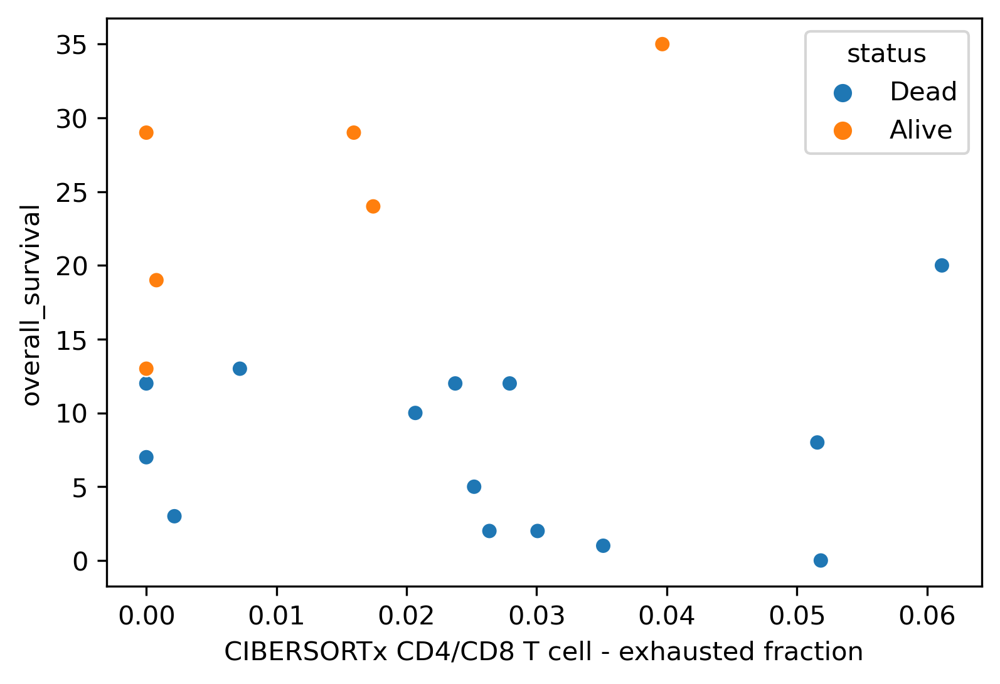

In [55]:
sns.scatterplot(data=df, x='CIBERSORTx CD4/CD8 T cell - exhausted fraction', y='overall_survival', hue='status')

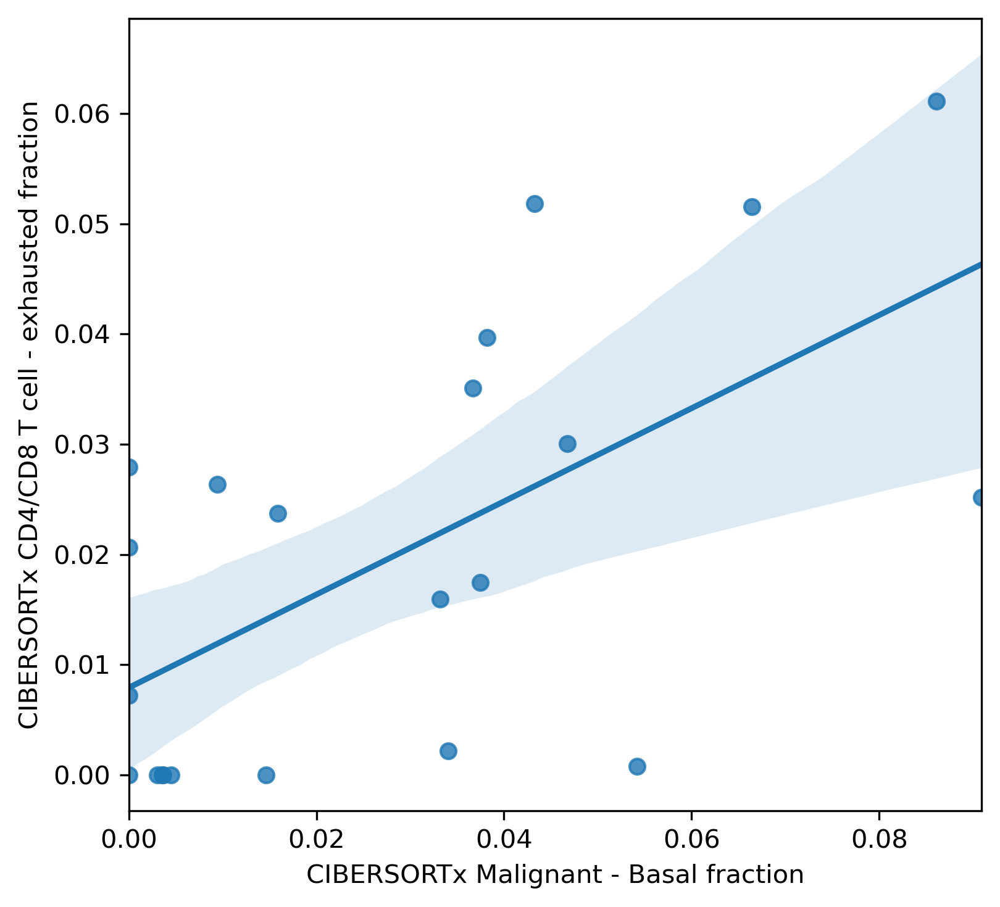

In [128]:
fig, ax = plt.subplots(figsize=(5.5,5))

sns.regplot(data=df, y='CIBERSORTx CD4/CD8 T cell - exhausted fraction', x='CIBERSORTx Malignant - Basal fraction')

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'pseudo_basal_vs_cd8_ex_fraction_regplot.pdf'))

In [138]:
scipy.stats.spearmanr(df['CIBERSORTx CD4/CD8 T cell - exhausted fraction'], df['CIBERSORTx Malignant - Basal fraction'])

SpearmanrResult(correlation=0.5796545038397601, pvalue=0.004692515632296807)

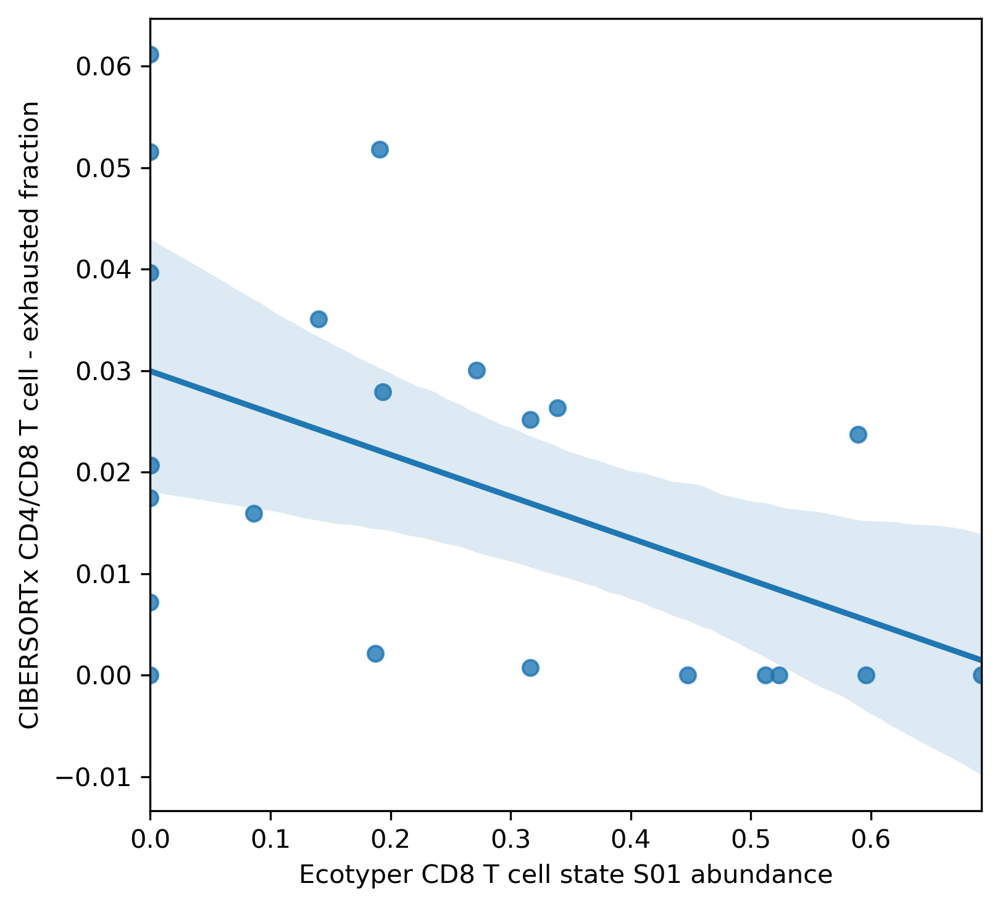

In [129]:
fig, ax = plt.subplots(figsize=(5.5,5))

sns.regplot(data=df, y='CIBERSORTx CD4/CD8 T cell - exhausted fraction', x='Ecotyper CD8 T cell state S01 abundance')

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'pseudo_s01_vs_cd8_ex_fraction_regplot.pdf'))

In [139]:
scipy.stats.spearmanr(df['CIBERSORTx CD4/CD8 T cell - exhausted fraction'], df['Ecotyper CD8 T cell state S01 abundance'])

SpearmanrResult(correlation=-0.5338161487553209, pvalue=0.010503523786813141)

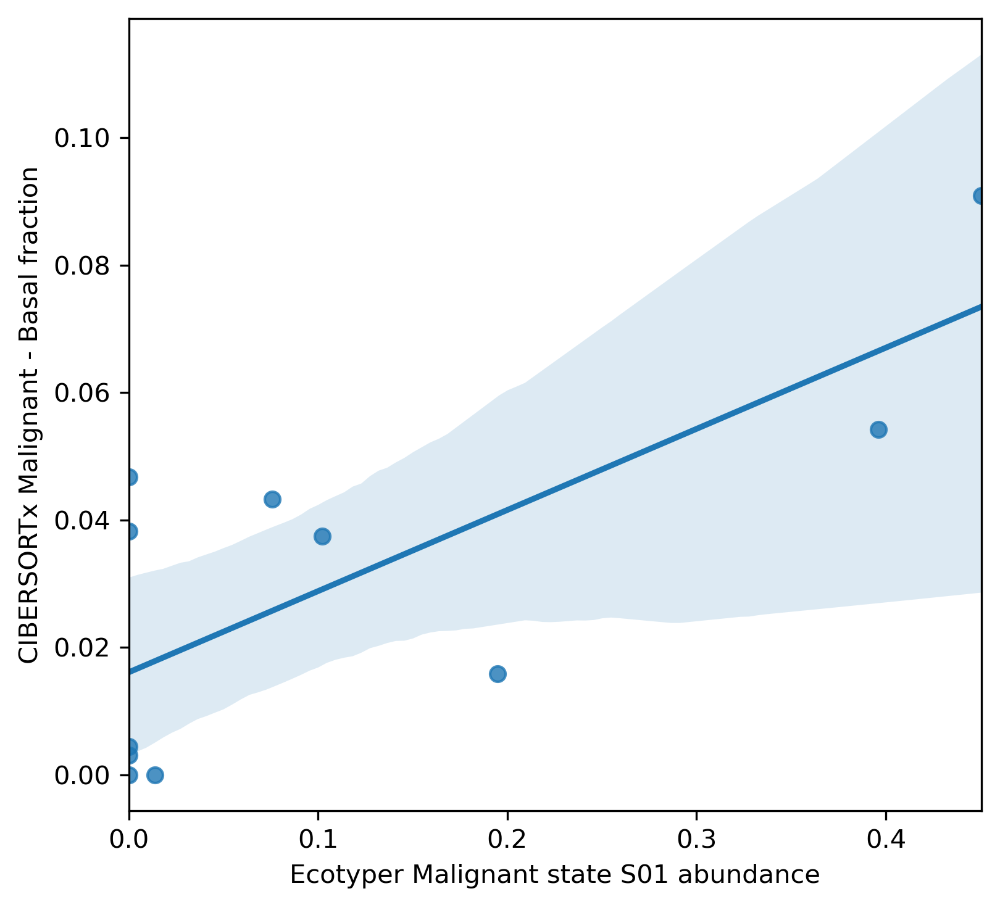

In [105]:
fig, ax = plt.subplots(figsize=(5.5,5))

sns.regplot(data=df[~pd.isnull(df['Ecotyper Malignant state'])], x='Ecotyper Malignant state S01 abundance', y='CIBERSORTx Malignant - Basal fraction')

plt.tight_layout()
# plt.savefig(os.path.join(save_dir, 'pseudo_s01_vs_cd8_ex_fraction_regplot.pdf'))

In [106]:
small = df[~pd.isnull(df['Ecotyper Malignant state'])]
small

,overall_survival,status,community,CIBERSORTx Acinar fraction,CIBERSORTx B cell fraction,CIBERSORTx CAF fraction,CIBERSORTx CD4 T cell fraction,CIBERSORTx CD8 T cell fraction,CIBERSORTx CD4/CD8 T cell - exhausted fraction,CIBERSORTx DC fraction,...,Ecotyper CD8 T cell state,Ecotyper CD8 T cell state S01 abundance,Ecotyper CD8 T cell state S02 abundance,Ecotyper CD8 T cell state S03 abundance,Ecotyper Malignant state,Ecotyper Malignant state S01 abundance,Ecotyper Malignant state S02 abundance,Ecotyper Malignant state S03 abundance,Ecotyper Malignant state S04 abundance,Ecotyper Malignant state S05 abundance
sample_id,,,,,,,,,,,,,,,,,,,,,
wu03,0.0,Dead,Classical Low,0.001629,0.000000,0.000000,0.021852,0.080348,0.051836,0.048720,...,S02,1.910391e-01,5.170655e-01,0.229364,S03,7.584739e-02,1.544481e-15,3.643826e-01,2.513002e-01,3.084698e-01
wu05,35.0,Alive,Classical Low,0.000308,0.000000,0.000000,0.033000,0.000000,0.039659,0.081814,...,NaN,4.924772e-15,4.924772e-15,0.080890,S04,9.565007e-07,2.776025e-01,2.430386e-01,3.310847e-01,3.262544e-15
wu07,5.0,Dead,Basal,0.000585,0.118269,0.015033,0.174981,0.035516,0.025192,0.082507,...,S02,3.161887e-01,5.234855e-01,0.149071,S01,4.505488e-01,2.277875e-15,1.720850e-01,1.447814e-08,1.573352e-01
wu18,12.0,Dead,Classical Low,0.010469,0.034863,0.022413,0.233834,0.068332,0.000000,0.152178,...,S01,5.121976e-01,2.930083e-02,0.088336,S03,5.573867e-15,2.056878e-01,2.145136e-01,8.457017e-03,1.765777e-01
wu22,10.0,Dead,ADEX,0.001326,0.000000,0.003837,0.095039,0.013157,0.020675,0.055565,...,S02,3.499807e-04,5.213880e-01,0.207558,S03,1.383285e-02,3.587866e-03,4.107857e-01,3.680950e-01,2.036986e-01
wu24,24.0,Alive,Classical High,0.000563,0.000000,0.006107,0.000000,0.000000,0.017438,0.002173,...,NaN,4.848571e-15,4.849489e-09,0.356648,S03,1.021192e-01,2.996532e-15,4.576408e-01,2.323452e-01,2.078949e-01
wu26,19.0,Alive,Classical Low,0.000152,0.046049,0.000545,0.258003,0.084699,0.000777,0.120568,...,S02,3.166016e-01,4.588432e-01,0.141613,S01,3.962386e-01,1.519201e-03,2.628295e-01,2.310015e-01,1.084112e-01
wu27,12.0,Dead,ADEX,0.052662,0.068949,0.002934,0.289706,0.081388,0.023743,0.084826,...,S01,5.895793e-01,2.948016e-01,0.022586,S05,1.949127e-01,3.234574e-10,4.133801e-15,4.133801e-15,5.622617e-01
wu28,12.0,Dead,ADEX,0.003828,0.006615,0.000337,0.144403,0.067632,0.027927,0.068279,...,S02,1.933455e-01,5.629023e-01,0.166962,S05,1.687602e-15,6.229307e-03,3.179689e-01,2.515133e-01,4.242885e-01


In [107]:
list(small.columns)

['overall_survival',
 'status',
 'community',
 'CIBERSORTx Acinar fraction',
 'CIBERSORTx B cell fraction',
 'CIBERSORTx CAF fraction',
 'CIBERSORTx CD4 T cell fraction',
 'CIBERSORTx CD8 T cell fraction',
 'CIBERSORTx CD4/CD8 T cell - exhausted fraction',
 'CIBERSORTx DC fraction',
 'CIBERSORTx Endothelial fraction',
 'CIBERSORTx Erythrocyte fraction',
 'CIBERSORTx Malignant - Classical Low fraction',
 'CIBERSORTx Malignant - Classical High fraction',
 'CIBERSORTx Malignant - Basal fraction',
 'CIBERSORTx Malignant - Mixed fraction',
 'CIBERSORTx Malignant - ADEX fraction',
 'CIBERSORTx Mast fraction',
 'CIBERSORTx Monocyte fraction',
 'CIBERSORTx NK fraction',
 'CIBERSORTx Plasma fraction',
 'CIBERSORTx Stellate fraction',
 'CIBERSORTx Treg fraction',
 'Ecotyper CD8 T cell state',
 'Ecotyper CD8 T cell state S01 abundance',
 'Ecotyper CD8 T cell state S02 abundance',
 'Ecotyper CD8 T cell state S03 abundance',
 'Ecotyper Malignant state',
 'Ecotyper Malignant state S01 abundance',
 '

In [108]:
import scipy

In [114]:
cm = [
    'CIBERSORTx Malignant - Basal fraction',
    'CIBERSORTx Malignant - Mixed fraction',
    'CIBERSORTx Malignant - Classical Low fraction',
    'CIBERSORTx Malignant - Classical High fraction',
    'CIBERSORTx Malignant - ADEX fraction'
]
cs = [
    'Ecotyper Malignant state S01 abundance',
    'Ecotyper Malignant state S02 abundance',
    'Ecotyper Malignant state S03 abundance',
    'Ecotyper Malignant state S04 abundance',
    'Ecotyper Malignant state S05 abundance']

data = []
for c1 in cm:
    for c2 in cs:
        f = df[[c1, c2, 'Ecotyper Malignant state']]
        corr, p = scipy.stats.spearmanr(f[c1], f[c2])
        data.append([c1, c2, corr, p])
stat_df = pd.DataFrame(data=data, columns=['CIBERSORTx', 'Ecotyper', 'corr', 'p-value'])

c = alt.Chart(stat_df).mark_rect().encode(
    x=alt.X('CIBERSORTx', sort=cm),
    y=alt.Y('Ecotyper', sort=cs),
    color=alt.Color('corr', scale=alt.Scale(scheme='purpleorange', domain=[.7, -.7]))
)
c


alt.Chart(...)

In [117]:
c = alt.Chart(stat_df).mark_rect().encode(
    x=alt.X('CIBERSORTx', sort=cm),
    y=alt.Y('Ecotyper', sort=cs),
    color=alt.Color('corr', scale=alt.Scale(scheme='purpleorange', domain=[.7, -.7]))
)
c

alt.Chart(...)

In [135]:
cm = [
    'CIBERSORTx Malignant - Basal fraction',
    'CIBERSORTx Malignant - Mixed fraction',
    'CIBERSORTx Malignant - Classical Low fraction',
    'CIBERSORTx Malignant - Classical High fraction',
    'CIBERSORTx Malignant - ADEX fraction'
]
cs = [
    'overall_survival']

data = []
for c1 in cm:
    for c2 in cs:
        f = df[[c1, c2, 'Ecotyper Malignant state']]
        corr, p = scipy.stats.spearmanr(f[c1], f[c2])
        data.append([c1, c2, corr, p, -np.log2(p)])
stat_df = pd.DataFrame(data=data, columns=['CIBERSORTx', 'Survival', 'corr', 'p-value', '-log2(p)'])

c = alt.Chart(stat_df).mark_rect().encode(
    y=alt.Y('CIBERSORTx', sort=cm),
    x=alt.X('Survival', sort=cs),
    color=alt.Color('corr', scale=alt.Scale(scheme='redblue', domain=[.4, -.4]))
)
c


alt.Chart(...)

In [136]:

c = alt.Chart(stat_df).mark_rect().encode(
    y=alt.Y('CIBERSORTx', sort=cm),
    x=alt.X('Survival', sort=cs),
    color=alt.Color('-log2(p)', scale=alt.Scale(scheme='Viridis'))
)
c


alt.Chart(...)

In [123]:
cm = [
    'Ecotyper Malignant state S01 abundance',
    'Ecotyper Malignant state S02 abundance',
    'Ecotyper Malignant state S03 abundance',
    'Ecotyper Malignant state S04 abundance',
    'Ecotyper Malignant state S05 abundance'
]
cs = [
    'overall_survival']

data = []
for c1 in cm:
    for c2 in cs:
        f = df[[c1, c2, 'Ecotyper Malignant state']]
        corr, p = scipy.stats.spearmanr(f[c1], f[c2])
        data.append([c1, c2, corr, p])
stat_df = pd.DataFrame(data=data, columns=['CIBERSORTx', 'Survival', 'corr', 'p-value'])

c = alt.Chart(stat_df).mark_rect().encode(
    x=alt.X('CIBERSORTx', sort=cm),
    y=alt.Y('Survival', sort=cs),
    color=alt.Color('corr', scale=alt.Scale(scheme='redblue'))
)
c


alt.Chart(...)

<AxesSubplot:xlabel='Ecotyper Malignant state', ylabel='overall_survival'>

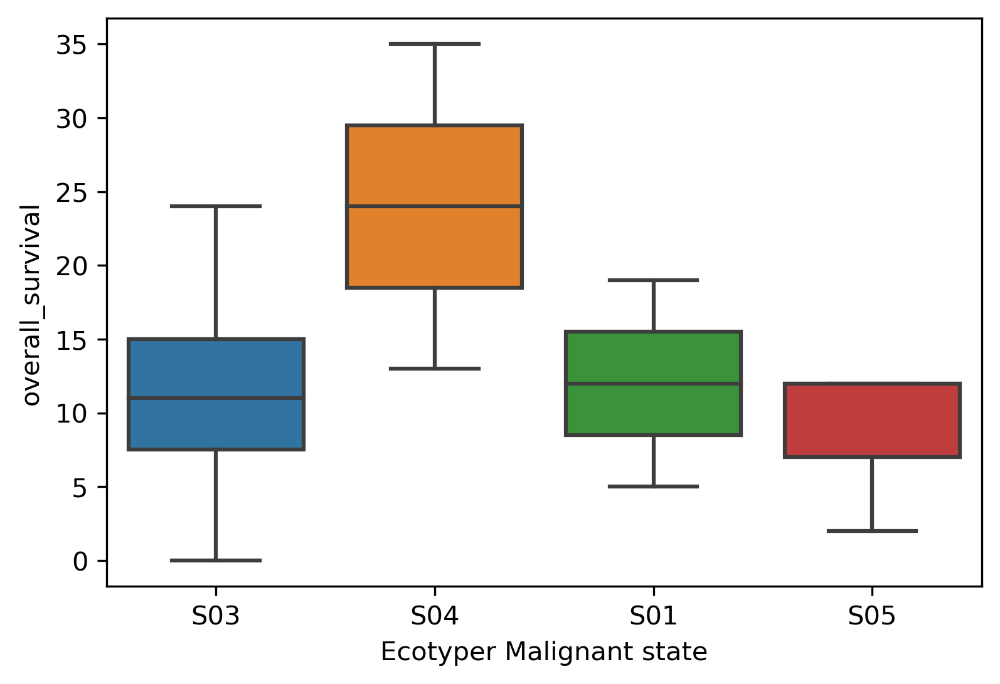

In [102]:
sns.boxplot(data=df, x='Ecotyper Malignant state', y='overall_survival')

<AxesSubplot:xlabel='community', ylabel='overall_survival'>

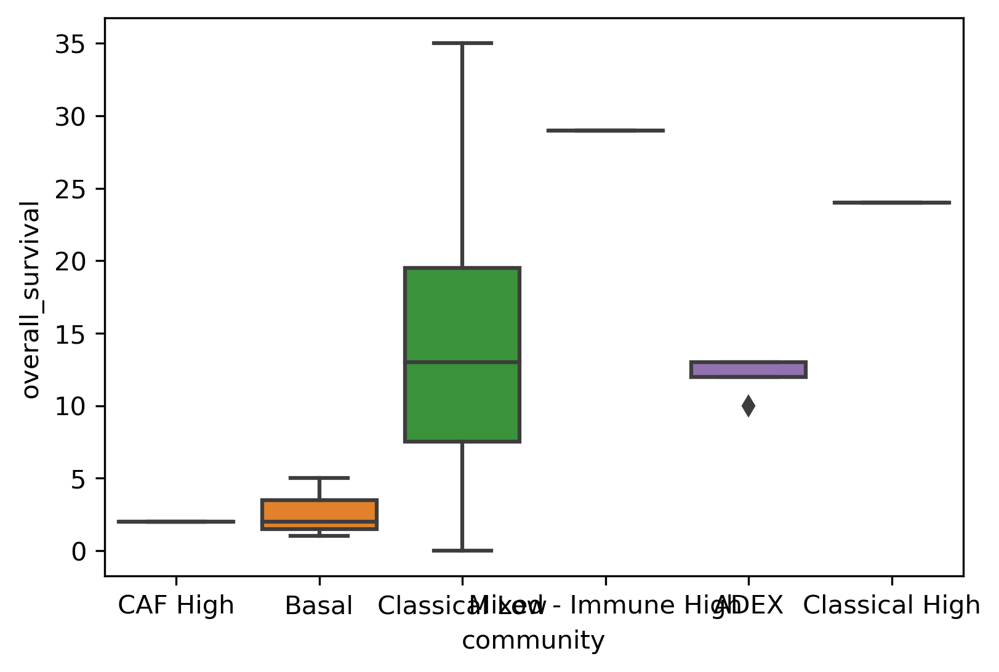

In [103]:
sns.boxplot(data=df, x='community', y='overall_survival')

In [77]:
list(df.columns)

['overall_survival',
 'status',
 'community',
 'CIBERSORTx Acinar fraction',
 'CIBERSORTx B cell fraction',
 'CIBERSORTx CAF fraction',
 'CIBERSORTx CD4 T cell fraction',
 'CIBERSORTx CD8 T cell fraction',
 'CIBERSORTx CD4/CD8 T cell - exhausted fraction',
 'CIBERSORTx DC fraction',
 'CIBERSORTx Endothelial fraction',
 'CIBERSORTx Erythrocyte fraction',
 'CIBERSORTx Malignant - Classical Low fraction',
 'CIBERSORTx Malignant - Classical High fraction',
 'CIBERSORTx Malignant - Basal fraction',
 'CIBERSORTx Malignant - Mixed fraction',
 'CIBERSORTx Malignant - ADEX fraction',
 'CIBERSORTx Mast fraction',
 'CIBERSORTx Monocyte fraction',
 'CIBERSORTx NK fraction',
 'CIBERSORTx Plasma fraction',
 'CIBERSORTx Stellate fraction',
 'CIBERSORTx Treg fraction',
 'Ecotyper CD8 T cell state',
 'Ecotyper CD8 T cell state S01 abundance',
 'Ecotyper CD8 T cell state S02 abundance',
 'Ecotyper CD8 T cell state S03 abundance',
 'Ecotyper Malignant state',
 'Ecotyper Malignant state S01 abundance',
 '

In [94]:
section_map = {
    'survival_cat': ['status'],
    'survival_cont': ['overall_survival'],
    'community classification': ['community'],
    'cibersortx fractions': [
        'CIBERSORTx CD4/CD8 T cell - exhausted fraction',
        'CIBERSORTx Malignant - Basal fraction',
        'CIBERSORTx Malignant - Mixed fraction',
        'CIBERSORTx Malignant - ADEX fraction',
        'CIBERSORTx Malignant - Classical Low fraction',
        'CIBERSORTx Malignant - Classical High fraction',
    ],
    'ecotyper classification': ['Ecotyper CD8 T cell state', 'Ecotyper Malignant state'],
    'ecotyper cd8': [c for c in df.columns if 'Ecotyper CD8' in c and 'abundance' in c],
    'ecotyper malignant': [c for c in df.columns if 'Ecotyper Malignant' in c and 'abundance' in c],
}

In [95]:
temp = df.copy()
temp['id'] = df.index.to_list()
temp = temp.melt(id_vars='id')
temp

,id,variable,value
0,wu01,overall_survival,2.000000
1,wu02,overall_survival,1.000000
2,wu03,overall_survival,0.000000
3,wu04,overall_survival,20.000000
4,wu05,overall_survival,35.000000
...,...,...,...
721,wu28,Ecotyper Malignant state S05 abundance,0.424289
722,wu29,Ecotyper Malignant state S05 abundance,0.000380
723,wu30,Ecotyper Malignant state S05 abundance,0.411324
724,wu31,Ecotyper Malignant state S05 abundance,0.000000


In [96]:
order = df.sort_values('overall_survival').index.to_list()

In [97]:
charts = []
for k, ls in section_map.items():
    c = alt.Chart(temp[[True if v in ls else False
                        for v in temp['variable']]]).mark_rect().encode(
        x=alt.X('variable'),
        y=alt.Y('id', sort=order),
        color=alt.Color('value')
    )
    charts.append(c)

combined = alt.hconcat(*charts)
combined

alt.HConcatChart(...)

In [119]:
source = pd.DataFrame(data=integrated.obsm['X_umap'].copy(), columns=['UMAP1', 'UMAP2'])
source['cluster'] = integrated.obs['cluster'].to_list()
source['dataset'] = integrated.obs['dataset'].to_list()
source

,UMAP1,UMAP2,cluster,dataset
0,-6.043151,8.002343,Basal,tcga
1,3.072226,4.998046,Mixed 2,tcga
2,2.222818,13.597439,Mixed 1,tcga
3,6.956868,19.277275,Classical High,tcga
4,3.923736,22.996042,Classical High,tcga
...,...,...,...,...
386,1.842922,11.459165,Classical High,kirby
387,7.571297,4.140377,ADEX,kirby
388,6.435657,16.788155,Classical High,kirby
389,5.721799,9.511937,Mixed 1,kirby


In [127]:
chart = alt.Chart(source).mark_point().encode(
    x=alt.X('UMAP1').configure_axis(grid=False),
    y=alt.Y('UMAP2').configure_axis(grid=False),
    color=alt.Color('dataset'),
#     grid=False
)
chart

AttributeError: 'X' object has no attribute 'configure_axis'

In [ ]:
chart.config

In [163]:
sorted(set(adata.obs['sample_id']))

['100070',
 '1555-tumor',
 '85948',
 '87235',
 '87784',
 '90209_CMP',
 '91412',
 '91610',
 '91706',
 '94930',
 '95092',
 '95373',
 '96460',
 '97727',
 'COMP_0158_P',
 'G9903',
 'H_ZY-1105-07',
 'H_ZY-1160-06',
 'H_ZY-1174-06',
 'P01',
 'P02',
 'P03',
 'P04',
 'P05',
 'P06',
 'P07',
 'P08',
 'P09',
 'P10',
 'T1',
 'T10',
 'T11',
 'T12',
 'T13',
 'T14',
 'T15',
 'T16',
 'T17',
 'T18',
 'T19',
 'T2',
 'T20',
 'T21',
 'T22',
 'T23',
 'T24',
 'T3',
 'T4',
 'T5',
 'T6',
 'T7',
 'T8',
 'T9',
 'TWCE-HT055P-S1PAG',
 'TWCE-HT081P1-XB1',
 'wu01',
 'wu02',
 'wu03',
 'wu04',
 'wu05',
 'wu07',
 'wu09',
 'wu14',
 'wu15',
 'wu16',
 'wu18',
 'wu22',
 'wu23',
 'wu24',
 'wu25',
 'wu26',
 'wu27',
 'wu28',
 'wu29',
 'wu30',
 'wu31',
 'wu32']

In [105]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,nCount_SCT,nFeature_SCT,CELL,CONDITION,Patient,Type,Cell_type,...,integrated_snn_res.0.5,active.ident,cell_type,dataset,sample_id,cell_type_level_2,cell_type_level_3,tumor_original_seurat,malignant_exclude,final_cell_types
wu01_AAACCTGCACATAACC-1,wu01,11822.0,3295,3377.0,1314,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,14,Monocyte,Monocyte,In-house: EUS-FNB,wu01,Monocyte,Monocyte,Monocyte,False,Monocyte
wu01_AAACCTGCACCACGTG-1,wu01,469.0,293,2235.0,450,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,14,Monocyte,Monocyte,In-house: EUS-FNB,wu01,Monocyte,Monocyte,Monocyte,False,Monocyte
wu01_AAACCTGTCTAACTTC-1,wu01,482.0,243,2436.0,400,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,0,Malignant,Malignant,In-house: EUS-FNB,wu01,Malignant_0,Malignant_0,Malignant_0,False,Malignant - Classical Low
wu01_AAACGGGCAAGGCTCC-1,wu01,1516.0,717,2944.0,717,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,2,Monocyte,Monocyte,In-house: EUS-FNB,wu01,Monocyte,Monocyte,Monocyte,False,Monocyte
wu01_AAACGGGTCATTCACT-1,wu01,876.0,453,2491.0,524,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,14,Monocyte,Monocyte,In-house: EUS-FNB,wu01,Monocyte,Monocyte,Monocyte,False,Monocyte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
G9903_filtered_gene_bc_matrices_h5.h5_TTTGGTTTCTACCAGA-1,G9903,8237.0,2326,9379.0,2326,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,1,CAF,CAF,Chan-Seng-Yue,G9903,CAF,CAF,CAF,False,CAF
G9903_filtered_gene_bc_matrices_h5.h5_TTTGTCAAGTTGTCGT-1,G9903,6484.0,1875,9150.0,1886,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,1,CAF,CAF,Chan-Seng-Yue,G9903,CAF,CAF,CAF,False,CAF
G9903_filtered_gene_bc_matrices_h5.h5_TTTGTCACAACTTGAC-1,G9903,8367.0,2286,9400.0,2286,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,1,CAF,CAF,Chan-Seng-Yue,G9903,CAF,CAF,CAF,False,CAF
G9903_filtered_gene_bc_matrices_h5.h5_TTTGTCATCCGAACGC-1,G9903,20314.0,3975,10684.0,3464,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,0,Malignant,Malignant,Chan-Seng-Yue,G9903,Malignant_0,Malignant_0,Malignant_0,False,Malignant - Classical Low


In [69]:
for d in sorted(set(adata.obs['dataset'])):
    print(d, set([x.split('_')[0] for x in adata[adata.obs['dataset']==d].obs.index]))

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Chan-Seng-Yue {'87235', '87784', '91412', '100070', '97727', '91610', '91706', 'COMP', '94930', '95092', '95373', '85948', '90209', 'G9903', '96460'}
In-house: EUS-FNB {'wu04', 'wu23', 'wu15', 'wu25', 'wu30', 'wu07', 'wu24', 'wu31', 'wu22', 'wu03', 'wu01', 'wu32', 'wu18', 'wu02', 'wu28', 'wu05', 'wu27', 'wu16', 'wu29', 'wu14', 'wu09', 'wu26'}
In-house: Surgical {'TWCE-HT081P1-XB1', 'TWCE-HT055P-S1PAG', '1555-tumor', 'H'}
Lin {'P09', 'P03', 'P06', 'P05', 'P10', 'P01', 'P02', 'P04', 'P07', 'P08'}
Peng {'T2', 'T21', 'T22', 'T19', 'T4', 'T1', 'T12', 'T17', 'T14', 'T20', 'T10', 'T5', 'T24', 'T8', 'T23', 'T11', 'T16', 'T3', 'T15', 'T9', 'T13', 'T18', 'T6', 'T7'}


In [72]:
for d in sorted(set(adata.obs['dataset'])):
    print(d, len(set(x for x in adata[adata.obs['dataset']==d].obs['sample_id'])))

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Chan-Seng-Yue 15
In-house: EUS-FNB 22
In-house: Surgical 6
Lin 10
Peng 24


In [ ]:
set([x.split('_')[0] for x in adata[adata.obs['dataset']==d].obs.index])

In [73]:
adata.write_h5ad('../backups/final_adata.h5ad')

In [114]:
tumor[tumor.obs['dataset']=='Lin'].obs

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,orig.ident,nCount_RNA,nFeature_RNA,nCount_SCT,nFeature_SCT,CELL,CONDITION,Patient,Type,Cell_type,...,integrated_snn_res.1,integrated_snn_res.0.5,integrated_snn_res.0.1,active.ident,cell_type,bailey_score,moffit_score,collison_score,cytotrace,dataset
P01_AAACATACTCGTTT-1,P01,2456.0,957,6035.0,1087,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,24,15,4,P01,Malignant_3,3.295837,1.609438,3.295837,NaN,Lin
P01_AAAGCAGAACGTTG-1,P01,7132.0,1906,7017.0,1904,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,10,20,2,P01,Malignant_2,5.192957,0.000000,6.040255,NaN,Lin
P01_AAAGCAGACTGAGT-1,P01,1655.0,621,6037.0,972,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,10,20,2,P01,Malignant_2,4.969813,3.496508,5.241747,NaN,Lin
P01_AAAGGCCTGCTCCT-1,P01,14262.0,2761,7535.0,2377,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,10,20,2,P01,Malignant_2,7.215240,2.079442,6.684612,NaN,Lin
P01_AAATACTGTGGATC-1,P01,13821.0,2532,7462.0,2168,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,10,20,2,P01,Malignant_2,9.159468,1.386294,5.375278,NaN,Lin
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P10_TTTGTCAGTTAGTGGG-1,P10,7554.0,2129,7161.0,2129,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,25,0,0,P10,Malignant_0,3.465736,1.098612,1.098612,NaN,Lin
P10_TTTGTCAGTTGATTGC-1,P10,5293.0,2061,6270.0,2061,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,16,0,1,P10,Malignant_1,0.693147,0.000000,0.000000,NaN,Lin
P10_TTTGTCATCACTGGGC-1,P10,25122.0,4499,6719.0,2005,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,26,0,0,P10,Malignant_0,1.791759,2.484907,0.693147,NaN,Lin
P10_TTTGTCATCAGAGACG-1,P10,6162.0,1805,6669.0,1805,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,14,3,1,P10,Malignant_1,1.386294,0.000000,0.000000,NaN,Lin


In [117]:
cytotrace[[True if 'COMP_0158_P' in x else False for x in cytotrace.index]]

,cytotrace
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_ACGATACTCTGGCGTG-1,0.402985
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CAAGAAACAGCCTTTC-1,0.723383
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CCTTACGGTCAACTGT-1,0.766169
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CGTCCATTCATAAAGG-1,0.881592
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CTCGGGAGTTCAGTAC-1,0.792040
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_GGACGTCCACGCCAGT-1,0.805970
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_TTCCCAGTCAACACTG-1,0.863682


In [120]:
tumor[[True if 'COMP_0158_P' in x else False for x in tumor.obs.index]].obs

/diskmnt/Projects/Users/estorrs/miniconda3/envs/seurat_v4/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,orig.ident,nCount_RNA,nFeature_RNA,nCount_SCT,nFeature_SCT,CELL,CONDITION,Patient,Type,Cell_type,...,integrated_snn_res.1,integrated_snn_res.0.5,integrated_snn_res.0.1,active.ident,cell_type,bailey_score,moffit_score,collison_score,cytotrace,dataset
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_ACGATACTCTGGCGTG-1,COMP_0158_P,15916.0,3906,10806.0,3789,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,2.772589,0.000000,2.484907,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CAAGAAACAGCCTTTC-1,COMP_0158_P,1797.0,845,8741.0,1590,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,3.871201,0.000000,1.386294,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CCTTACGGTCAACTGT-1,COMP_0158_P,1598.0,830,8435.0,1659,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,4.158883,0.000000,0.000000,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CGTCCATTCATAAAGG-1,COMP_0158_P,1269.0,768,8093.0,1715,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,28,9,3,COMP_0158_P,Malignant_2,3.465736,1.386294,0.000000,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_CTCGGGAGTTCAGTAC-1,COMP_0158_P,1706.0,894,8338.0,1670,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,1.386294,0.000000,1.386294,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_GGACGTCCACGCCAGT-1,COMP_0158_P,1652.0,891,8292.0,1683,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,1.386294,0.000000,0.000000,NaN,Chan-Seng-Yue
COMP_0158_P_filtered_gene_bc_matrices_h5.h5_TTCCCAGTCAACACTG-1,COMP_0158_P,2213.0,1044,8461.0,1662,NA_character_,-2147483648,NA_character_,-2147483648,NA_character_,...,5,15,4,COMP_0158_P,Malignant_3,0.693147,0.000000,0.000000,NaN,Chan-Seng-Yue


In [118]:
# def alter_id(x, dataset):
#     if dataset=='Chan-Seng-Yue':
#         return x.replace('h5.', 'h5')
    

cytotrace = pd.read_csv('../data/cytotrace/05242021/results.txt', sep='\t')
cytotrace.index = [re.sub(r'\.1', r'-1', x)  for x in cytotrace.index]
cytotrace.columns = ['cytotrace']
cytotrace

,cytotrace
X100070_filtered_gene_bc_matrices_h5.h5_AAACCTGAGCGTAATA-1,0.761194
X100070_filtered_gene_bc_matrices_h5.h5_AAACCTGCAATCCGAT-1,0.717413
X100070_filtered_gene_bc_matrices_h5.h5_AAACCTGCACTAGTAC-1,0.944279
X100070_filtered_gene_bc_matrices_h5.h5_AAACGGGAGACTGGGT-1,0.744279
X100070_filtered_gene_bc_matrices_h5.h5_AAACGGGAGGGTCGAT-1,0.813930
...,...
TWCE.HT081P1.XB1_TTTCCTCTCGTGTTCC-1,0.232836
TWCE.HT081P1.XB1_TTTGACTCAACTCGTA-1,0.154229
TWCE.HT081P1.XB1_TTTGACTTCGGCTTGG-1,0.334328
TWCE.HT081P1.XB1_TTTGGAGGTTGTCATG-1,0.282587


In [121]:
tumor.obs['cytotrace'] = [cytotrace.loc[x, 'cytotrace'] if x in cytotrace.index else np.nan
                          for x in tumor.obs.index]
tumor.obs['dataset'] = [adata.obs.loc[x, 'dataset'] for x in tumor.obs.index]

... storing 'dataset' as categorical


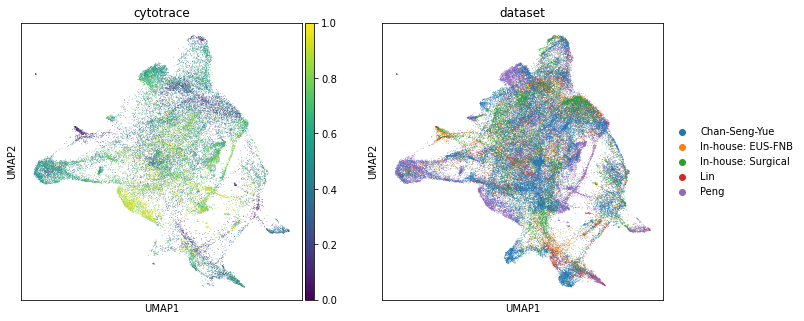

In [122]:
sc.pl.umap(tumor, color=['cytotrace', 'dataset'])

<AxesSubplot:xlabel='dataset', ylabel='cytotrace'>

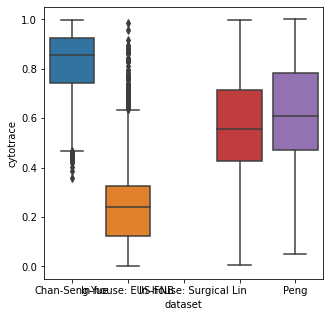

In [123]:
sns.boxplot(data=tumor.obs, x='dataset', y='cytotrace')